## Setup, Loading Data and CDFs

In [1]:
DATA_NAME = 'spaceNet-full' 
TRANSFORM = 'gabor'
CHANNEL = 'green'
PARAM_CSV = "gabor_new.csv"

In [2]:
path_list = DATA_NAME.split("-") + TRANSFORM.split("-")
if CHANNEL:
    path_list.append(CHANNEL)
print(f"Name the notebook:\n{'_'.join(path_list[::-1])}.ipynb")
FULL_DATA_NAME='-'.join(path_list)

Name the notebook:
green_gabor_full_spaceNet.ipynb


In [3]:
import git
from pathlib import Path
import os
import pandas as pd
import numpy as np

ROOT_DIR = Path(git.Repo('.', search_parent_directories=True).working_tree_dir)
CWD = os.path.join(ROOT_DIR, "results", "case-studies", *path_list)

assert CWD == os.getcwd()
Path(os.path.join(CWD, "CSVs")).mkdir(exist_ok=True)
Path(os.path.join(CWD, "plots")).mkdir(exist_ok=True)
Path(os.path.join(CWD, "cache")).mkdir(exist_ok=True)

GROUP = 'layer' if TRANSFORM.split("-")[0] == 'wavelet' else ('band' if TRANSFORM.split("-")[0] == 'fourier' else 'filter_idx')
RERUN = False
SKIP_OPTIMIZE_STEP = False
CWD

'/Users/brandonmarks/Desktop/hierarchical-bayesian-model-validation/results/case-studies/spaceNet/full/gabor/green'

In [4]:
os.chdir(os.path.join(ROOT_DIR, "utilities"))
from testing import * # If MATLAB is not installed, open utilities and set to False
from plotting import *
from learned import *
os.chdir(CWD)
np.random.seed(0)

In [5]:
group_data_map = pd.read_pickle(os.path.join(ROOT_DIR, "transformed-data", f'{FULL_DATA_NAME}.pickle'))
group_total_samples = pd.read_pickle(os.path.join(ROOT_DIR, "transformed-data", f'{FULL_DATA_NAME}-size.pickle'))

# treat all as nonskewed for gabor grouped over frequency
nonskewed_filter_idxs = list(group_data_map.keys())

df = pd.read_csv(os.path.join(ROOT_DIR, "gabor", PARAM_CSV), index_col="index")
df = df.sort_index()

filter_group_map = (df.loc[:, ["wave_number", "aspect_ratio", "frequency"]]
                      .apply(tuple, axis=1)
                      .to_dict())

filter_group_map

{0: (2.0, 0.5, 0.044),
 1: (2.0, 0.5, 0.065),
 2: (2.0, 0.5, 0.096),
 3: (2.0, 0.5, 0.141),
 4: (2.0, 0.5, 0.208),
 5: (2.0, 0.5, 0.306),
 6: (2.0, 0.5, 0.45),
 7: (2.0, 1.0, 0.044),
 8: (2.0, 1.0, 0.065),
 9: (2.0, 1.0, 0.096),
 10: (2.0, 1.0, 0.141),
 11: (2.0, 1.0, 0.208),
 12: (2.0, 1.0, 0.306),
 13: (2.0, 1.0, 0.45),
 14: (3.0, 0.5, 0.044),
 15: (3.0, 0.5, 0.065),
 16: (3.0, 0.5, 0.096),
 17: (3.0, 0.5, 0.141),
 18: (3.0, 0.5, 0.208),
 19: (3.0, 0.5, 0.306),
 20: (3.0, 0.5, 0.45),
 21: (3.0, 1.0, 0.044),
 22: (3.0, 1.0, 0.065),
 23: (3.0, 1.0, 0.096),
 24: (3.0, 1.0, 0.141),
 25: (3.0, 1.0, 0.208),
 26: (3.0, 1.0, 0.306),
 27: (3.0, 1.0, 0.45),
 28: (4.0, 0.5, 0.044),
 29: (4.0, 0.5, 0.065),
 30: (4.0, 0.5, 0.096),
 31: (4.0, 0.5, 0.141),
 32: (4.0, 0.5, 0.208),
 33: (4.0, 0.5, 0.306),
 34: (4.0, 0.5, 0.45),
 35: (4.0, 1.0, 0.044),
 36: (4.0, 1.0, 0.065),
 37: (4.0, 1.0, 0.096),
 38: (4.0, 1.0, 0.141),
 39: (4.0, 1.0, 0.208),
 40: (4.0, 1.0, 0.306),
 41: (4.0, 1.0, 0.45)}

In [6]:
if 'fourier' in TRANSFORM:
    GROUPS = np.arange(2, sorted(group_data_map)[-1] + 1)[::3]
elif 'wavelet' in TRANSFORM:
    GROUPS = np.arange(2, sorted(group_data_map)[-1] + 1)
elif 'learned' in TRANSFORM: 
    GROUPS = nonskewed_filter_idxs # can set to filter_group_map.keys() to include all prepared filters
elif 'gabor' in TRANSFORM: 
    GROUPS = nonskewed_filter_idxs # can set to filter_group_map.keys() to include all prepared filters

cdfs_dir = os.path.join(ROOT_DIR, "results", "CDFs")
cdfs_list = sorted([os.path.join(cdfs_dir, i) for i in os.listdir(cdfs_dir)])
all_cdfs = combine_pickles(cdfs_list[0])
for cdf_dir in cdfs_list[:6]: # TODO For quick testing purposes. Currently excluding 20000 CDFs. Use cdfs_list[5:6] to access CDFs/_test
    all_cdfs = all_cdfs | combine_pickles(cdf_dir)
    
# group_data_map = {g : group_data_map[g][::100] for g in GROUPS} # TODO For quick testing purposes
group_total_samples

{0: 160000000,
 1: 160000000,
 2: 160000000,
 3: 160000000,
 4: 160000000,
 5: 160000000,
 6: 160000000,
 7: 160000000,
 8: 160000000,
 9: 160000000,
 10: 160000000,
 11: 160000000,
 12: 160000000,
 13: 160000000,
 14: 160000000,
 15: 160000000,
 16: 160000000,
 17: 160000000,
 18: 160000000,
 19: 160000000,
 20: 160000000,
 21: 160000000,
 22: 160000000,
 23: 160000000,
 24: 160000000,
 25: 160000000,
 26: 160000000,
 27: 160000000,
 28: 160000000,
 29: 160000000,
 30: 160000000,
 31: 160000000,
 32: 160000000,
 33: 160000000,
 34: 160000000,
 35: 160000000,
 36: 160000000,
 37: 160000000,
 38: 160000000,
 39: 160000000,
 40: 160000000,
 41: 160000000}

Running 12760 CDFs


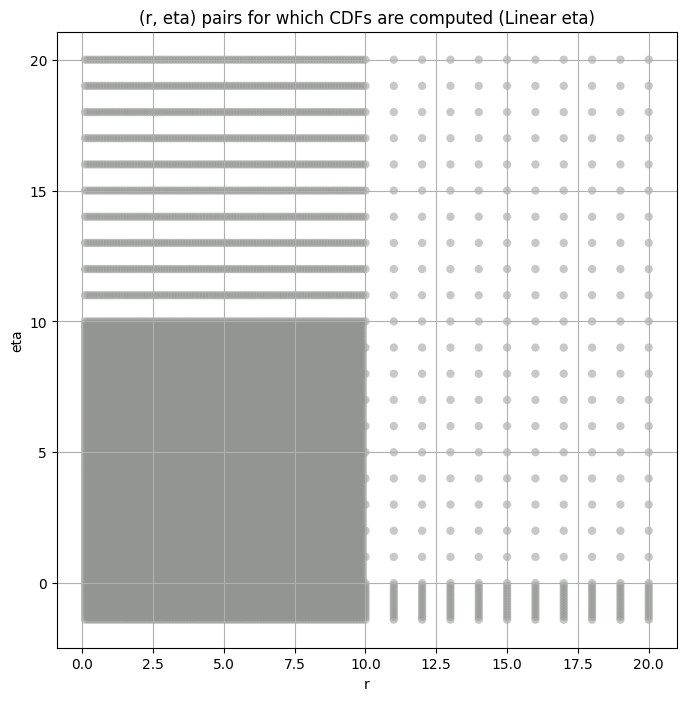

,"(r,eta),cdf",r,eta,cdf,variance,kurtosis
0,"((0.1, -1.4), <scipy.interpolate._fitpack2.Int...",0.1,-1.4,<scipy.interpolate._fitpack2.InterpolatedUniva...,3.628800e+06,554265.000000
1,"((0.1, -1.3), <scipy.interpolate._fitpack2.Int...",0.1,-1.3,<scipy.interpolate._fitpack2.InterpolatedUniva...,3.991680e+07,96192.272727
2,"((0.1, -1.2), <scipy.interpolate._fitpack2.Int...",0.1,-1.2,<scipy.interpolate._fitpack2.InterpolatedUniva...,2.395008e+08,29390.000000
3,"((0.1, -1.1), <scipy.interpolate._fitpack2.Int...",0.1,-1.1,<scipy.interpolate._fitpack2.InterpolatedUniva...,1.037837e+09,11997.692308
4,"((0.1, -1.0), <scipy.interpolate._fitpack2.Int...",0.1,-1.0,<scipy.interpolate._fitpack2.InterpolatedUniva...,3.632429e+09,5874.890110


In [7]:
warnings.filterwarnings('ignore', category=RuntimeWarning)

all_cdfs_df = create_kurt_var_ksstat_df(all_cdfs)
fine_cdfs_df = all_cdfs_df.copy()
all_cdfs_df = all_cdfs_df[(np.round(all_cdfs_df['r'], 1) == all_cdfs_df['r']) & (np.round(all_cdfs_df['eta'], 1) == all_cdfs_df['eta'])]
all_cdfs_df = all_cdfs_df.reset_index(drop=True)
all_cdfs = {x[0] : x[1] for x in all_cdfs_df["(r,eta),cdf"]}
                                             
var_values_dict = dict()
kurt_values_dict = dict()
master_df = pd.DataFrame(columns=[GROUP]).set_index(GROUP)
temp_cdf = all_cdfs_df
print(f"Running {all_cdfs_df.shape[0]} CDFs")
create_scatter_plot(all_cdfs_df);
all_cdfs_df.head()

## Bootstrapping the Variance and Kurtosis

In [8]:
n_bootstrap = int(1e3) # TODO For quick testing purposes
bootstrap_size = int(1e3) # TODO For quick testing purposes
ci = 0.99

In [9]:
bootstrap_path = Path(os.path.join(CWD, "CSVs", f'initial_grid_bootstrap{n_bootstrap}_{bootstrap_size}_ci{ci}.csv'))
master_df_var_kurt_path = Path(os.path.join(CWD, "CSVs", f'initial_grid_bootstrap{n_bootstrap}_{bootstrap_size}_ci{ci}.csv'))

if True or not master_df_var_kurt_path.exists(): # TODO For quick testing purposes
    for group in GROUPS:
        print(f'{GROUP.capitalize()} {group}: {str(filter_group_map[group])}')
        obs_var, var_lower, var_upper, var_values_dict[group] = bootstrap_metric(group_data_map[group], 
                                                                                n_bootstrap=n_bootstrap, 
                                                                                bootstrap_size=min(group_data_map[group].size, bootstrap_size), 
                                                                                metric= np.var, 
                                                                                ci=ci)
        obs_kurt, kurt_lower, kurt_upper, kurt_values_dict[group] = bootstrap_metric(group_data_map[group], 
                                                                                    n_bootstrap=n_bootstrap, 
                                                                                    bootstrap_size=min(group_data_map[group].size, bootstrap_size), 
                                                                                    metric= stats.kurtosis, ci=ci)  
        master_df.loc[group, 'obs_var'], master_df.loc[group, 'var_lower'], master_df.loc[group, 'var_upper'] = obs_var, var_lower, var_upper
        master_df.loc[group, 'obs_kurt'], master_df.loc[group, 'kurt_lower'], master_df.loc[group, 'kurt_upper'] = obs_kurt, kurt_lower, kurt_upper
        master_df.loc[group, 'total_samples'] = group_total_samples[group]
        master_df.loc[group, 'filter_group'] = str(filter_group_map[group])

    master_df.to_csv(os.path.join(CWD, "CSVs", f'initial_grid_bootstrap{n_bootstrap}_{bootstrap_size}_ci{ci}.csv'))

master_df = pd.read_csv(master_df_var_kurt_path, index_col=GROUP)
var_kurt_df = pd.read_csv(bootstrap_path, index_col=GROUP)
master_df

Filter_idx 0: (2.0, 0.5, 0.044)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 1: (2.0, 0.5, 0.065)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 2: (2.0, 0.5, 0.096)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 3: (2.0, 0.5, 0.141)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 4: (2.0, 0.5, 0.208)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 5: (2.0, 0.5, 0.306)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 6: (2.0, 0.5, 0.45)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 7: (2.0, 1.0, 0.044)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 8: (2.0, 1.0, 0.065)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 9: (2.0, 1.0, 0.096)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 10: (2.0, 1.0, 0.141)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 11: (2.0, 1.0, 0.208)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 12: (2.0, 1.0, 0.306)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 13: (2.0, 1.0, 0.45)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 14: (3.0, 0.5, 0.044)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 15: (3.0, 0.5, 0.065)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 16: (3.0, 0.5, 0.096)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 17: (3.0, 0.5, 0.141)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 18: (3.0, 0.5, 0.208)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 19: (3.0, 0.5, 0.306)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 20: (3.0, 0.5, 0.45)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 21: (3.0, 1.0, 0.044)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 22: (3.0, 1.0, 0.065)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 23: (3.0, 1.0, 0.096)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 24: (3.0, 1.0, 0.141)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 25: (3.0, 1.0, 0.208)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 26: (3.0, 1.0, 0.306)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 27: (3.0, 1.0, 0.45)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 28: (4.0, 0.5, 0.044)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 29: (4.0, 0.5, 0.065)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 30: (4.0, 0.5, 0.096)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 31: (4.0, 0.5, 0.141)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 32: (4.0, 0.5, 0.208)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 33: (4.0, 0.5, 0.306)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 34: (4.0, 0.5, 0.45)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 35: (4.0, 1.0, 0.044)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 36: (4.0, 1.0, 0.065)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 37: (4.0, 1.0, 0.096)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 38: (4.0, 1.0, 0.141)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 39: (4.0, 1.0, 0.208)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 40: (4.0, 1.0, 0.306)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 41: (4.0, 1.0, 0.45)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

,obs_var,var_lower,var_upper,obs_kurt,kurt_lower,kurt_upper,total_samples,filter_group
filter_idx,,,,,,,,
0,137.924240,103.933060,192.941470,10.131069,3.520477,63.653420,160000000.0,"(2.0, 0.5, 0.044)"
1,53.987360,40.135403,79.578384,16.350359,4.161812,131.825700,160000000.0,"(2.0, 0.5, 0.065)"
2,25.048847,18.085354,38.104233,21.830307,5.088109,153.020650,160000000.0,"(2.0, 0.5, 0.096)"
3,9.881065,6.770121,17.732750,29.032230,6.329034,168.213910,160000000.0,"(2.0, 0.5, 0.141)"
4,3.735418,2.428868,7.642767,42.469220,7.384008,291.323900,160000000.0,"(2.0, 0.5, 0.208)"
5,1.113347,0.712703,2.480918,55.986454,6.268856,333.466580,160000000.0,"(2.0, 0.5, 0.306)"
6,0.716896,0.469471,1.796280,62.759920,6.502224,366.028630,160000000.0,"(2.0, 0.5, 0.45)"
7,182.940160,139.642330,257.175230,11.653064,3.985817,86.649550,160000000.0,"(2.0, 1.0, 0.044)"
8,73.881040,54.992100,108.218670,12.884755,4.084681,82.376310,160000000.0,"(2.0, 1.0, 0.065)"


## Initial Grid Search and Hypothesis Test Plots

In [10]:
EXCLUDE_CUTOFFS = [0, 50, 100, 200] # TODO For quick testing purposes
SCALE_CAP = 1e5

In [11]:
augmented_var_df_path = Path(os.path.join(CWD, "CSVs", "augmented_var_df.csv"))
augmented_var_df = var_kurt_df[['obs_var']].copy()
augmented_var_df
for val in EXCLUDE_CUTOFFS:
    temp_arr = []
    for group in GROUPS:
        if val != 0:
            temp_arr.append(np.var(group_data_map[group][val:-val]))
        else:
            temp_arr.append(np.var(group_data_map[group]))

    augmented_var_df[f"var_exclude_{val}"] = temp_arr
augmented_var_df

,obs_var,var_exclude_0,var_exclude_50,var_exclude_100,var_exclude_200
filter_idx,,,,,
0,137.924240,137.924240,129.353348,124.760742,117.990593
1,53.987360,53.987358,49.697327,47.678440,44.781834
2,25.048847,25.048847,22.692627,21.616781,20.109011
3,9.881065,9.881065,8.813172,8.330953,7.665528
4,3.735418,3.735418,3.258898,3.061289,2.796494
5,1.113347,1.113347,0.961927,0.903021,0.824575
6,0.716896,0.716896,0.617404,0.580423,0.531384
7,182.940160,182.940155,170.917419,164.571396,155.258179
8,73.881040,73.881042,68.676460,66.024529,62.147495


####
Filter_idx, 0: (2.0, 0.5, 0.044)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
0 0 0.01190073571732475 137.92424


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
0 50 0.014606769336856396 129.35335


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
0 100 0.015495308169793276 124.76074


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
0 200 0.015834317568618972 117.99059
Number of samples: 100000, Without approximation : 160000000.0


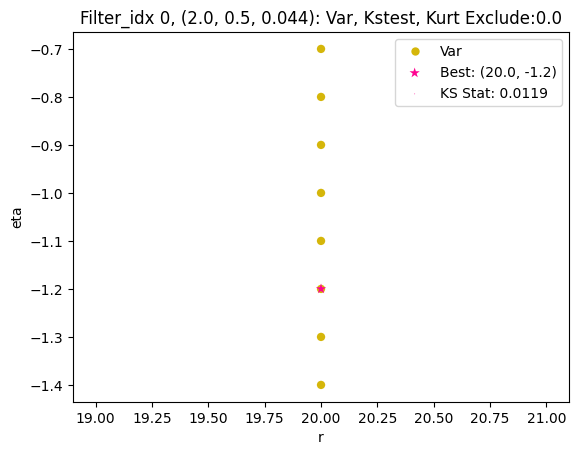

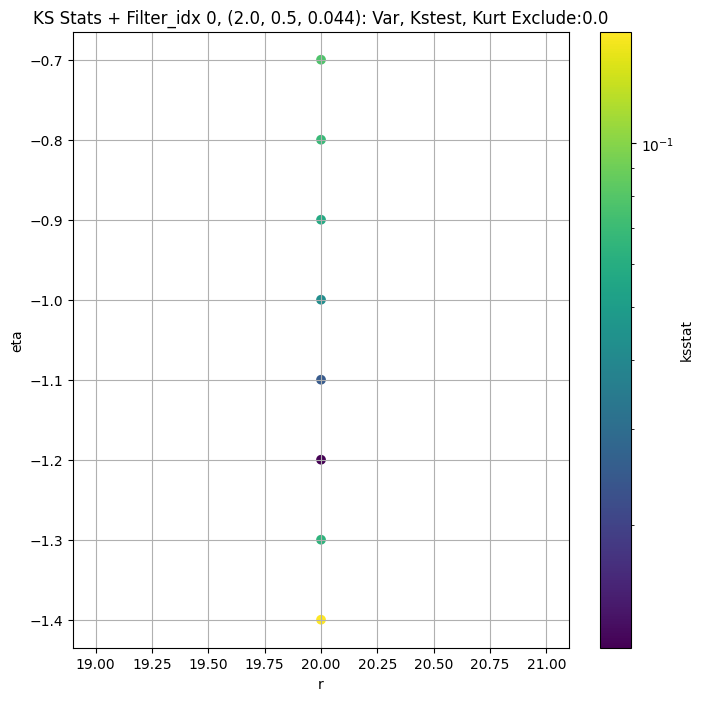

####
Filter_idx, 1: (2.0, 0.5, 0.065)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
1 0 0.008291019480602957 53.98736


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
1 50 0.00825804295112581 49.697327


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
1 100 0.008444873134707431 47.67844


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
1 200 0.008430626793578033 44.781834
Number of samples: 100000, Without approximation : 160000000.0


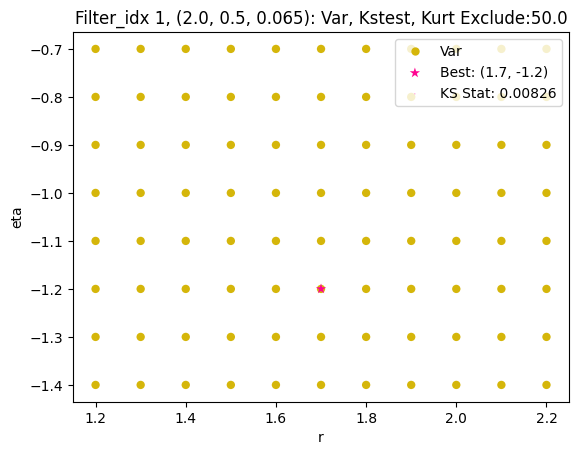

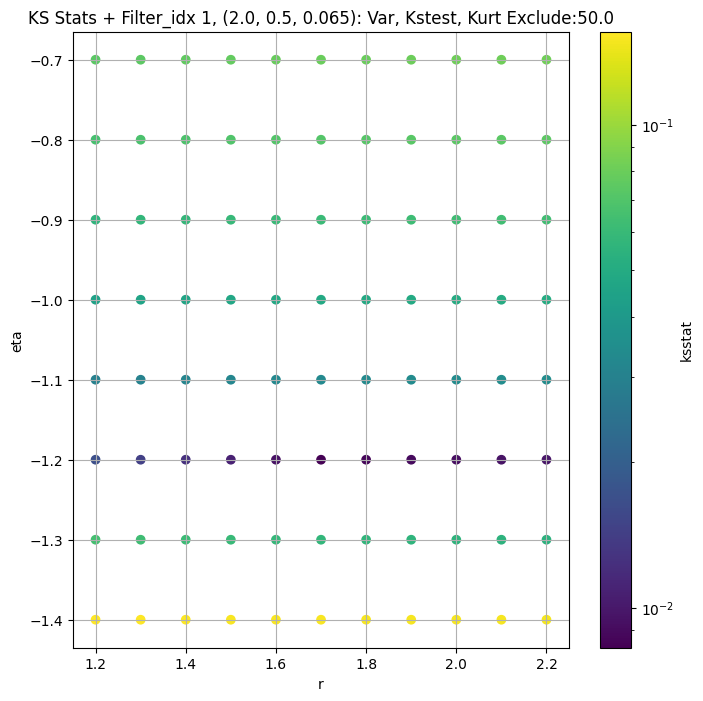

####
Filter_idx, 2: (2.0, 0.5, 0.096)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
2 0 0.00949687604740862 25.048847


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
2 50 0.008998130818664296 22.692627


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
2 100 0.00892541706187655 21.616781


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
2 200 0.008891948613127698 20.10901
Number of samples: 100000, Without approximation : 160000000.0


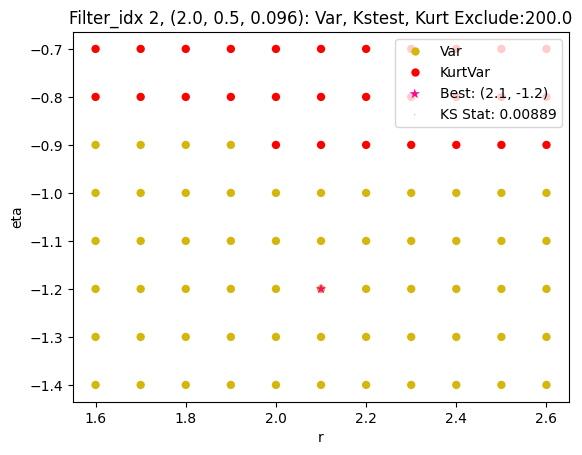

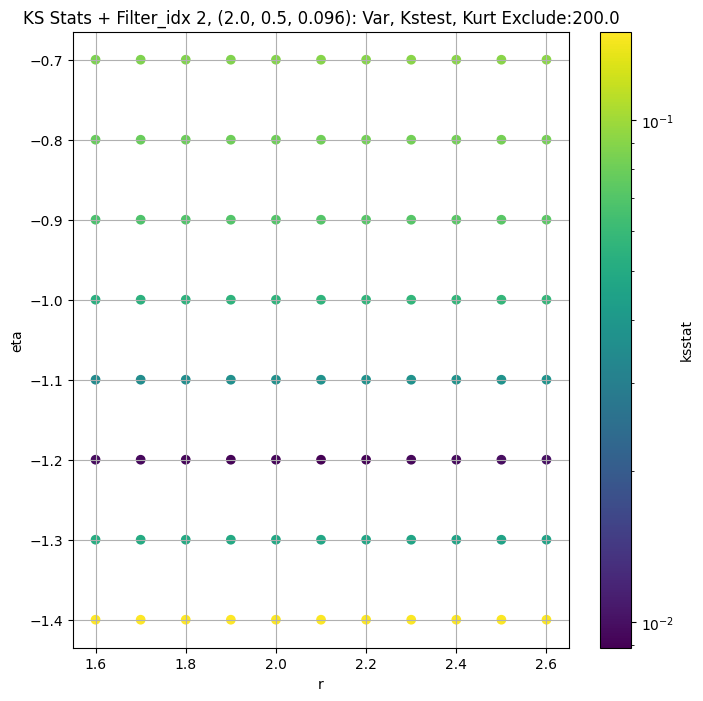

####
Filter_idx, 3: (2.0, 0.5, 0.141)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
3 0 0.008407561547504827 9.881065


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
3 50 0.01053073407796934 8.813172


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
3 100 0.013267073712072142 8.330953


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
3 200 0.010336766221440419 7.6655283
Number of samples: 100000, Without approximation : 160000000.0


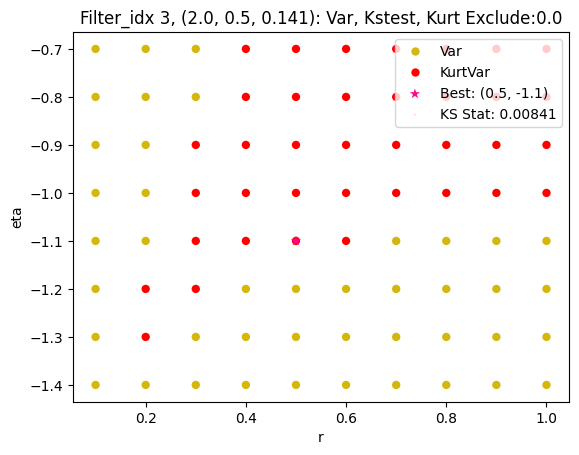

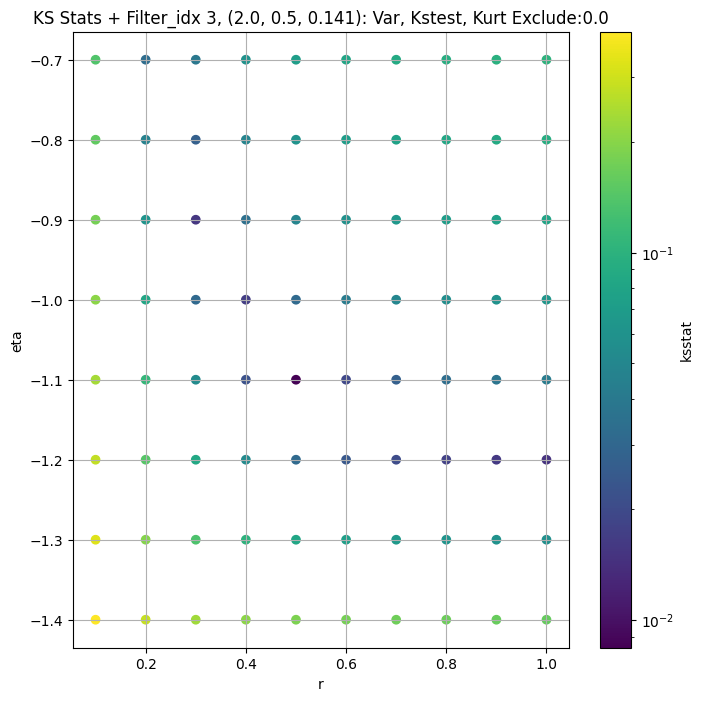

####
Filter_idx, 4: (2.0, 0.5, 0.208)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
4 0 0.00972585194058917 3.7354176


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
4 50 0.008497408199068968 3.2588975


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
4 100 0.012078857057540873 3.0612888


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
4 200 0.010024806430235289 2.7964945
Number of samples: 100000, Without approximation : 160000000.0


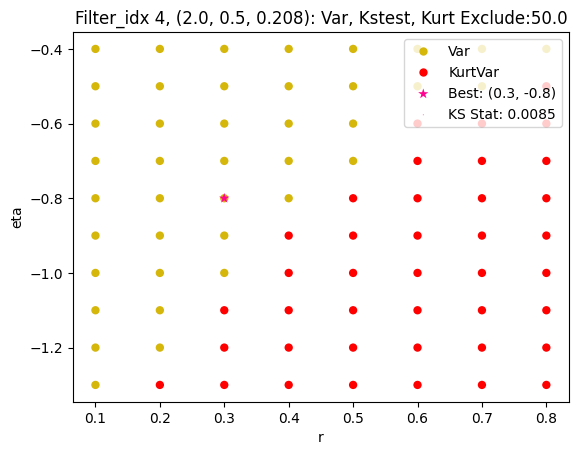

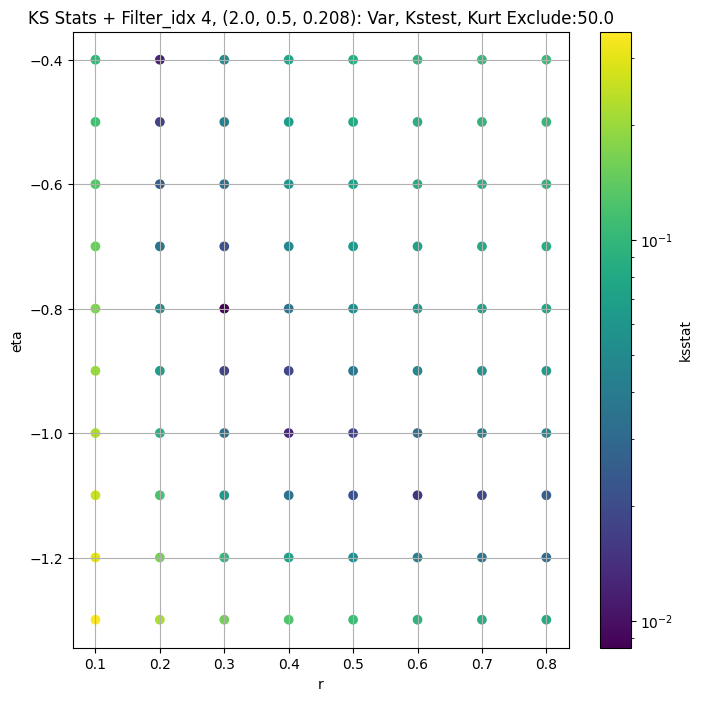

####
Filter_idx, 5: (2.0, 0.5, 0.306)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
5 0 0.005150289150922971 1.1133472


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
5 50 0.005334776770389363 0.9619272


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
5 100 0.005573974841994067 0.90302145


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
5 200 0.008293306790545962 0.8245754
Number of samples: 100000, Without approximation : 160000000.0


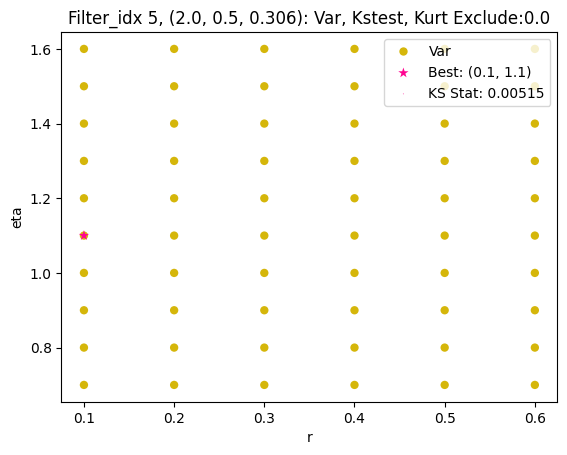

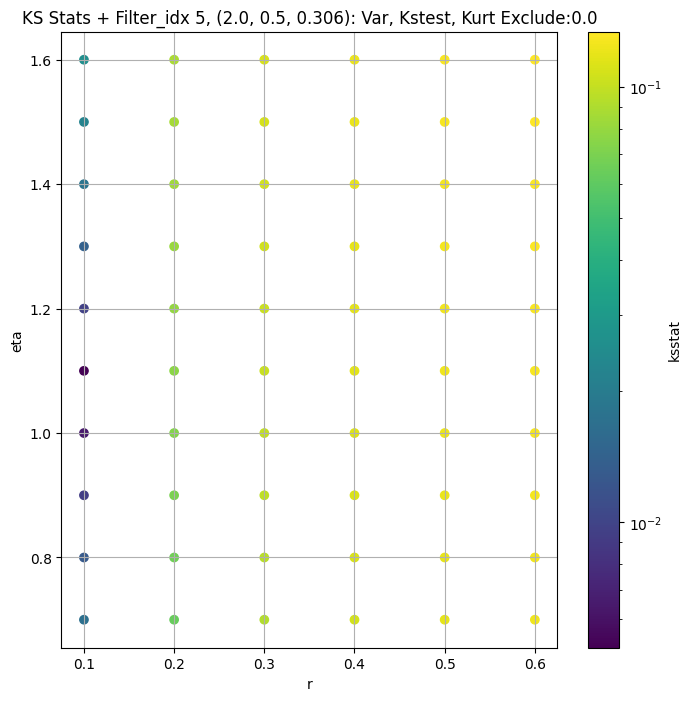

####
Filter_idx, 6: (2.0, 0.5, 0.45)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
6 0 0.0026880884918598635 0.71689576


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
6 50 0.005484566271768965 0.6174035


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
6 100 0.004810656787662848 0.58042336


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
6 200 0.006425683066458243 0.5313839
Number of samples: 100000, Without approximation : 160000000.0


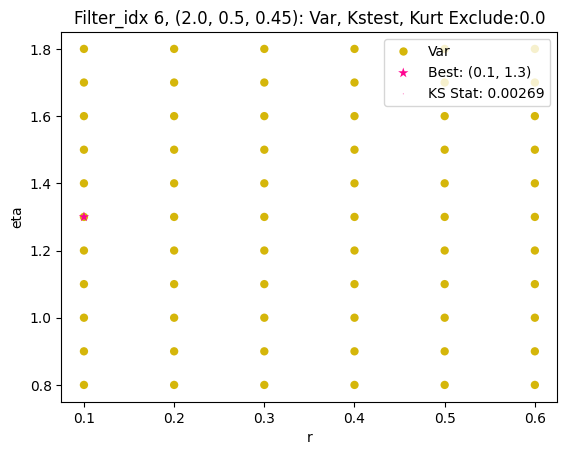

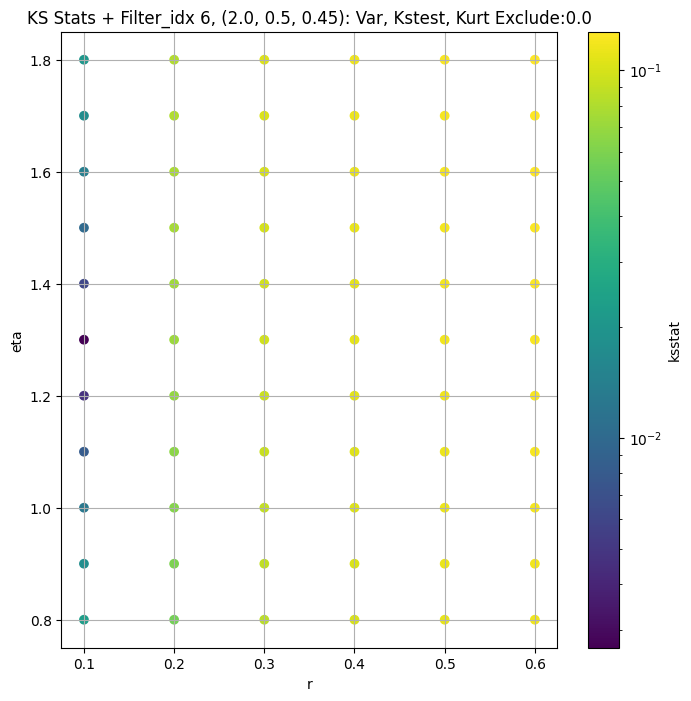

####
Filter_idx, 7: (2.0, 1.0, 0.044)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
7 0 0.008680885340743294 182.94016


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
7 50 0.007813265248948875 170.91742


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
7 100 0.008537923840615358 164.5714


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
7 200 0.011038542116014849 155.25818
Number of samples: 100000, Without approximation : 160000000.0


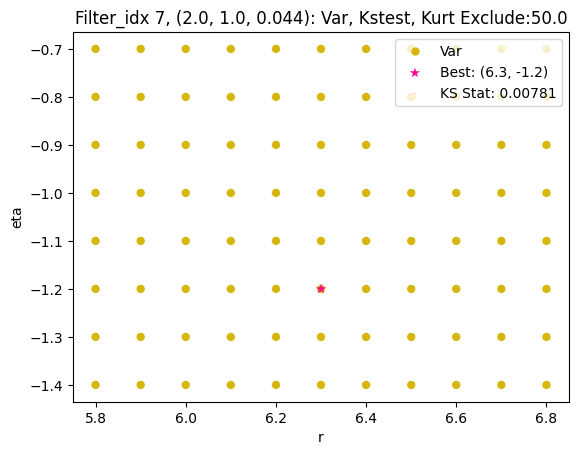

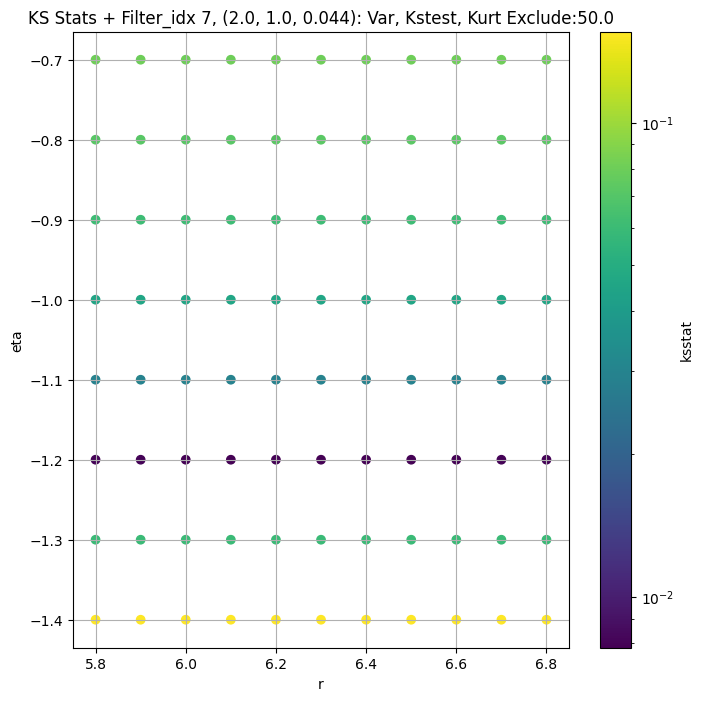

####
Filter_idx, 8: (2.0, 1.0, 0.065)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
8 0 0.007300450971523764 73.88104


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
8 50 0.007245673842400713 68.67646


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
8 100 0.007358918043911089 66.02453


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
8 200 0.007377190195235528 62.147495
Number of samples: 100000, Without approximation : 160000000.0


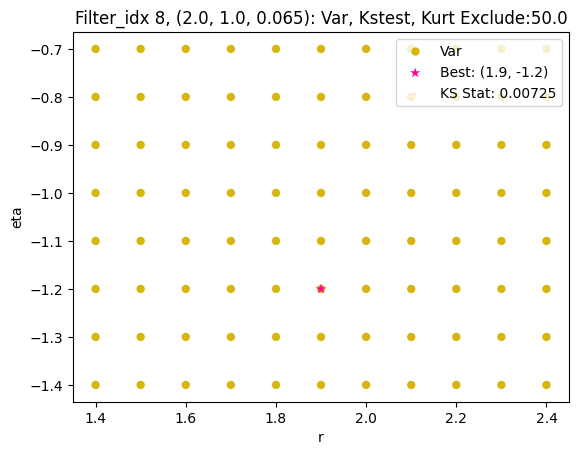

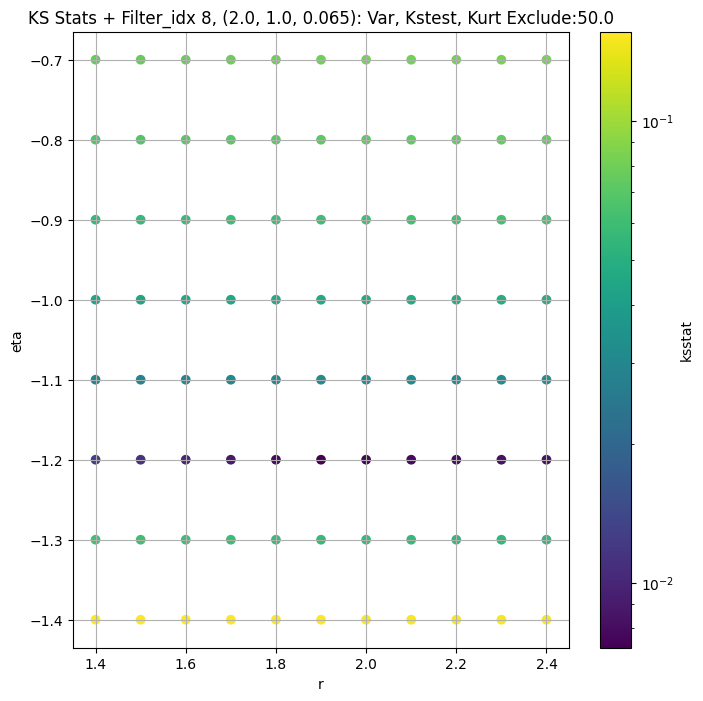

####
Filter_idx, 9: (2.0, 1.0, 0.096)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
9 0 0.008697368236322944 32.86332


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
9 50 0.008272438391721537 29.779945


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
9 100 0.008071096643863462 28.445591


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
9 200 0.007906583796826183 26.551332
Number of samples: 100000, Without approximation : 160000000.0


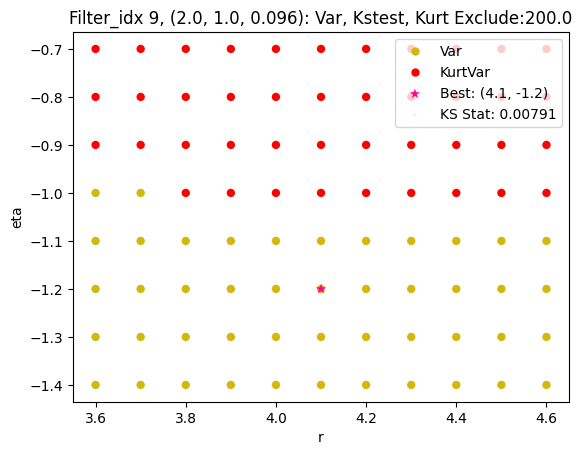

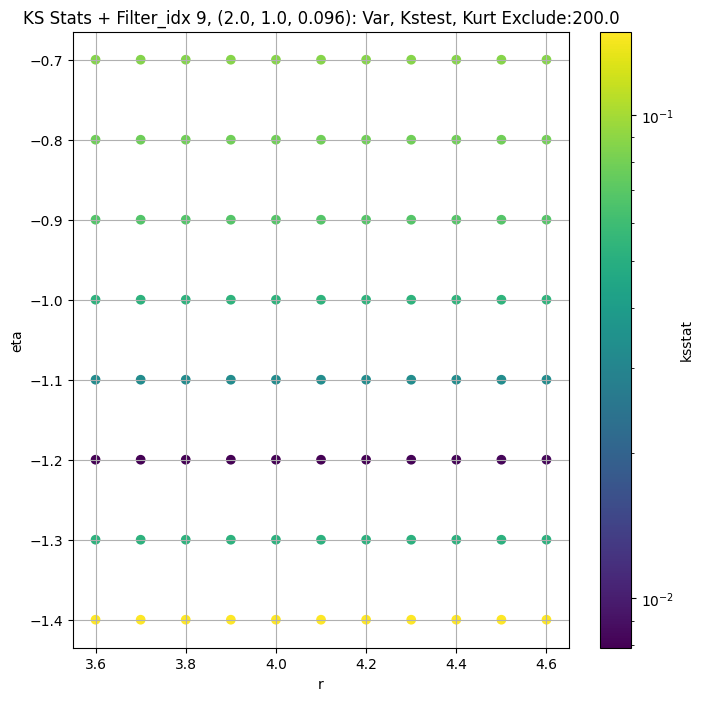

####
Filter_idx, 10: (2.0, 1.0, 0.141)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
10 0 0.010358896408830143 14.108161


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
10 50 0.008105542444633518 12.746076


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
10 100 0.007152089840006787 12.097319


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
10 200 0.010878125093911062 11.187624
Number of samples: 100000, Without approximation : 160000000.0


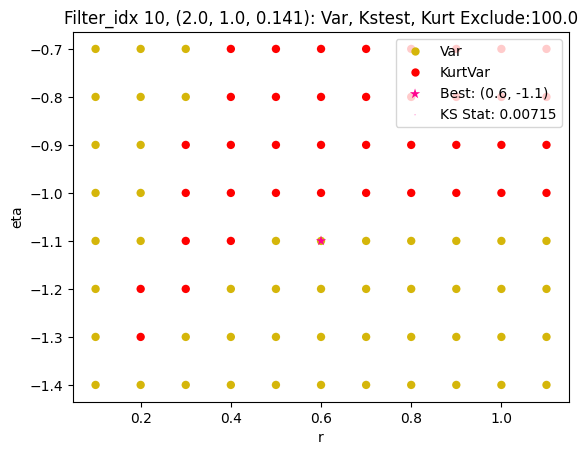

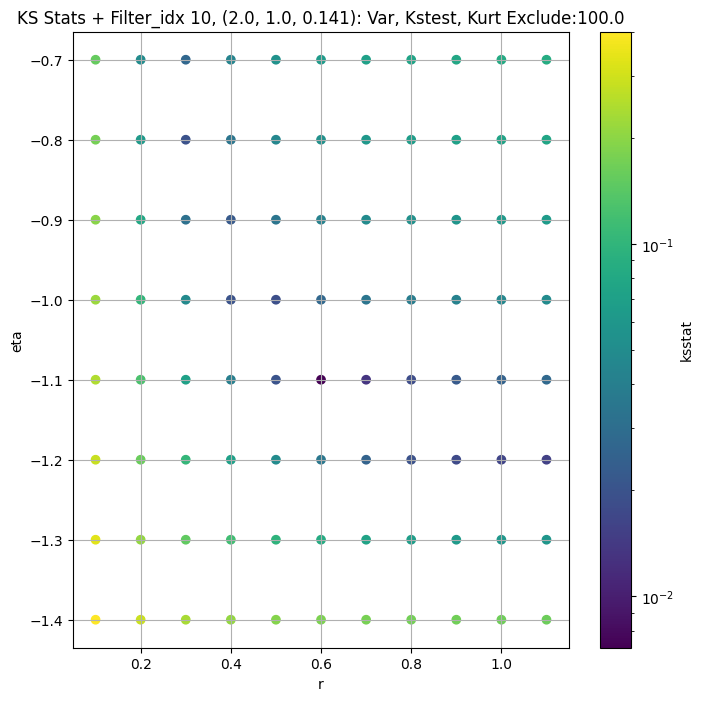

####
Filter_idx, 11: (2.0, 1.0, 0.208)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
11 0 0.008219561267290842 5.1228614


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
11 50 0.008998698155482043 4.5140486


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
11 100 0.011311092864816241 4.2515473


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
11 200 0.01163749330205327 3.8933172
Number of samples: 100000, Without approximation : 160000000.0


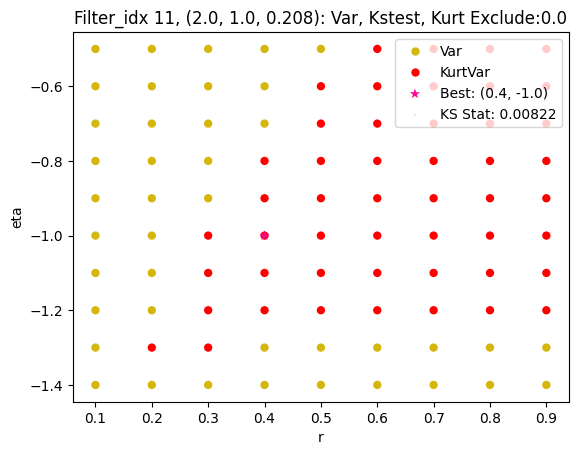

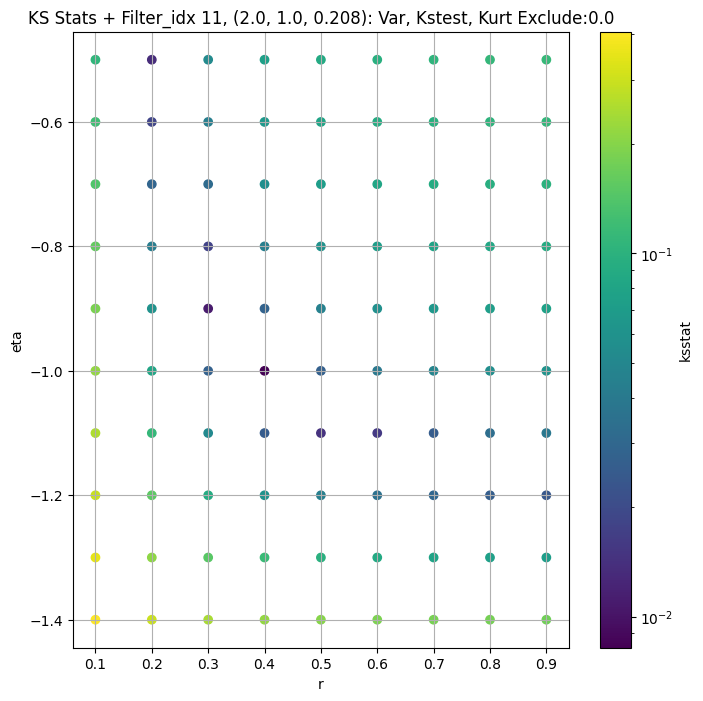

####
Filter_idx, 12: (2.0, 1.0, 0.306)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
12 0 0.004966637025094034 1.7179714


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
12 50 0.006324802572658106 1.4761635


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
12 100 0.007168574555255547 1.3837768


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
12 200 0.009547067668728648 1.2606438
Number of samples: 100000, Without approximation : 160000000.0


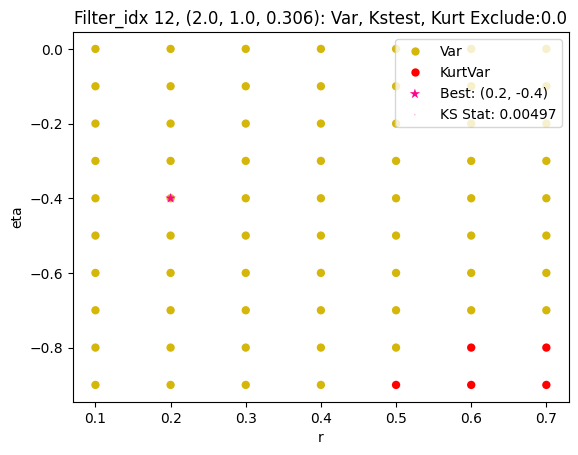

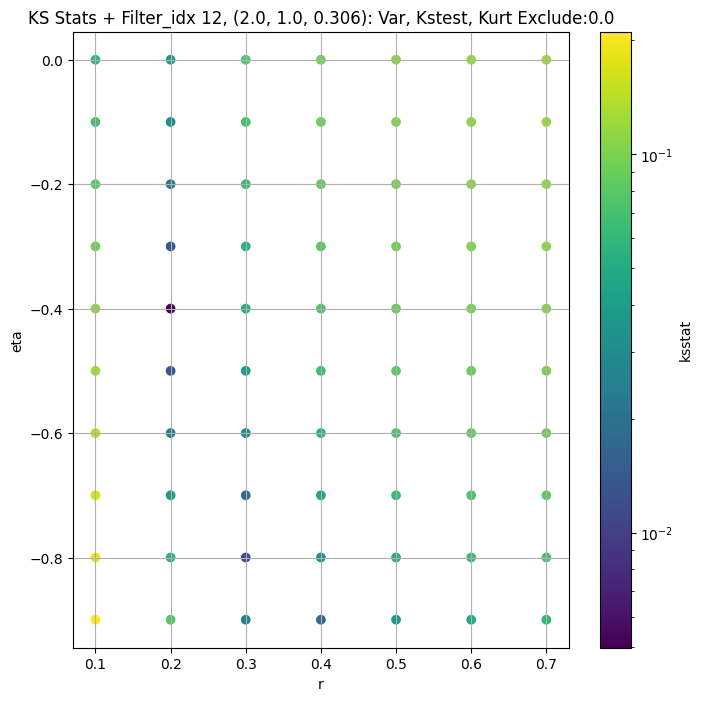

####
Filter_idx, 13: (2.0, 1.0, 0.45)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
13 0 0.0033710006536157855 0.75482696


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
13 50 0.00340893939226794 0.63579875


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
13 100 0.004379033518322584 0.5976799


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
13 200 0.005287802173716272 0.54717493
Number of samples: 100000, Without approximation : 160000000.0


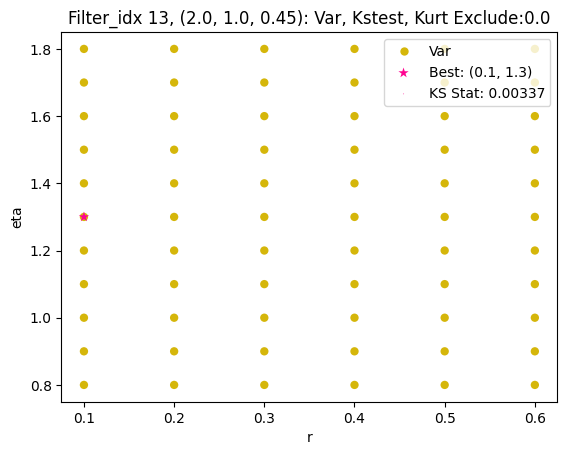

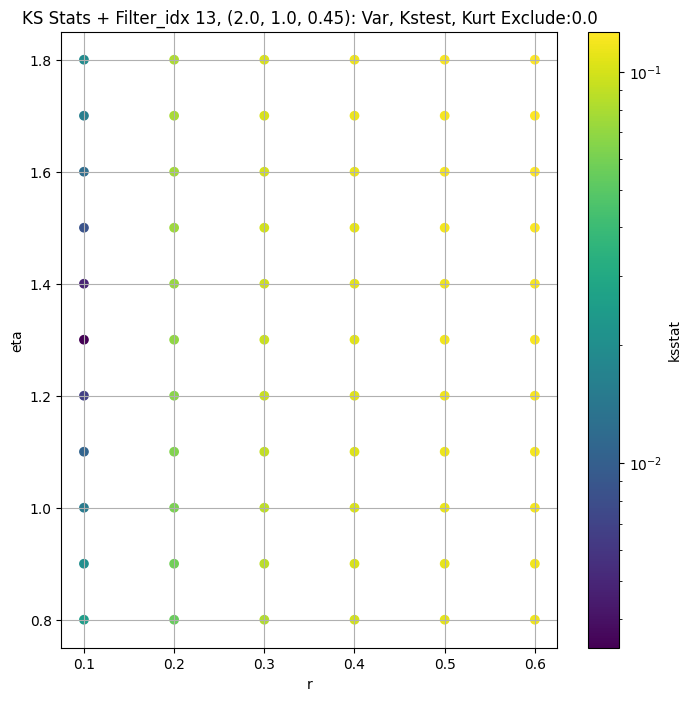

####
Filter_idx, 14: (3.0, 0.5, 0.044)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
14 0 0.00667761022556429 139.32408


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
14 50 0.006718062438968886 130.39471


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
14 100 0.006741565884656298 125.57659


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
14 200 0.006775496782890356 118.47561
Number of samples: 100000, Without approximation : 160000000.0


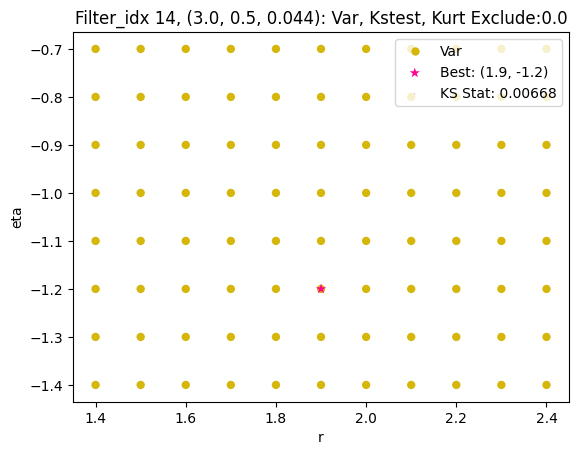

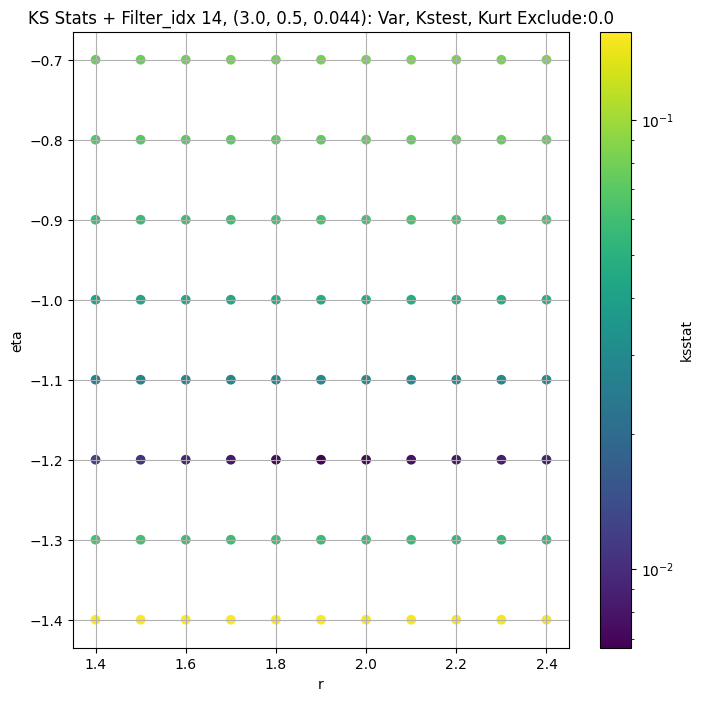

####
Filter_idx, 15: (3.0, 0.5, 0.065)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
15 0 0.009293937161300336 54.512917


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
15 50 0.009291015420204135 50.189693


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
15 100 0.009665236510691566 48.077095


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
15 200 0.009672170280749404 45.016285
Number of samples: 100000, Without approximation : 160000000.0


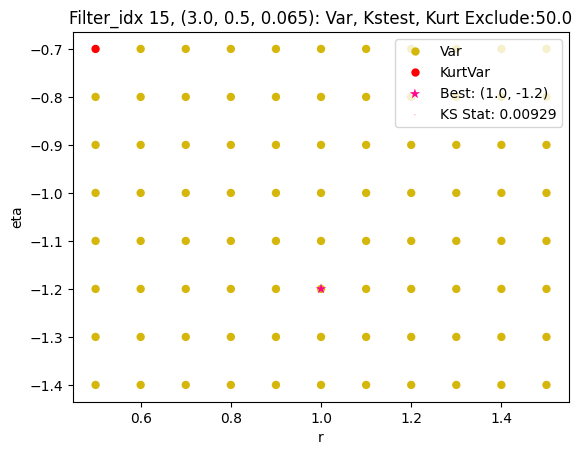

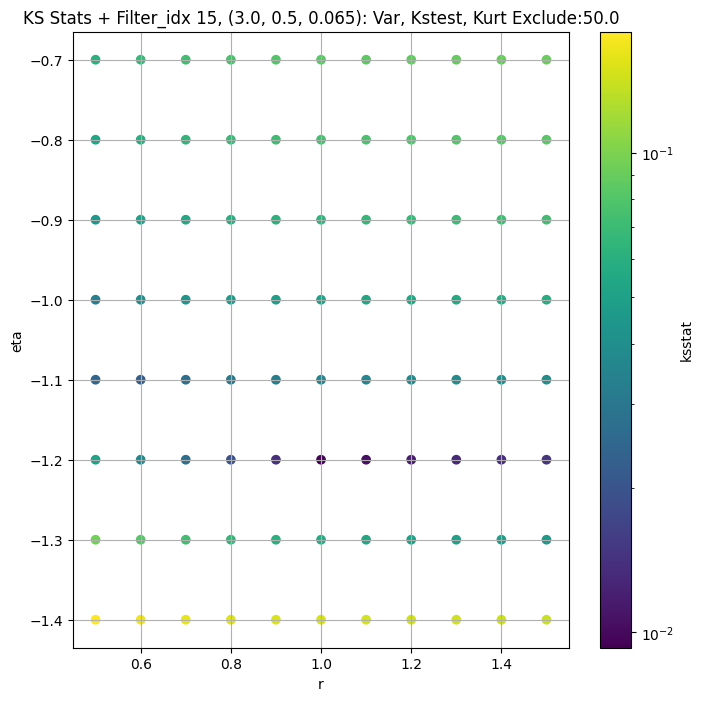

####
Filter_idx, 16: (3.0, 0.5, 0.096)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
16 0 0.010029939388770948 24.844587


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
16 50 0.009680863216199542 22.599012


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
16 100 0.009433090021807033 21.531128


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
16 200 0.00936196616236784 20.002647
Number of samples: 100000, Without approximation : 160000000.0


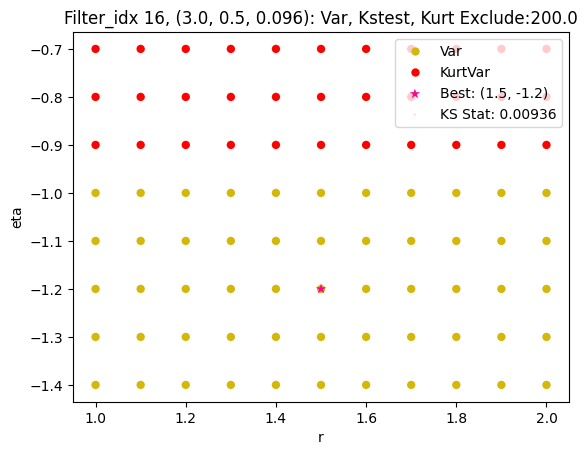

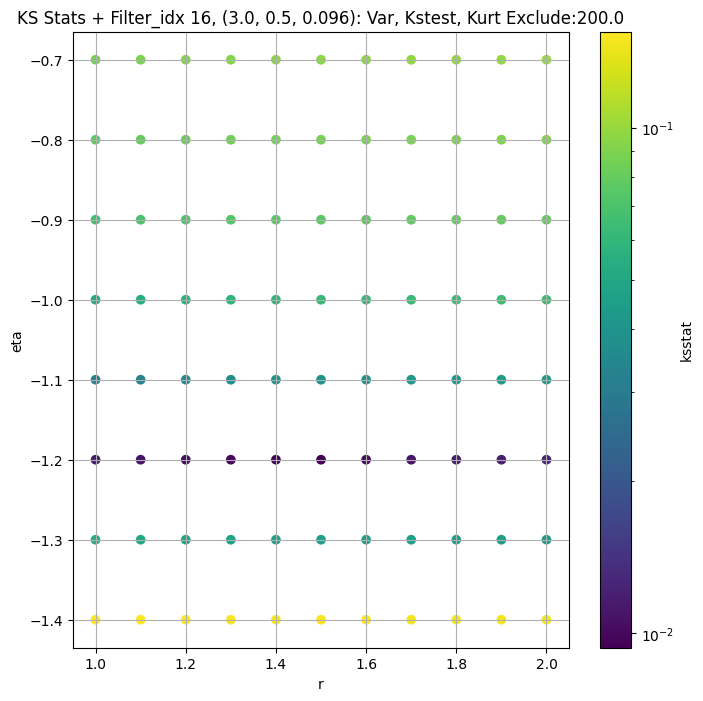

####
Filter_idx, 17: (3.0, 0.5, 0.141)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
17 0 0.011918066514759351 10.273449


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
17 50 0.007855086440284764 9.17426


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
17 100 0.008835194483174158 8.660181


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
17 200 0.013648453594026555 7.9488015
Number of samples: 100000, Without approximation : 160000000.0


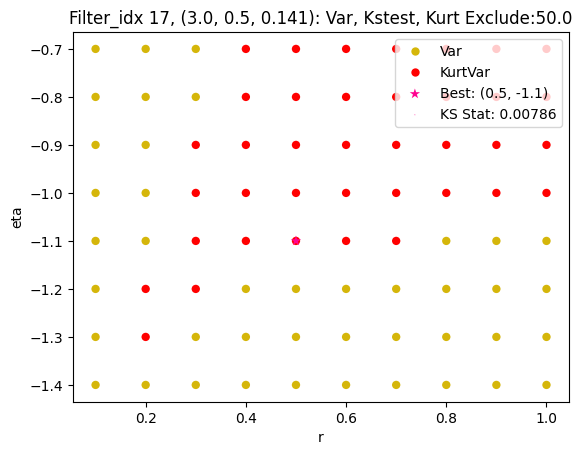

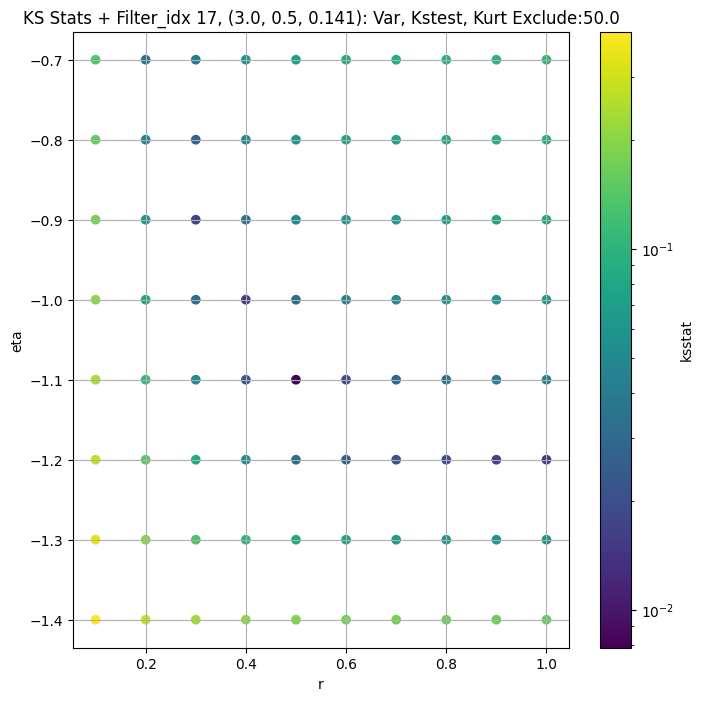

####
Filter_idx, 18: (3.0, 0.5, 0.208)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
18 0 0.008821002569129321 3.741431


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
18 50 0.009932831002508302 3.2639015


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
18 100 0.010048119699740288 3.0601838


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
18 200 0.011772583539741088 2.7838843
Number of samples: 100000, Without approximation : 160000000.0


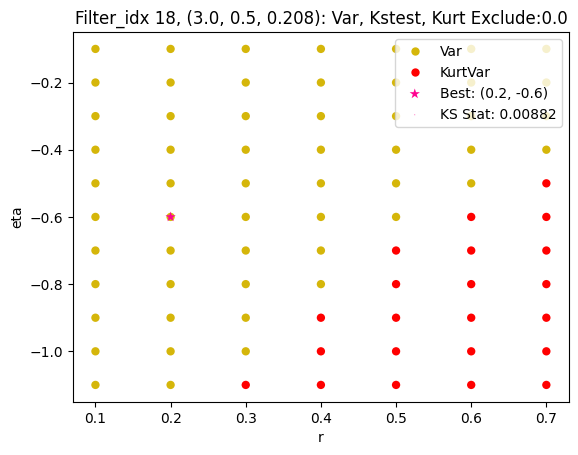

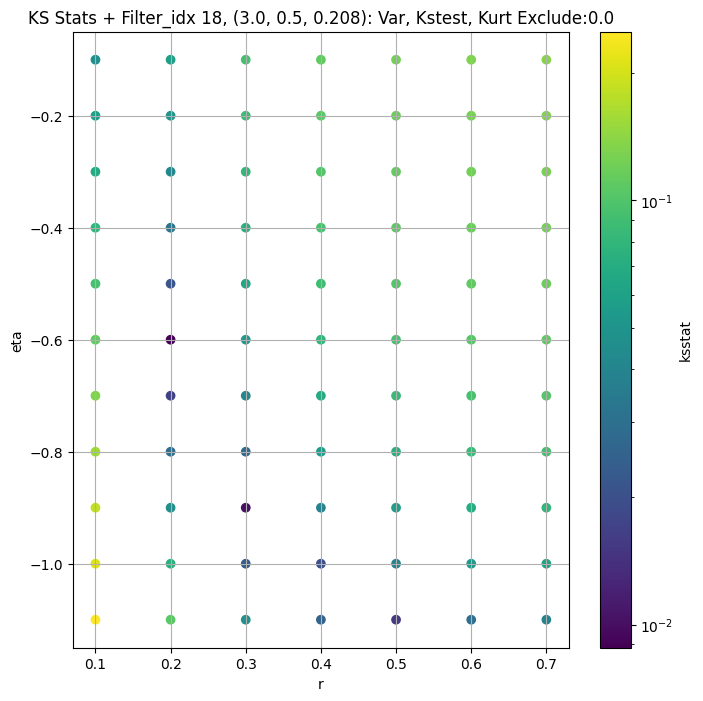

####
Filter_idx, 19: (3.0, 0.5, 0.306)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
19 0 0.004504739132859592 1.1976594


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
19 50 0.005817371154248019 1.0165291


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
19 100 0.007356499324272514 0.94954354


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
19 200 0.008124812017431537 0.8617043
Number of samples: 100000, Without approximation : 160000000.0


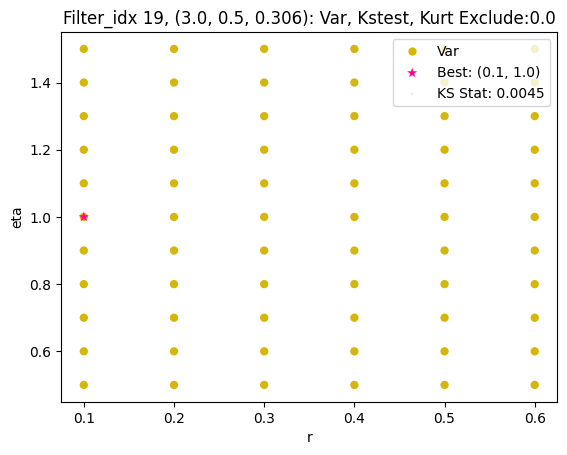

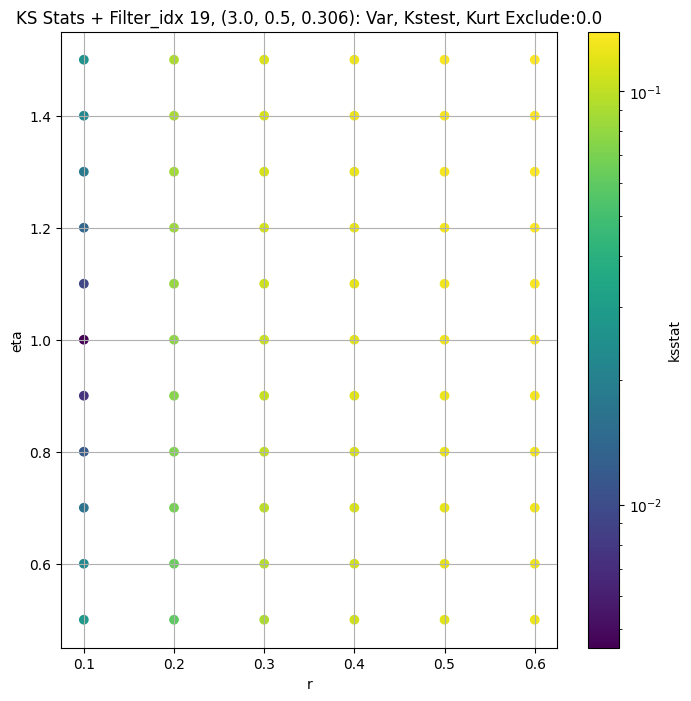

####
Filter_idx, 20: (3.0, 0.5, 0.45)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
20 0 0.005658378822333221 0.43484458


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
20 50 0.0030763427574831553 0.35875446


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
20 100 0.004734357523957455 0.33674732


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
20 200 0.005657881296596279 0.30813766
Number of samples: 100000, Without approximation : 160000000.0


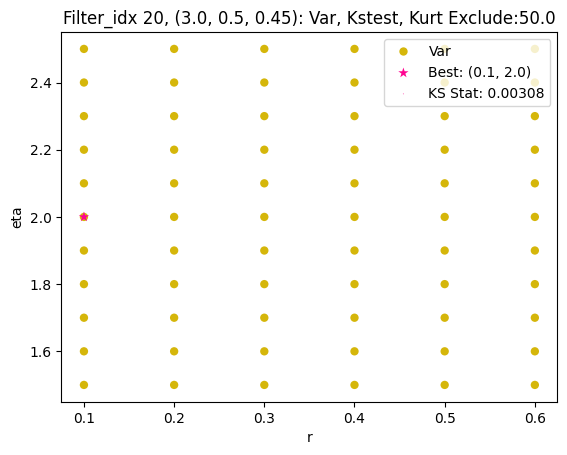

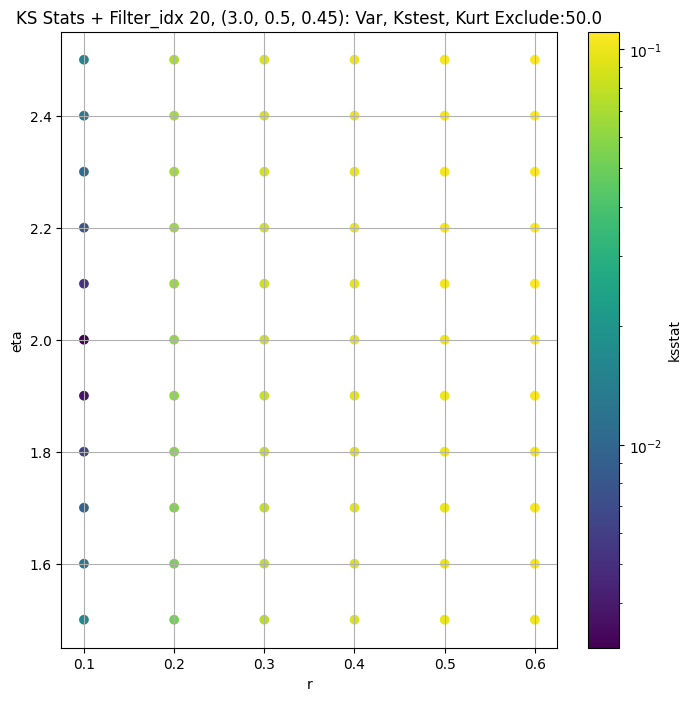

####
Filter_idx, 21: (3.0, 1.0, 0.044)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
21 0 0.006679227743681904 159.65025


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
21 50 0.006807142356907769 148.31013


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
21 100 0.006962918784327976 142.54285


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
21 200 0.0069082345362775355 134.11868
Number of samples: 100000, Without approximation : 160000000.0


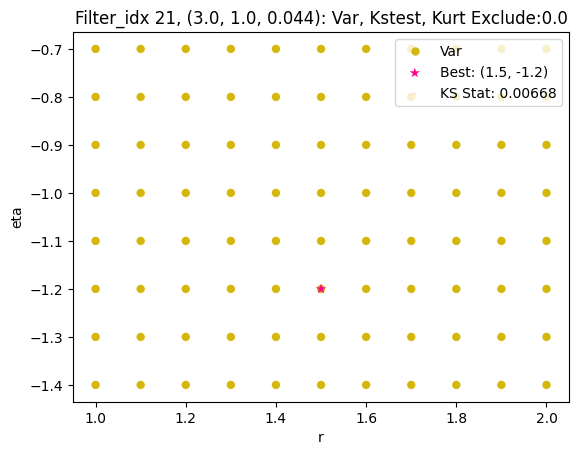

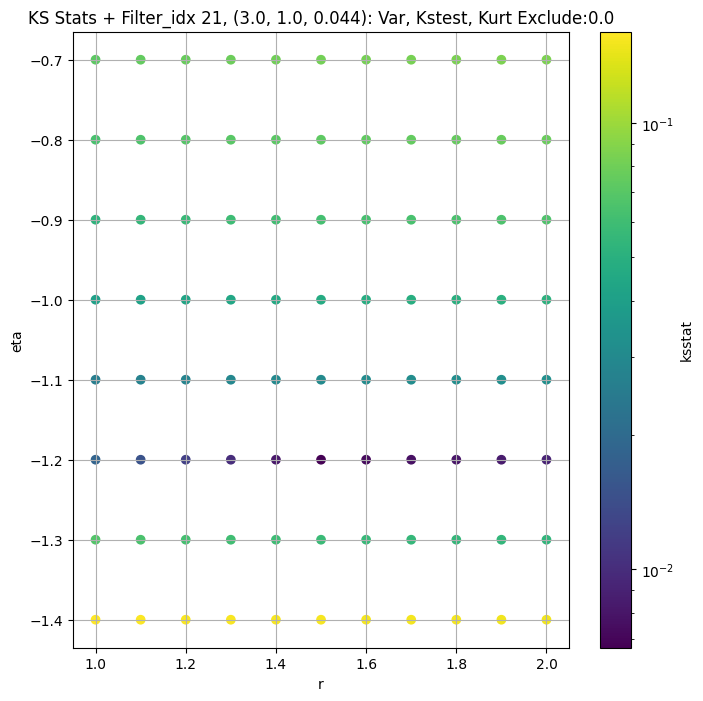

####
Filter_idx, 22: (3.0, 1.0, 0.065)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
22 0 0.00866997883340459 61.57288


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
22 50 0.008757745767809577 56.93861


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
22 100 0.009133337869711433 54.60956


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
22 200 0.009023527731631065 51.189537
Number of samples: 100000, Without approximation : 160000000.0


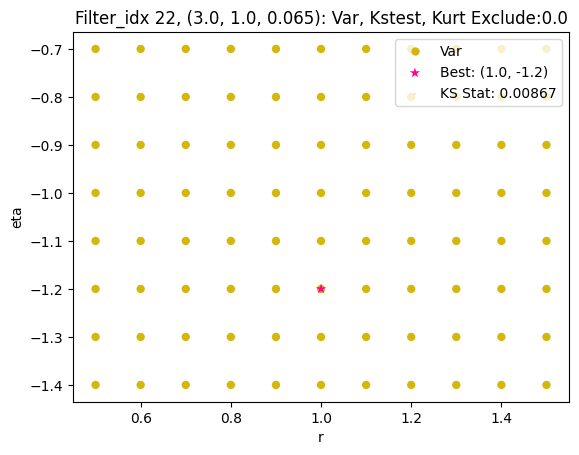

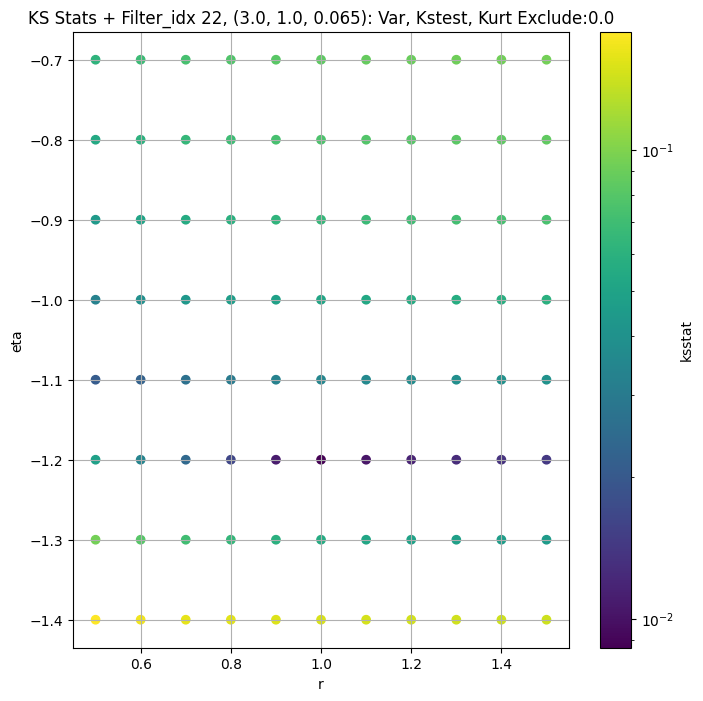

####
Filter_idx, 23: (3.0, 1.0, 0.096)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
23 0 0.010245134213639429 25.62438


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
23 50 0.010323021477135652 23.201721


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
23 100 0.010336368240937976 22.043484


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
23 200 0.010224662050396738 20.395191
Number of samples: 100000, Without approximation : 160000000.0


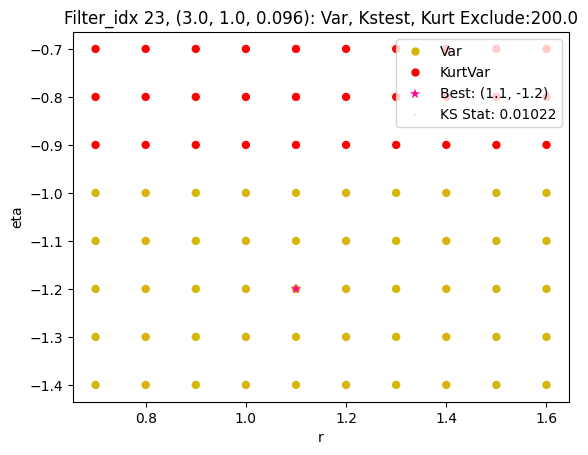

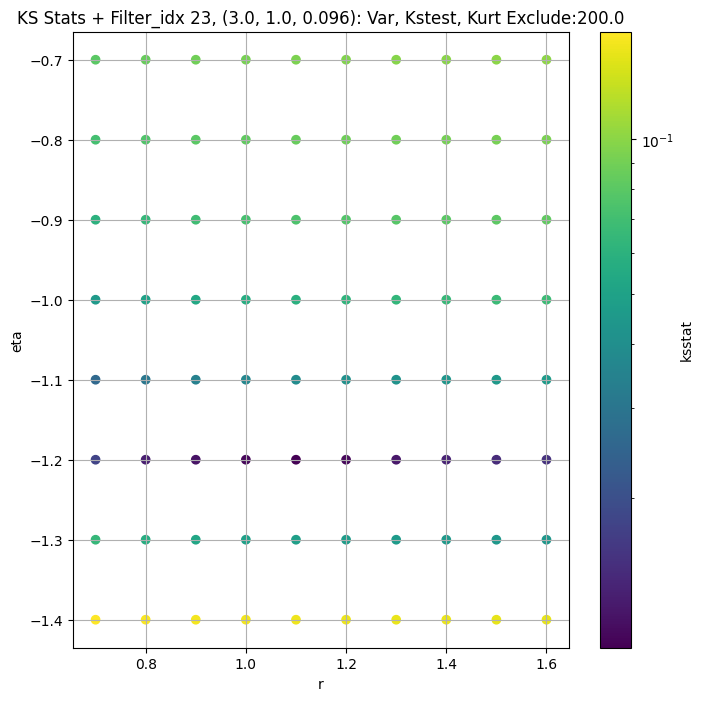

####
Filter_idx, 24: (3.0, 1.0, 0.141)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
24 0 0.011379477875293142 12.506859


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
24 50 0.011628933231301042 11.015664


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
24 100 0.009473843123787073 10.393628


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
24 200 0.010811925216138829 9.533295
Number of samples: 100000, Without approximation : 160000000.0


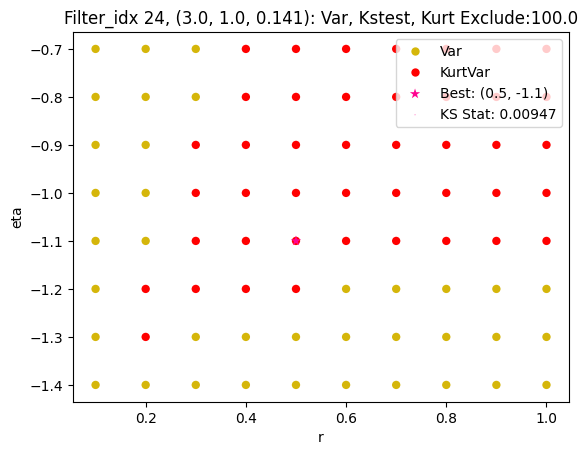

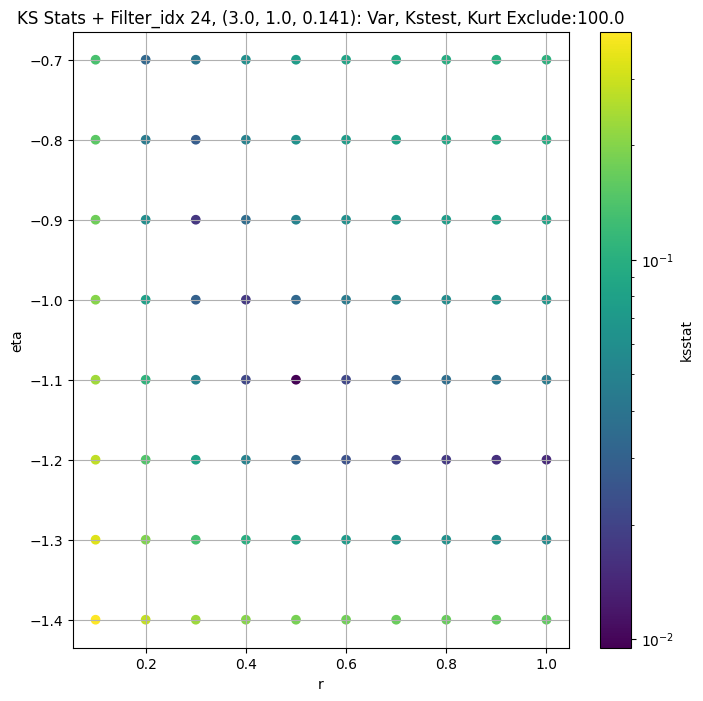

####
Filter_idx, 25: (3.0, 1.0, 0.208)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
25 0 0.008414288866986697 4.274352


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
25 50 0.009437522142462462 3.7173476


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
25 100 0.00961239216605081 3.4824166


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
25 200 0.011246817733929965 3.1646223
Number of samples: 100000, Without approximation : 160000000.0


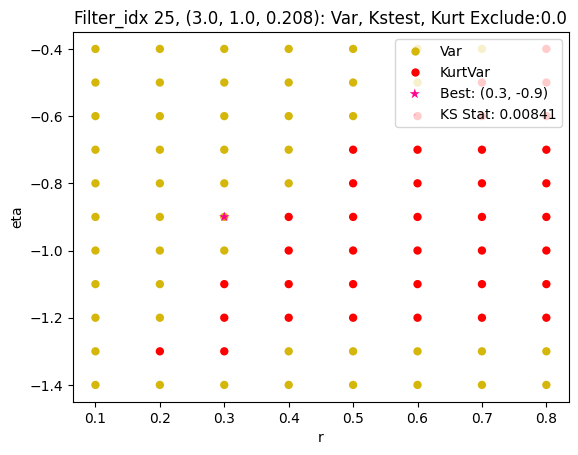

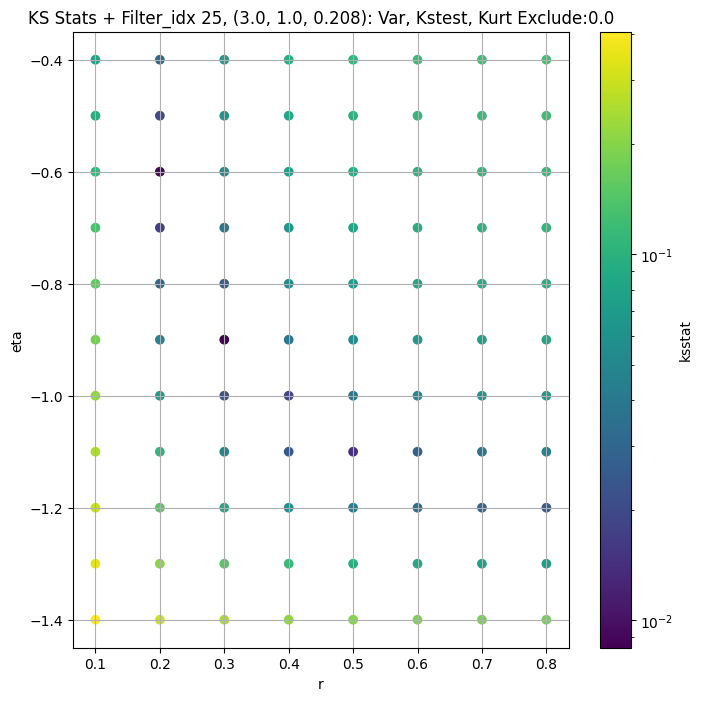

####
Filter_idx, 26: (3.0, 1.0, 0.306)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
26 0 0.005349915913388403 1.4885468


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
26 50 0.006346880703880398 1.2296454


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
26 100 0.006785687960445652 1.1426135


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
26 200 0.007992271508378335 1.0299034
Number of samples: 100000, Without approximation : 160000000.0


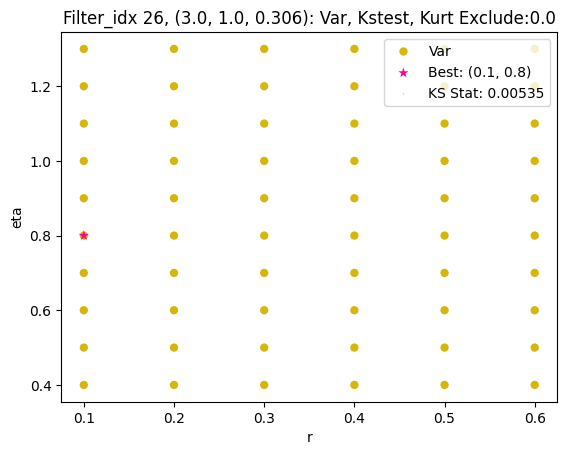

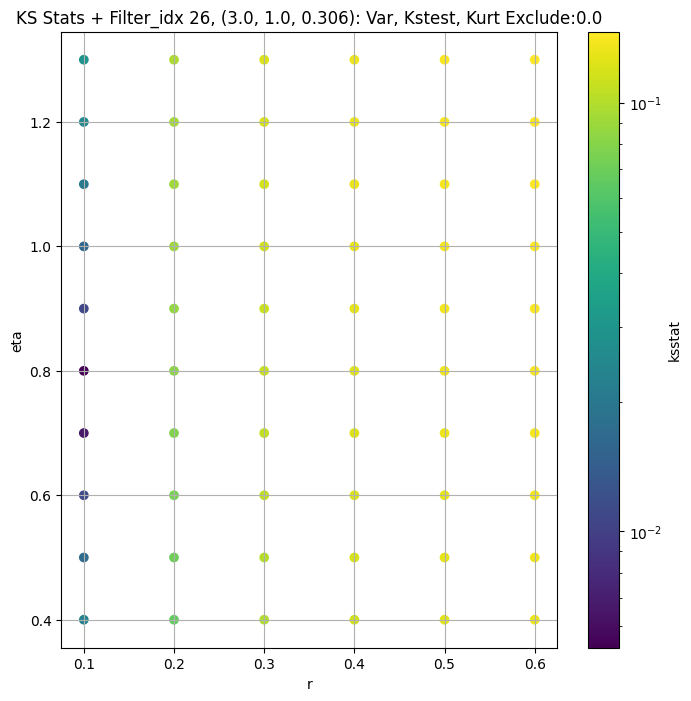

####
Filter_idx, 27: (3.0, 1.0, 0.45)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
27 0 0.005220247353054375 0.4579739


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
27 50 0.0029781161749560456 0.37347558


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
27 100 0.0046600146677572285 0.34895673


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
27 200 0.005553678071541501 0.31759402
Number of samples: 100000, Without approximation : 160000000.0


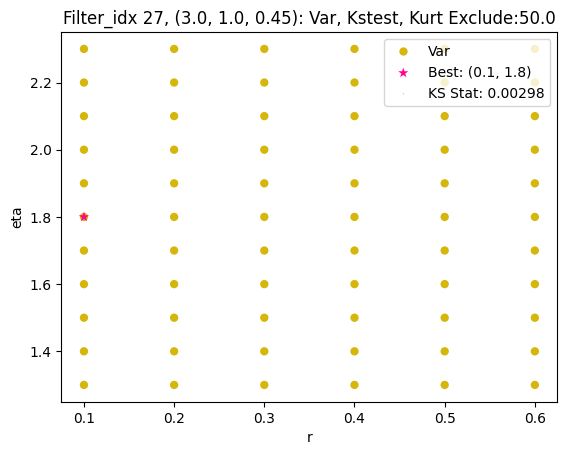

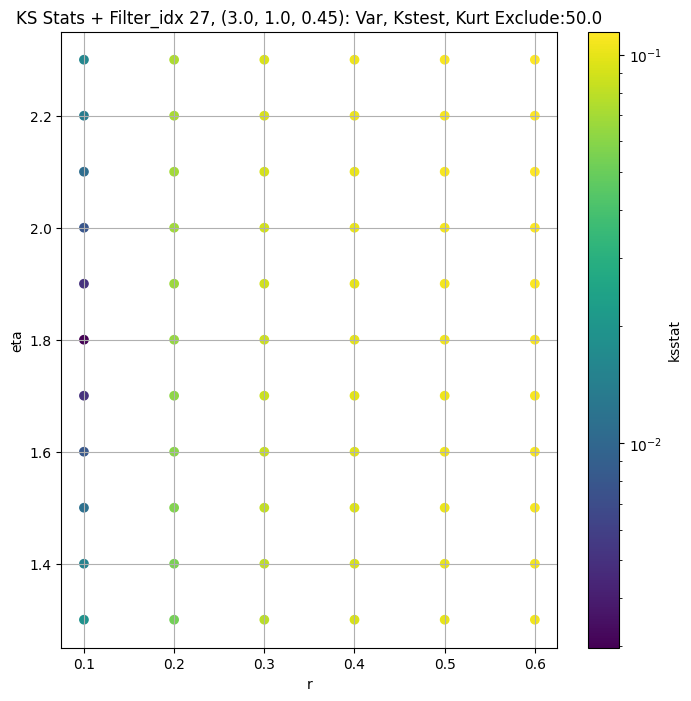

####
Filter_idx, 28: (4.0, 0.5, 0.044)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
28 0 0.00778112284460708 136.12923


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
28 50 0.0067535275494254865 126.736885


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
28 100 0.0062404333372506615 121.79038


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
28 200 0.006279242541855967 114.52753
Number of samples: 100000, Without approximation : 160000000.0


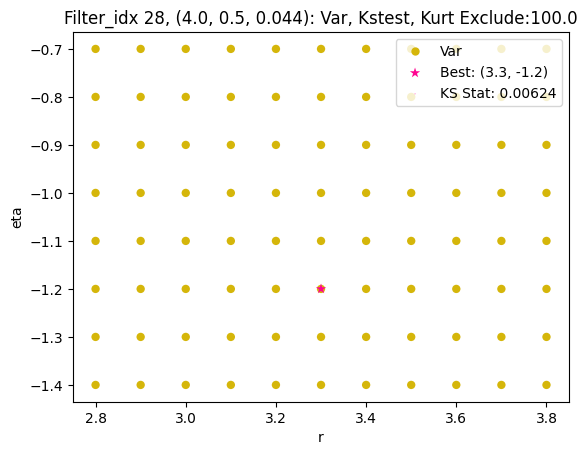

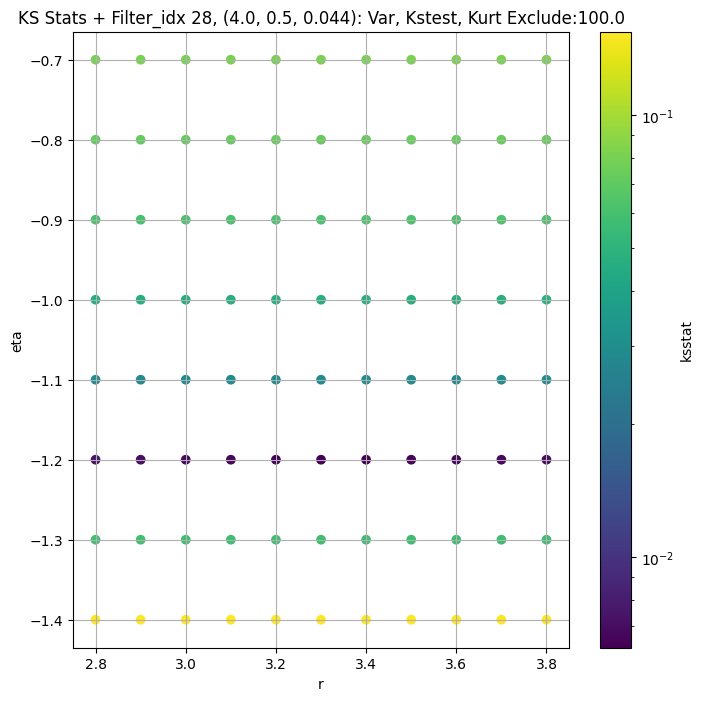

####
Filter_idx, 29: (4.0, 0.5, 0.065)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
29 0 0.00747623461973268 52.638275


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
29 50 0.007212527793894807 48.882057


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
29 100 0.007413735249095277 46.836327


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
29 200 0.00725386634143288 43.82497
Number of samples: 100000, Without approximation : 160000000.0


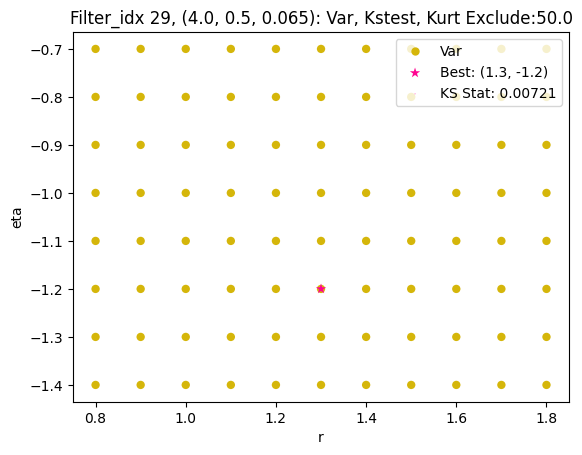

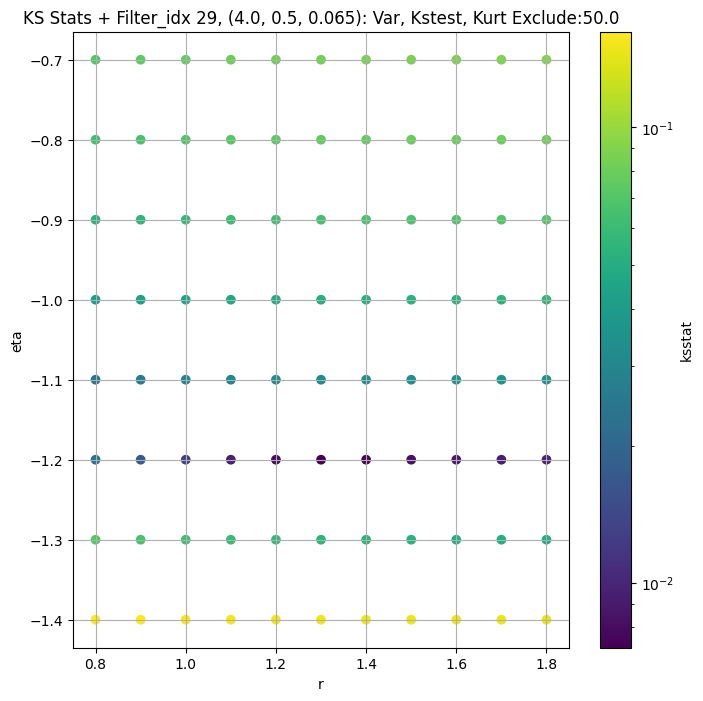

####
Filter_idx, 30: (4.0, 0.5, 0.096)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
30 0 0.01023180654892697 23.663502


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
30 50 0.009783620892728051 21.39322


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
30 100 0.009626251604264169 20.318043


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
30 200 0.009646167960493113 18.797237
Number of samples: 100000, Without approximation : 160000000.0


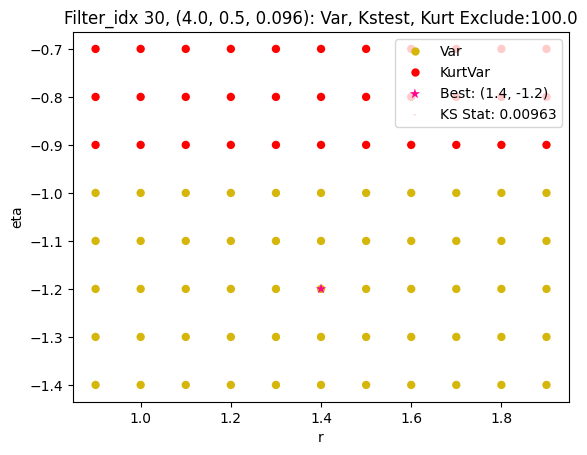

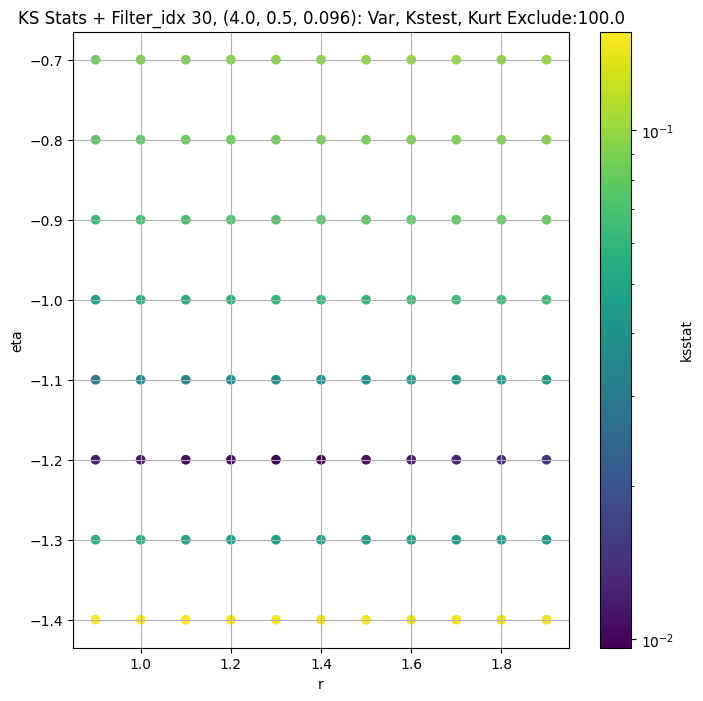

####
Filter_idx, 31: (4.0, 0.5, 0.141)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
31 0 0.01060478977406254 10.277639


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
31 50 0.0087911383476863 9.127924


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
31 100 0.011065562907355608 8.625121


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
31 200 0.012244449655096079 7.928332
Number of samples: 100000, Without approximation : 160000000.0


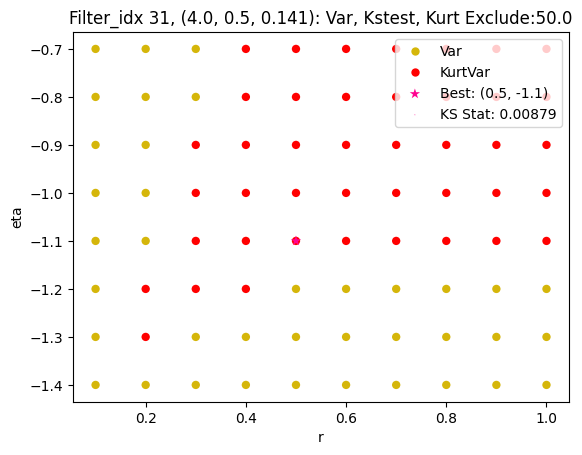

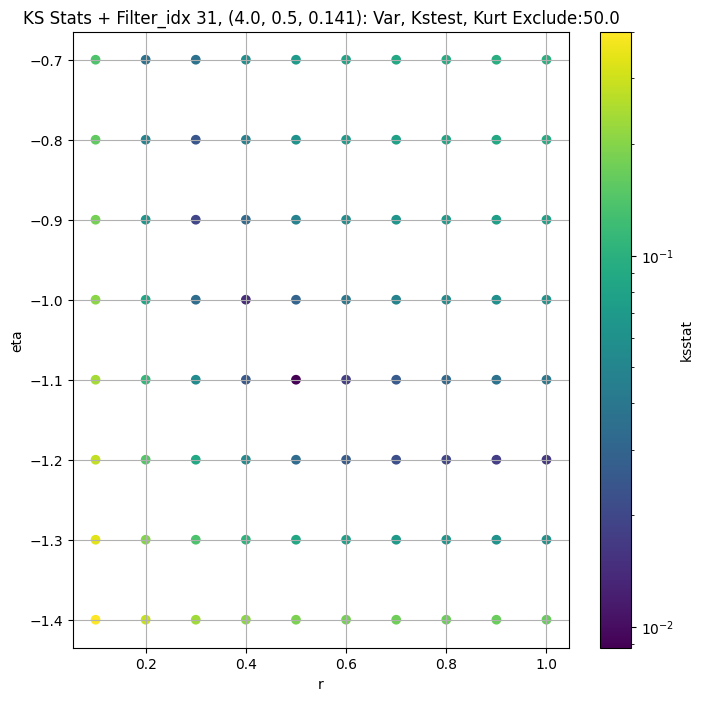

####
Filter_idx, 32: (4.0, 0.5, 0.208)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
32 0 0.010418936831160686 3.3609097


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
32 50 0.011084126202037026 2.8921907


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
32 100 0.008948592752630602 2.7017503


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
32 200 0.013683795376347563 2.4498463
Number of samples: 100000, Without approximation : 160000000.0


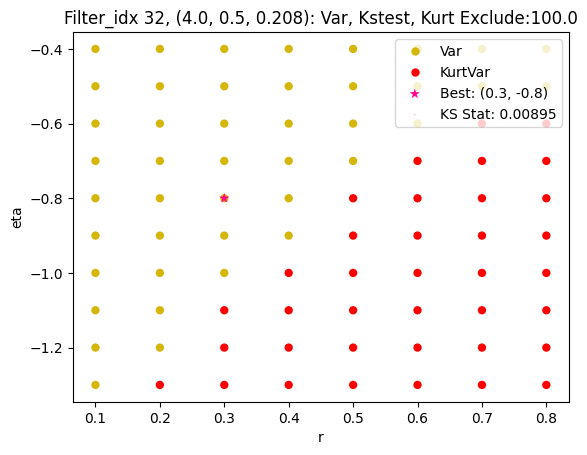

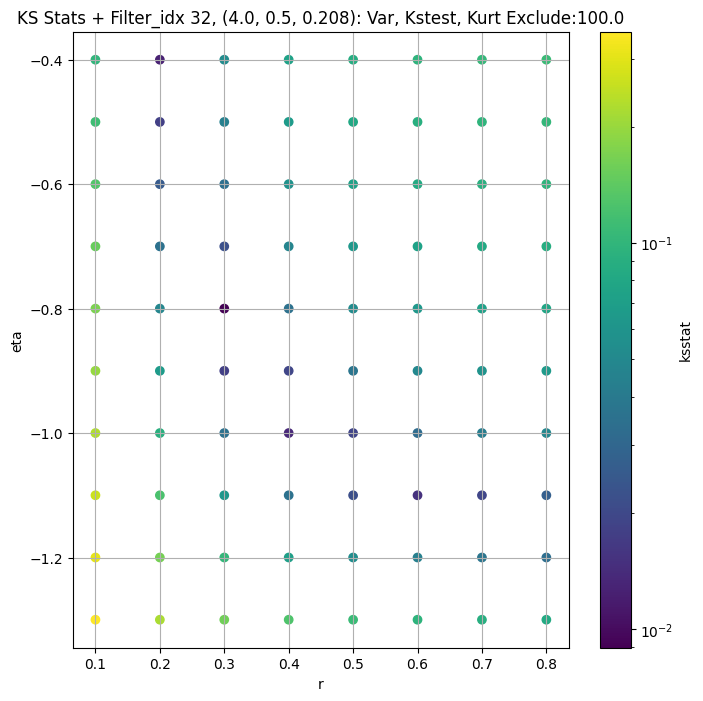

####
Filter_idx, 33: (4.0, 0.5, 0.306)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
33 0 0.005265828296690034 1.0732713


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
33 50 0.0058706330858731 0.8824727


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
33 100 0.006088268187974144 0.8220456


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
33 200 0.007775040772564454 0.74376273
Number of samples: 100000, Without approximation : 160000000.0


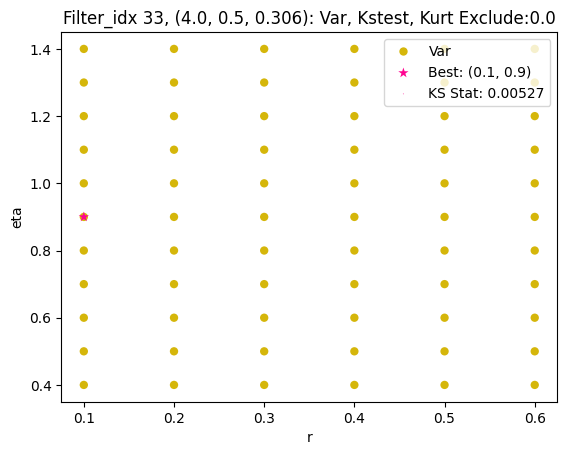

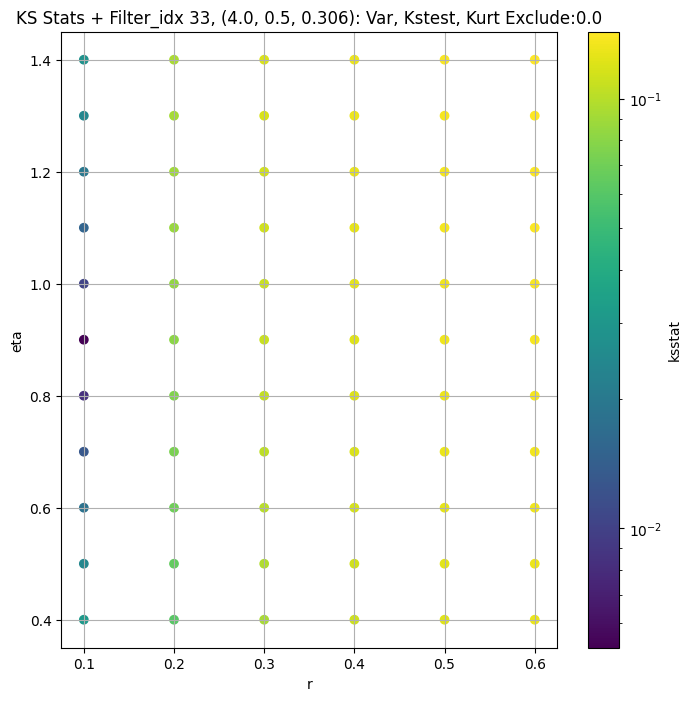

####
Filter_idx, 34: (4.0, 0.5, 0.45)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
34 0 0.005390478847406843 0.3225316


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
34 50 0.002544187528756958 0.26139334


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
34 100 0.0029999105169233875 0.24569654


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
34 200 0.0053010264433202 0.2255335
Number of samples: 100000, Without approximation : 160000000.0


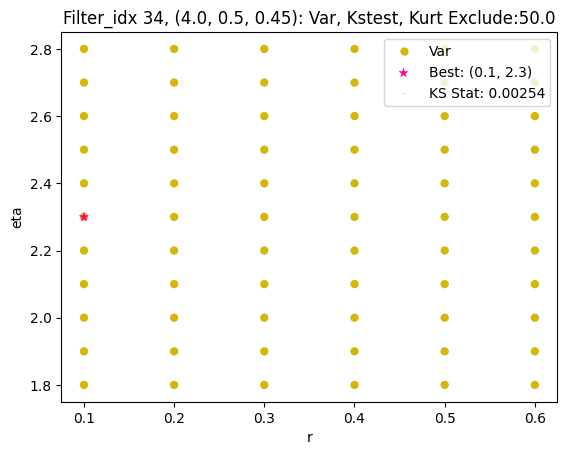

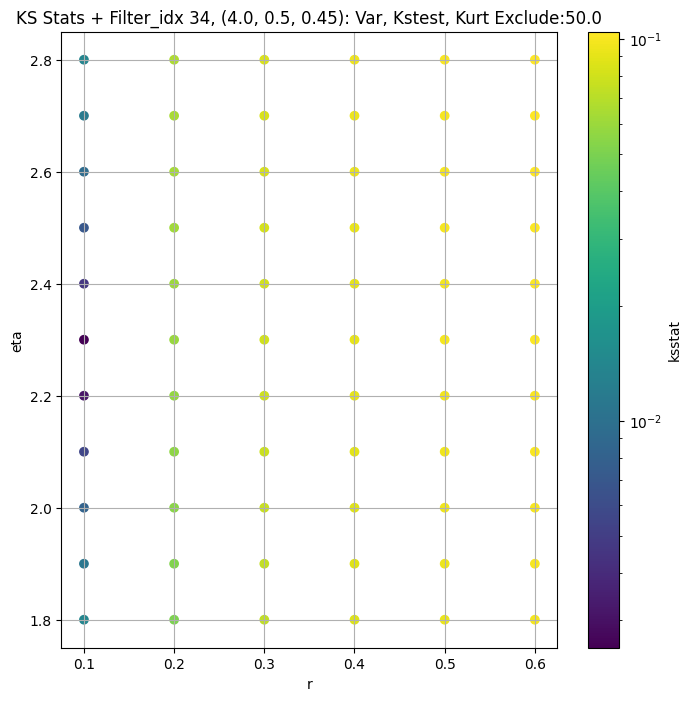

####
Filter_idx, 35: (4.0, 1.0, 0.044)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
35 0 0.007170651448974774 143.78783


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
35 50 0.006235851470641929 133.00307


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
35 100 0.00589133634210337 127.51908


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
35 200 0.005857326503732274 119.65864
Number of samples: 100000, Without approximation : 160000000.0


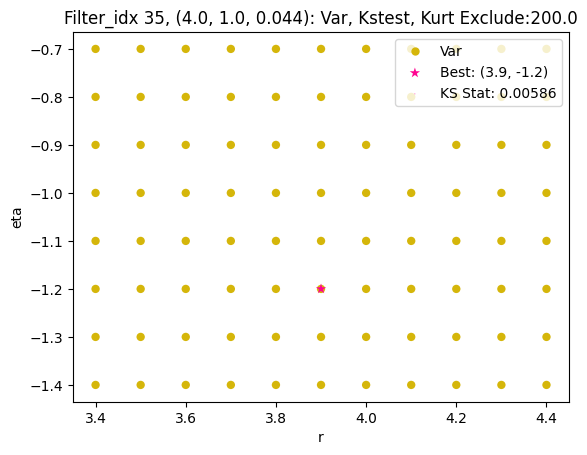

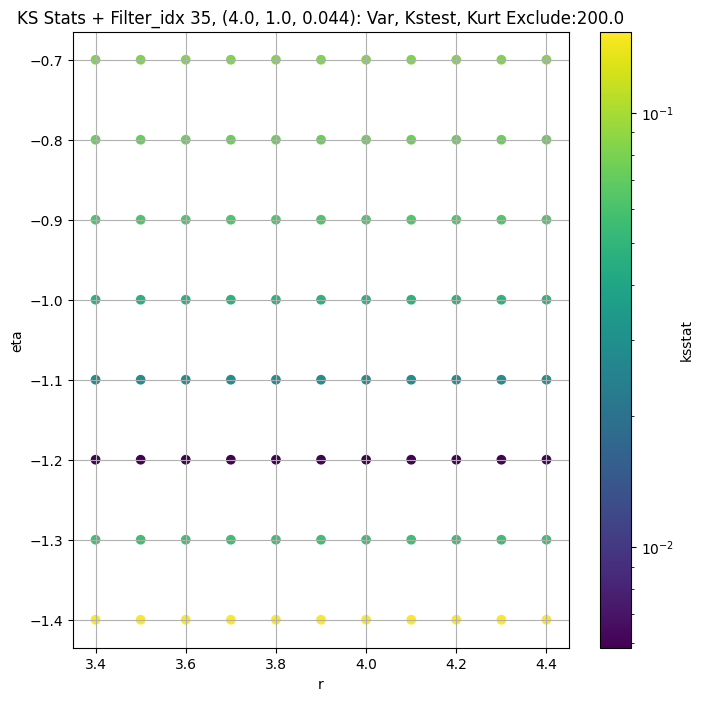

####
Filter_idx, 36: (4.0, 1.0, 0.065)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
36 0 0.007162301232811807 60.048054


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
36 50 0.007417353811783045 55.31955


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
36 100 0.007063006258577864 52.94735


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
36 200 0.007329295374648659 49.50486
Number of samples: 100000, Without approximation : 160000000.0


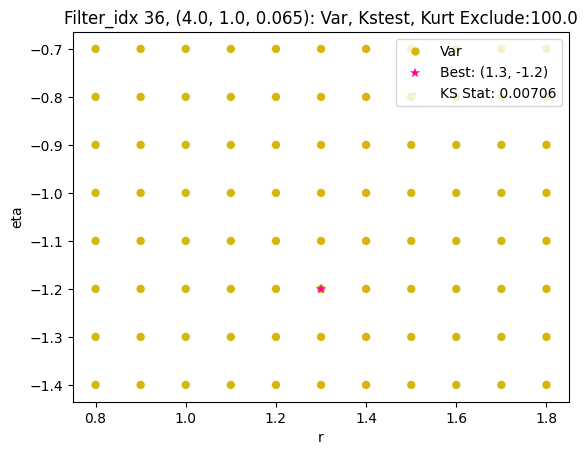

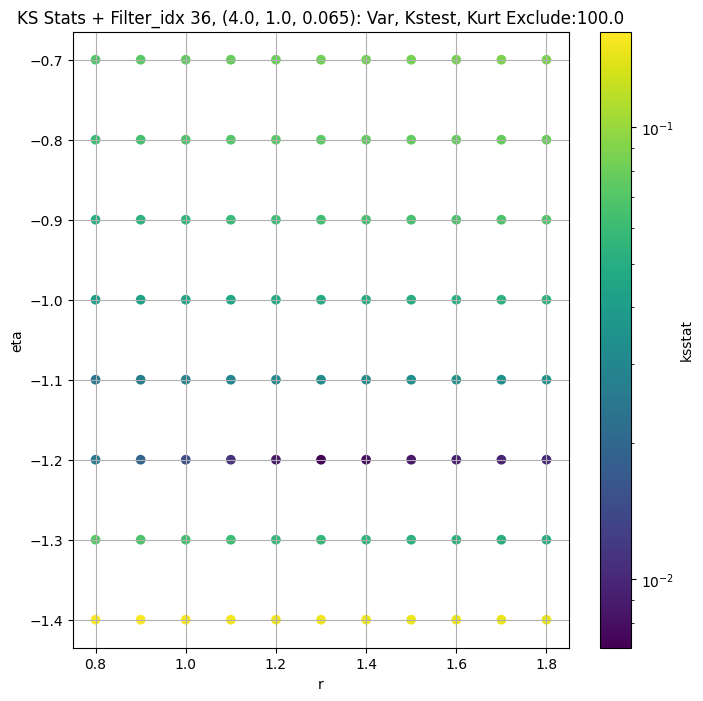

####
Filter_idx, 37: (4.0, 1.0, 0.096)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
37 0 0.010170668669857164 24.948524


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
37 50 0.009430210301524133 22.411337


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
37 100 0.009565458191261644 21.249126


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
37 200 0.00948890108433842 19.605421
Number of samples: 100000, Without approximation : 160000000.0


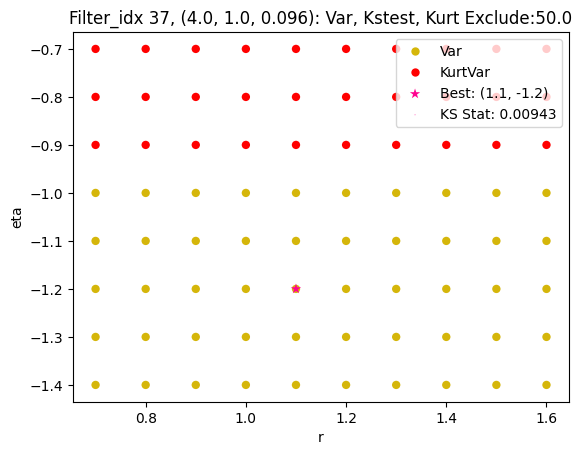

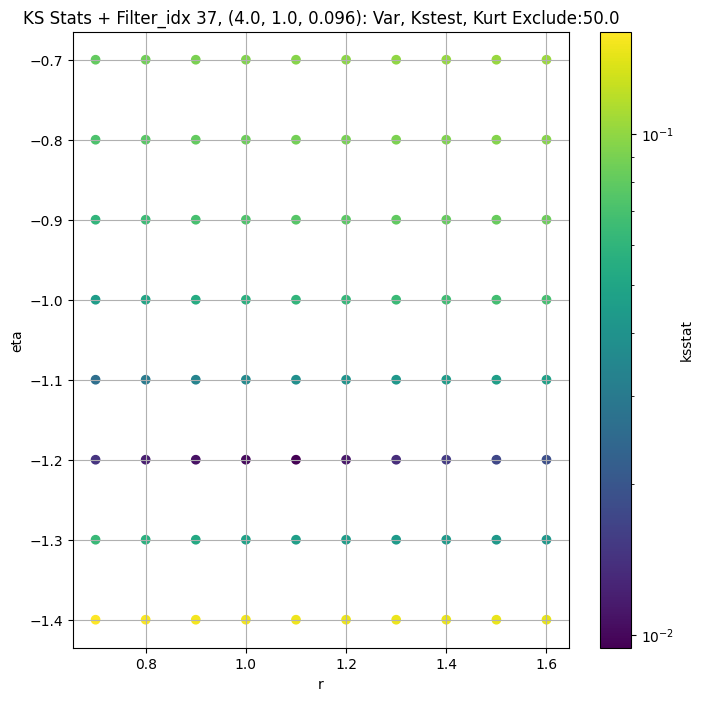

####
Filter_idx, 38: (4.0, 1.0, 0.141)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
38 0 0.00790112835196144 10.362214


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
38 50 0.00879774081703022 9.073264


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
38 100 0.010387172997142202 8.534441


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
38 200 0.008733979915924117 7.809192
Number of samples: 100000, Without approximation : 160000000.0


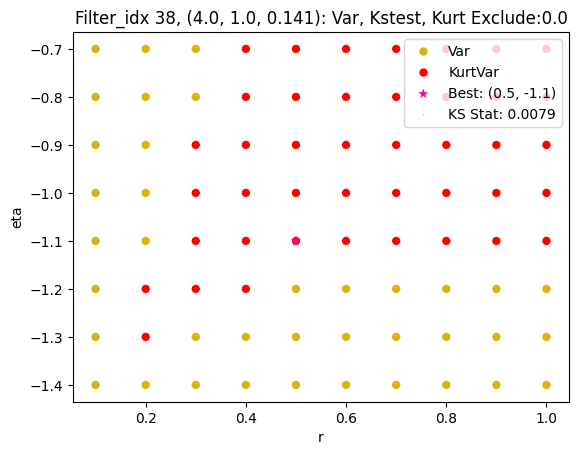

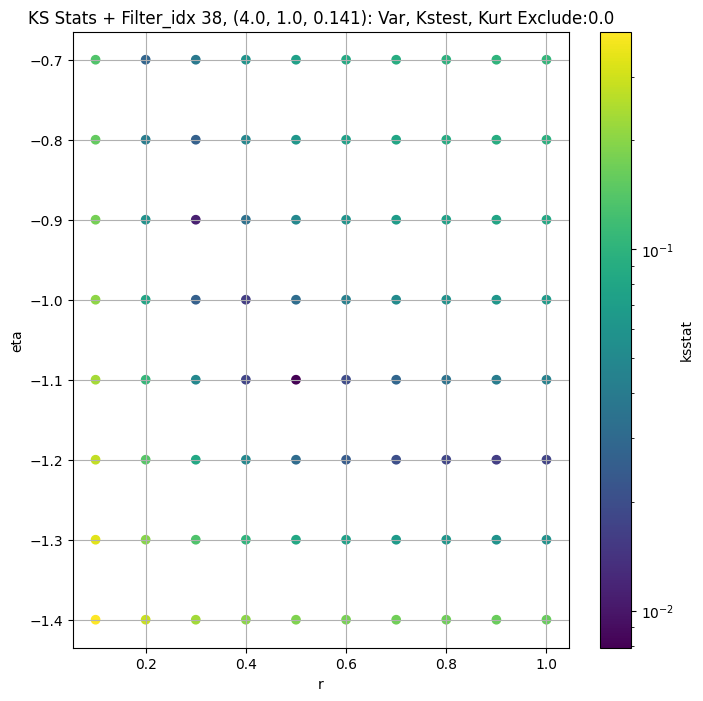

####
Filter_idx, 39: (4.0, 1.0, 0.208)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
39 0 0.00995515955214743 4.0852532


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
39 50 0.010066604916510846 3.4587708


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
39 100 0.009694340824343062 3.2281168


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
39 200 0.011410570275936838 2.924422
Number of samples: 100000, Without approximation : 160000000.0


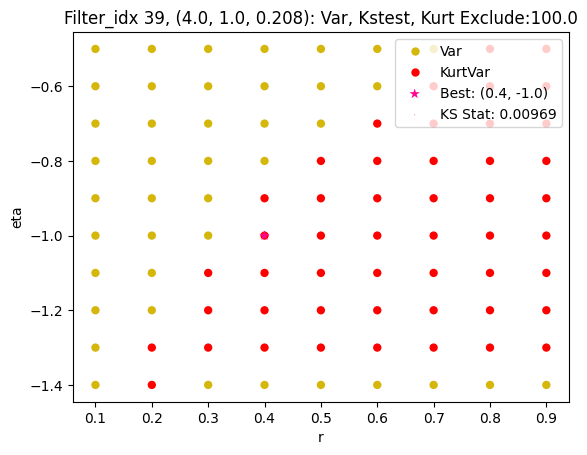

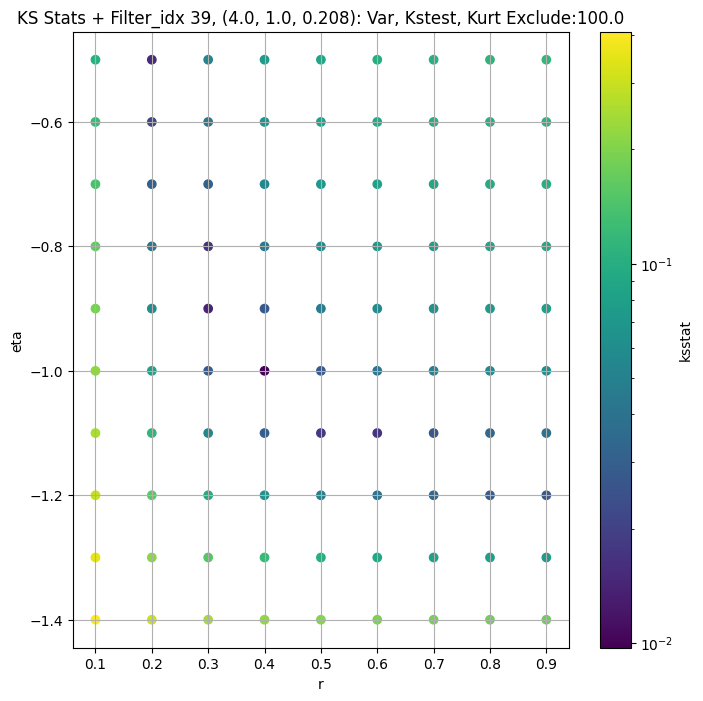

####
Filter_idx, 40: (4.0, 1.0, 0.306)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
40 0 0.005395352617337146 1.3246607


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
40 50 0.006064398774056318 1.1020954


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
40 100 0.006261741210362715 1.0240422


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
40 200 0.006302464465345992 0.9234935
Number of samples: 100000, Without approximation : 160000000.0


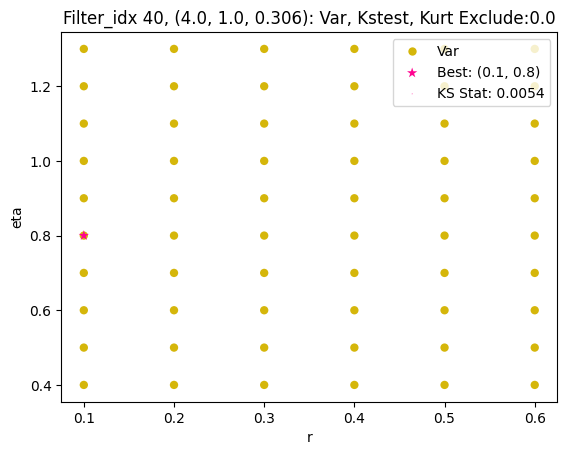

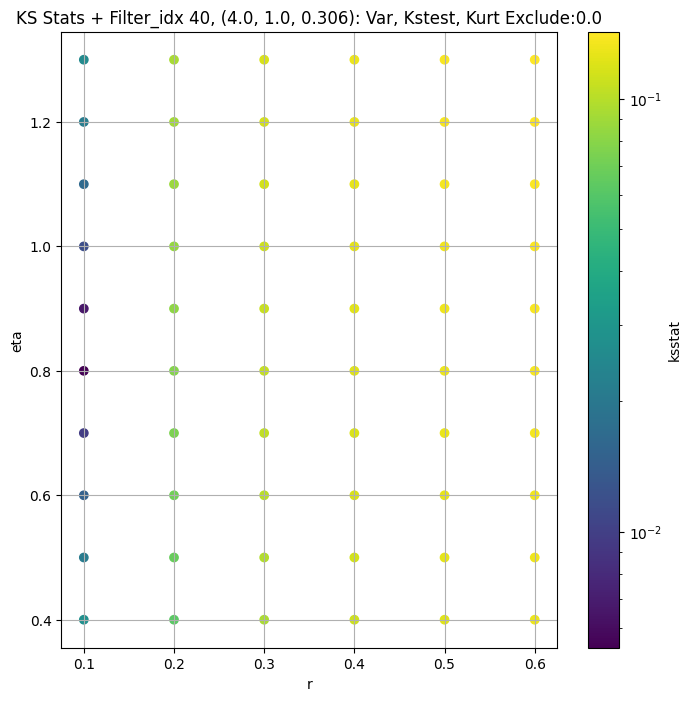

####
Filter_idx, 41: (4.0, 1.0, 0.45)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
41 0 0.004905426100037413 0.39251098


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
41 50 0.002491199991633032 0.3166896


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
41 100 0.004243995054403045 0.2961475


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
41 200 0.005351526155516373 0.27014956
Number of samples: 100000, Without approximation : 160000000.0


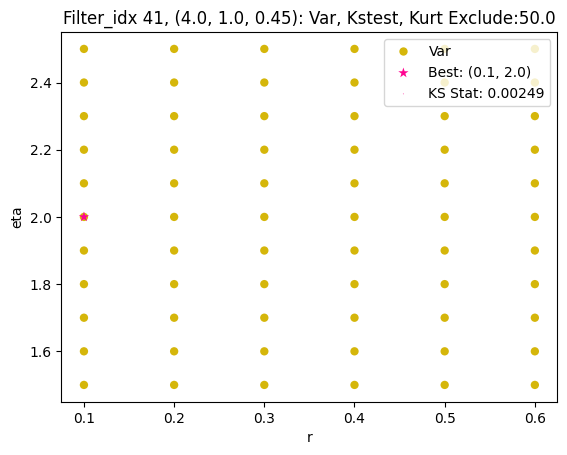

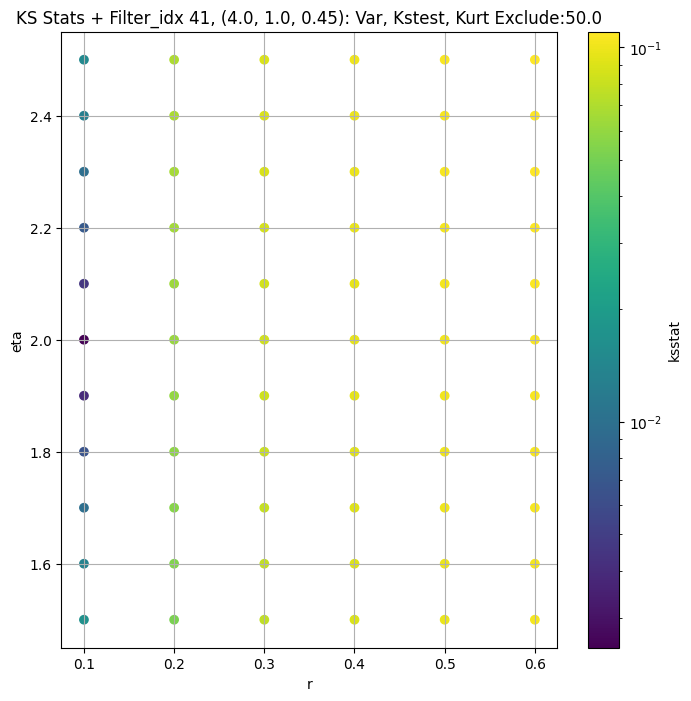

,params,obs_var,var_lower,var_upper,obs_kurt,kurt_lower,kurt_upper,total_samples,filter_group,kstest_stat_initial,initial_r,initial_eta,initial_scale,initial_exclude_cutoff,best_augmented_var,kstest_stat_cutoff_0.05
filter_idx,,,,,,,,,,,,,,,,
0,"(2.0, 0.5, 0.044)",137.924240,103.933060,192.941470,10.131069,3.520477,63.653420,160000000.0,"(2.0, 0.5, 0.044)",0.011901,20.0,-1.2,6.132156e+02,0.0,137.924240,0.000107
1,"(2.0, 0.5, 0.065)",53.987360,40.135403,79.578384,16.350359,4.161812,131.825700,160000000.0,"(2.0, 0.5, 0.065)",0.008258,1.7,-1.2,2.158856e+02,50.0,49.697327,0.000107
2,"(2.0, 0.5, 0.096)",25.048847,18.085354,38.104233,21.830307,5.088109,153.020650,160000000.0,"(2.0, 0.5, 0.096)",0.008892,2.1,-1.2,9.099460e+01,200.0,20.109010,0.000107
3,"(2.0, 0.5, 0.141)",9.881065,6.770121,17.732750,29.032230,6.329034,168.213910,160000000.0,"(2.0, 0.5, 0.141)",0.008408,0.5,-1.1,6.861851e+00,0.0,9.881065,0.000107
4,"(2.0, 0.5, 0.208)",3.735418,2.428868,7.642767,42.469220,7.384008,291.323900,160000000.0,"(2.0, 0.5, 0.208)",0.008497,0.3,-0.8,5.651842e-02,50.0,3.258897,0.000107
5,"(2.0, 0.5, 0.306)",1.113347,0.712703,2.480918,55.986454,6.268856,333.466580,160000000.0,"(2.0, 0.5, 0.306)",0.005150,0.1,1.1,1.671259e-15,0.0,1.113347,0.000107
6,"(2.0, 0.5, 0.45)",0.716896,0.469471,1.796280,62.759920,6.502224,366.028630,160000000.0,"(2.0, 0.5, 0.45)",0.002688,0.1,1.3,5.671552e-16,0.0,0.716896,0.000107
7,"(2.0, 1.0, 0.044)",182.940160,139.642330,257.175230,11.653064,3.985817,86.649550,160000000.0,"(2.0, 1.0, 0.044)",0.007813,6.3,-1.2,7.876375e+02,50.0,170.917420,0.000107
8,"(2.0, 1.0, 0.065)",73.881040,54.992100,108.218670,12.884755,4.084681,82.376310,160000000.0,"(2.0, 1.0, 0.065)",0.007246,1.9,-1.2,3.057241e+02,50.0,68.676460,0.000107


In [12]:
master_df_combo_path = Path(os.path.join(CWD, "CSVs", "master_df_combo.csv"))
rEtaKsstats_dict_path = Path(os.path.join(CWD, "cache", "rEtaKsstats_dict.pickle"))

rEtaKsstats_dict = dict()

if RERUN or not master_df_combo_path.exists():
    sorted_params = sorted(all_cdfs)
    ksstats_dict = dict()

    for i, group in enumerate(GROUPS): # TODO For quick testing purposes
        print(f"####\n{GROUP.capitalize()}, {group}: {str(filter_group_map[group])}")
        sample = group_data_map[group]
        if len(sample) == 0:
            continue
        group_cdfs_df = all_cdfs_df.copy()
        master_df.loc[group, 'kstest_stat_initial'] = 1

        for j in range(len(EXCLUDE_CUTOFFS)):

            exclude_cutoff = EXCLUDE_CUTOFFS[j]
            exclude_cutoff = int(exclude_cutoff)

            if exclude_cutoff == 0:
                augmented_var = np.var(group_data_map[group]) 
            else:
                augmented_var = np.var(group_data_map[group][exclude_cutoff:-exclude_cutoff])
                if augmented_var == np.var(group_data_map[group]):
                    continue 
                
            group_cdfs_df['scale'] = np.clip((augmented_var / group_cdfs_df['variance']), 0,  SCALE_CAP)
            ksstats, initial_param, min_stat = gridsearch(sample, all_cdfs, debug=True, scales=group_cdfs_df['scale'])
            augmented_var_df.loc[group, f"kstest_stat_{exclude_cutoff}"] = min_stat
            group_cdfs_df[f'ksstat_exclude_{exclude_cutoff}'] = ksstats
            
            print(group, exclude_cutoff, min_stat, augmented_var)
            
            if (min_stat < master_df.loc[group, 'kstest_stat_initial']) and not np.isclose(min_stat, master_df.loc[group, 'kstest_stat_initial'], 1e-6):
                inital_min_stat = min_stat
                inital_best_param = initial_param
                master_df.loc[group, 'kstest_stat_initial'] = min_stat
                initial_scale = group_cdfs_df.loc[(group_cdfs_df["r"] ==  initial_param[0]) & (group_cdfs_df["eta"] ==  initial_param[1])]["scale"].iloc[0]
                master_df.loc[group, 'initial_r'], master_df.loc[group, 'initial_eta'] = initial_param
                master_df.loc[group, 'initial_scale'] = initial_scale
                master_df.loc[group, 'initial_exclude_cutoff'] = exclude_cutoff
                master_df.loc[group, 'best_augmented_var'] = augmented_var
        
        ksstats = group_cdfs_df[f"ksstat_exclude_{int(master_df.loc[group, 'initial_exclude_cutoff'])}"]
            
        print(f"Number of samples: {sample.size}, Without approximation : {master_df.loc[group, 'total_samples']}")
        
        cutoff = stats.kstwo(n=master_df.loc[group, 'total_samples']).isf(0.05)
        master_df.loc[group, 'kstest_stat_cutoff_0.05'] = cutoff

        best_scales = np.clip((master_df.loc[group, 'best_augmented_var'] / group_cdfs_df['variance']), 0,  SCALE_CAP)

        group_cdfs_df['variance'] = group_cdfs_df['variance'] * best_scales
        group_cdfs_df['kurtosis'] = group_cdfs_df['kurtosis'] * best_scales

        group_cdfs_df = add_tests_to_df(cdfs_df = group_cdfs_df, group = group, var_kurt_df = master_df, ksstats = ksstats).sort_values(['r', 'eta'])

        group_dict = {'r' : group_cdfs_df['r'], 'eta' : group_cdfs_df['eta']}
        group_dict.update({f'ksstat_exclude_{exclude_cutoff}' : group_cdfs_df[f'ksstat_exclude_{exclude_cutoff}'] for exclude_cutoff in EXCLUDE_CUTOFFS[:j+1]})
        rEtaKsstats_dict[group] = group_dict

        cols = ['pass_var', 'pass_kstest', 'pass_kurt']

        fig = combo_test_plot(group_cdfs_df, cols, 
                            plot_name=f"{GROUP.capitalize()} {group}, {str(filter_group_map[group])}: {', '.join([col[5:].capitalize() for col in cols])} Exclude:{master_df.loc[group, 'initial_exclude_cutoff']}", 
                            target_var = None,
                            best_param = inital_best_param,
                            best_ksstat=inital_min_stat
                            )
        
        fig.figure.savefig(os.path.join(CWD, "plots", f"full_grid_search_combo_plot_layer{group}.jpg"), bbox_inches = 'tight', dpi=100)

        # Optional: 
        # Create plots of bootstrapped variance and kurtosis for varying confidence intervals
        # fig_var = create_ci_scatter_plot(group_cdfs_df, var_values_dict, metric='variance', group=group)
        # fig_kurt = create_ci_scatter_plot(group_cdfs_df, kurt_values_dict, metric='kurtosis', group=group)

        # fig_var.savefig(os.path.join(CWD, "plots", f"ci_scatter_variance_{GROUP}_{group}_bootstrap{n_bootstrap}.jpg"), bbox_inches='tight')
        # plt.close(fig_var)
        # fig_kurt.savefig(os.path.join(CWD, "plots", f"ci_scatter_variance_{GROUP}_{group}_bootstrap{n_bootstrap}.jpg"), bbox_inches='tight')
        # plt.close(fig_kurt)

    # new: add parameter information
    master_df.insert(0, 'params', master_df.index.map(filter_group_map))

    master_df.to_csv(master_df_combo_path)
    pd.to_pickle(rEtaKsstats_dict, rEtaKsstats_dict_path)
    augmented_var_df.to_csv(augmented_var_df_path)

augmented_var_df = pd.read_csv(augmented_var_df_path, index_col=GROUP)
master_df = pd.read_csv(master_df_combo_path, index_col=GROUP)
rEtaKsstats_dict = pd.read_pickle(rEtaKsstats_dict_path)
master_df

## Optimization

In [13]:
master_df['kstest_stat_best'] = master_df['kstest_stat_initial']
master_df[f'best_r'] = master_df['initial_r']
master_df[f'best_eta'] = master_df['initial_eta']
master_df[f'best_scale'] = master_df['initial_scale']
master_df[f'best_exclude_cutoff'] = master_df['initial_exclude_cutoff']

Filter_idx 0, (2.0, 0.5, 0.044):


  0%|          | 0/7 [00:00<?, ?it/s]

Finding Minimum after computing 7 CDFs
filter_idx 0, 0.0 + 100 = 100, ksstat: 0.016187485425409986, var: 124.7607421875


  0%|          | 0/7 [00:00<?, ?it/s]

Finding Minimum after computing 7 CDFs
filter_idx 0, 0.0 + 75 = 75, ksstat: 0.01544323281657084, var: 126.89239501953125


  0%|          | 0/7 [00:00<?, ?it/s]

Finding Minimum after computing 7 CDFs
filter_idx 0, 0.0 + 50 = 50, ksstat: 0.014606769336856396, var: 129.3533477783203


  0%|          | 0/7 [00:00<?, ?it/s]

Finding Minimum after computing 7 CDFs
filter_idx 0, 0.0 + 25 = 25, ksstat: 0.013612887237327675, var: 132.3909149169922


  0%|          | 0/7 [00:00<?, ?it/s]

Finding Minimum after computing 7 CDFs
filter_idx 0, 0.0 + 0 = 0, ksstat: 0.01190073571732475, var: 137.9242401123047
Number of samples: 100000, Without approximation : 160000000.0


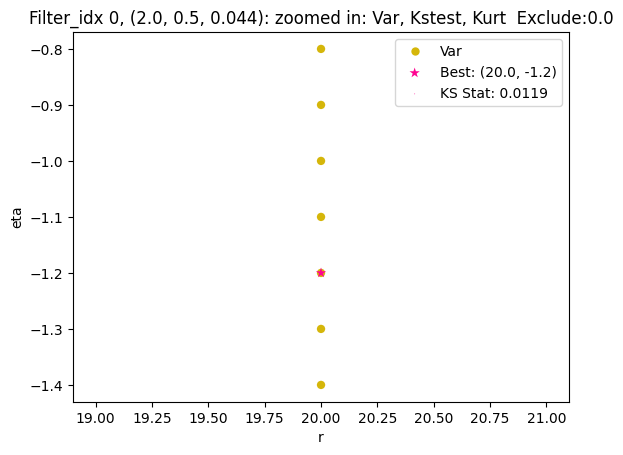

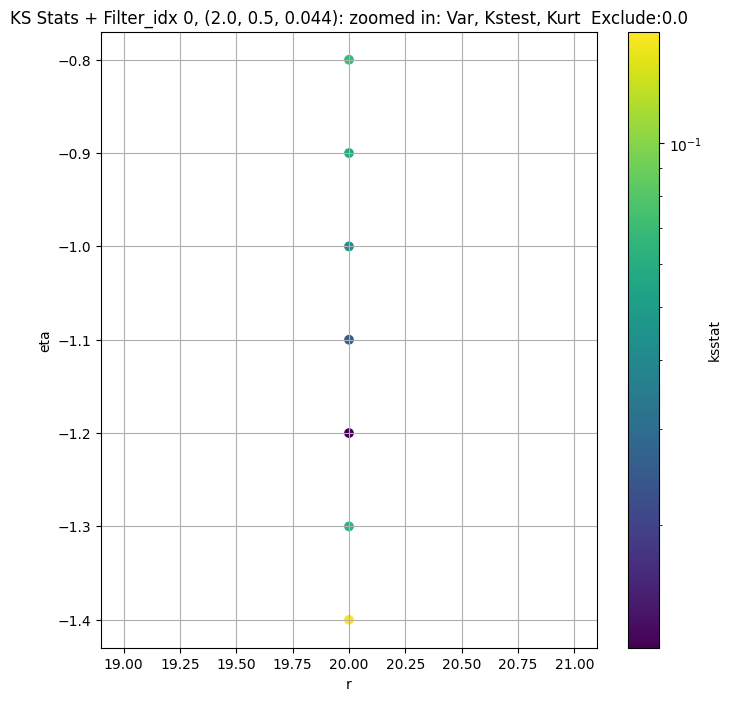

Filter_idx 1, (2.0, 0.5, 0.065):


  0%|          | 0/1111 [00:00<?, ?it/s]

Finding Minimum after computing 1111 CDFs
filter_idx 1, 50.0 + 100 = 150, ksstat: 0.008687093238134713, var: 46.10788345336914


  0%|          | 0/1111 [00:00<?, ?it/s]

Finding Minimum after computing 1111 CDFs
filter_idx 1, 50.0 + 75 = 125, ksstat: 0.008429394808203428, var: 46.85465621948242


  0%|          | 0/1111 [00:00<?, ?it/s]

Finding Minimum after computing 1111 CDFs
filter_idx 1, 50.0 + 50 = 100, ksstat: 0.00824936037516033, var: 47.67844009399414


  0%|          | 0/1111 [00:00<?, ?it/s]

Finding Minimum after computing 1111 CDFs
filter_idx 1, 50.0 + 25 = 75, ksstat: 0.00821596404464997, var: 48.608070373535156


  0%|          | 0/1111 [00:00<?, ?it/s]

Finding Minimum after computing 1111 CDFs
filter_idx 1, 50.0 + 0 = 50, ksstat: 0.00816878008269395, var: 49.69732666015625


  0%|          | 0/1111 [00:00<?, ?it/s]

Finding Minimum after computing 1111 CDFs
filter_idx 1, 50.0 + -25 = 25, ksstat: 0.008137383816956556, var: 51.081356048583984


  0%|          | 0/1111 [00:00<?, ?it/s]

Finding Minimum after computing 1111 CDFs
filter_idx 1, 50.0 + -50 = 0, ksstat: 0.008040327287561544, var: 53.98735809326172
Number of samples: 100000, Without approximation : 160000000.0


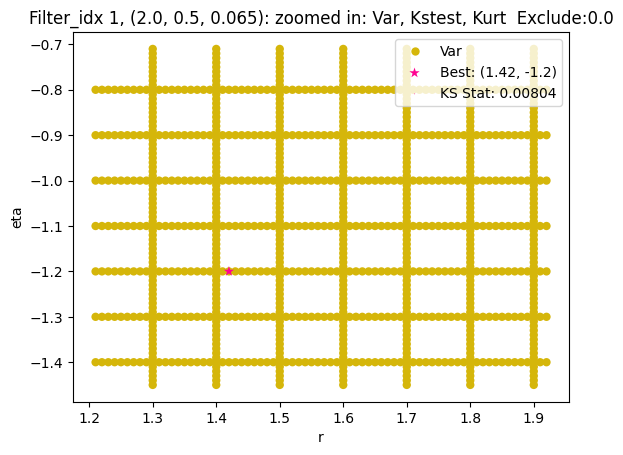

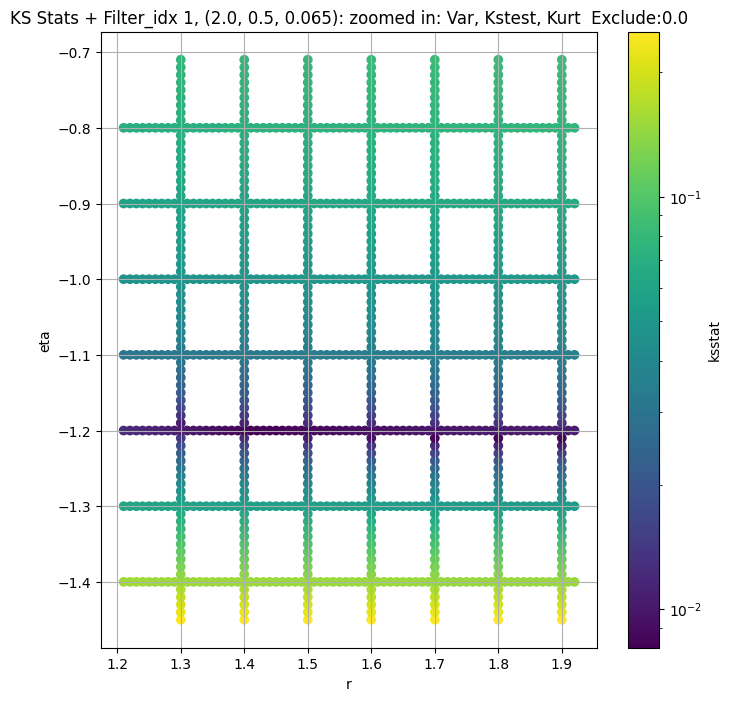

Filter_idx 2, (2.0, 0.5, 0.096):


  0%|          | 0/587 [00:00<?, ?it/s]

Finding Minimum after computing 587 CDFs
filter_idx 2, 200.0 + 100 = 300, ksstat: 0.008963664481401068, var: 18.979637145996094


  0%|          | 0/587 [00:00<?, ?it/s]

Finding Minimum after computing 587 CDFs
filter_idx 2, 200.0 + 75 = 275, ksstat: 0.00887702830969428, var: 19.238866806030273


  0%|          | 0/587 [00:00<?, ?it/s]

Finding Minimum after computing 587 CDFs
filter_idx 2, 200.0 + 50 = 250, ksstat: 0.008849215230622987, var: 19.512073516845703


  0%|          | 0/587 [00:00<?, ?it/s]

Finding Minimum after computing 587 CDFs
filter_idx 2, 200.0 + 25 = 225, ksstat: 0.00890243931589163, var: 19.8012638092041


  0%|          | 0/587 [00:00<?, ?it/s]

Finding Minimum after computing 587 CDFs
filter_idx 2, 200.0 + 0 = 200, ksstat: 0.008891948613127698, var: 20.109010696411133


  0%|          | 0/587 [00:00<?, ?it/s]

Finding Minimum after computing 587 CDFs
filter_idx 2, 200.0 + -25 = 175, ksstat: 0.008898537154489128, var: 20.43876075744629


  0%|          | 0/587 [00:00<?, ?it/s]

Finding Minimum after computing 587 CDFs
filter_idx 2, 200.0 + -50 = 150, ksstat: 0.008867400213287802, var: 20.79503059387207


  0%|          | 0/587 [00:00<?, ?it/s]

Finding Minimum after computing 587 CDFs
filter_idx 2, 200.0 + -75 = 125, ksstat: 0.008870051434448079, var: 21.18436050415039


  0%|          | 0/587 [00:00<?, ?it/s]

Finding Minimum after computing 587 CDFs
filter_idx 2, 200.0 + -100 = 100, ksstat: 0.00887787483878888, var: 21.61678123474121
Number of samples: 100000, Without approximation : 160000000.0


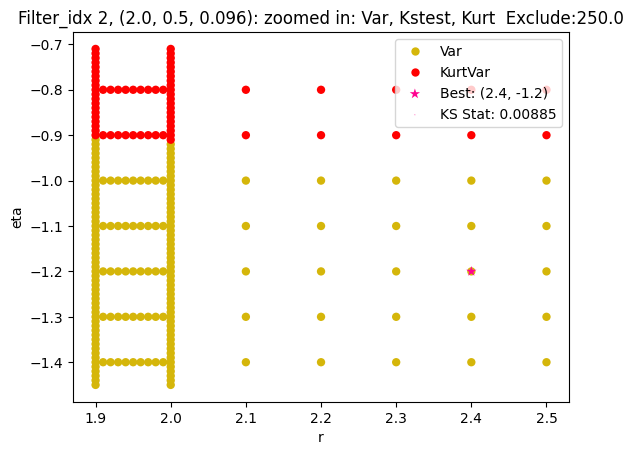

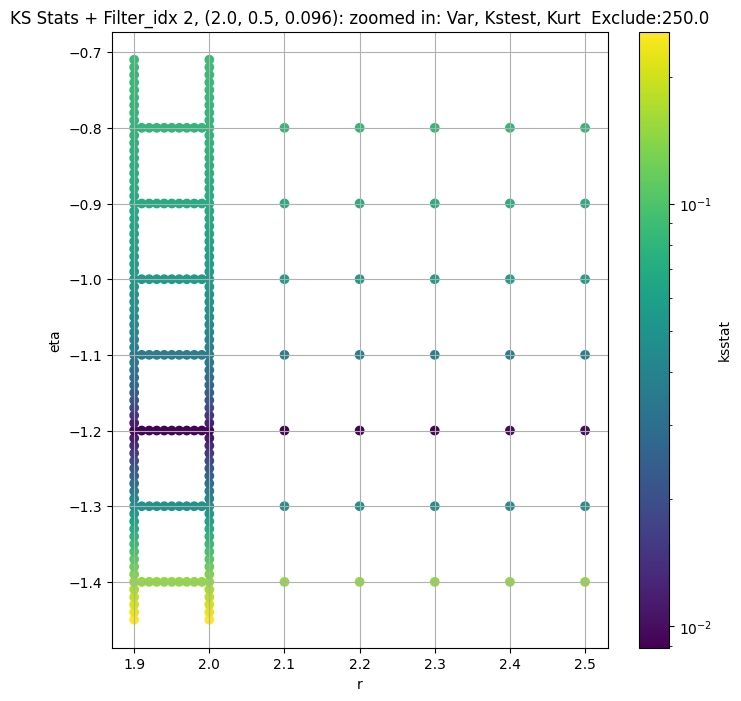

Filter_idx 3, (2.0, 0.5, 0.141):


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 3, 0.0 + 100 = 100, ksstat: 0.008281416284859011, var: 8.330952644348145


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 3, 0.0 + 75 = 75, ksstat: 0.008178179213940429, var: 8.551095008850098


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 3, 0.0 + 50 = 50, ksstat: 0.007874980611794868, var: 8.813172340393066


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 3, 0.0 + 25 = 25, ksstat: 0.0076227109423757655, var: 9.151769638061523


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 3, 0.0 + 0 = 0, ksstat: 0.007738183116116404, var: 9.881065368652344
Number of samples: 100000, Without approximation : 160000000.0


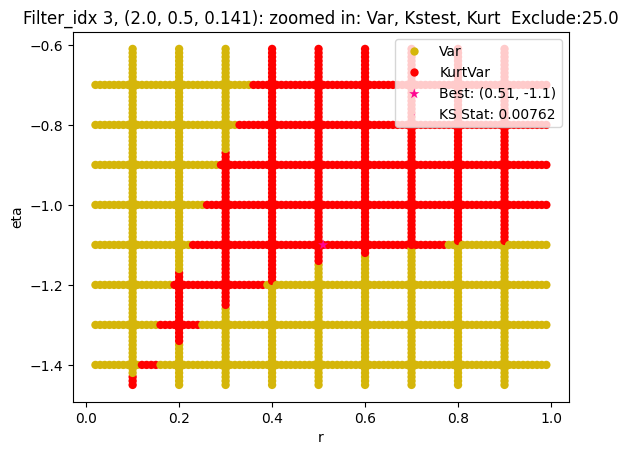

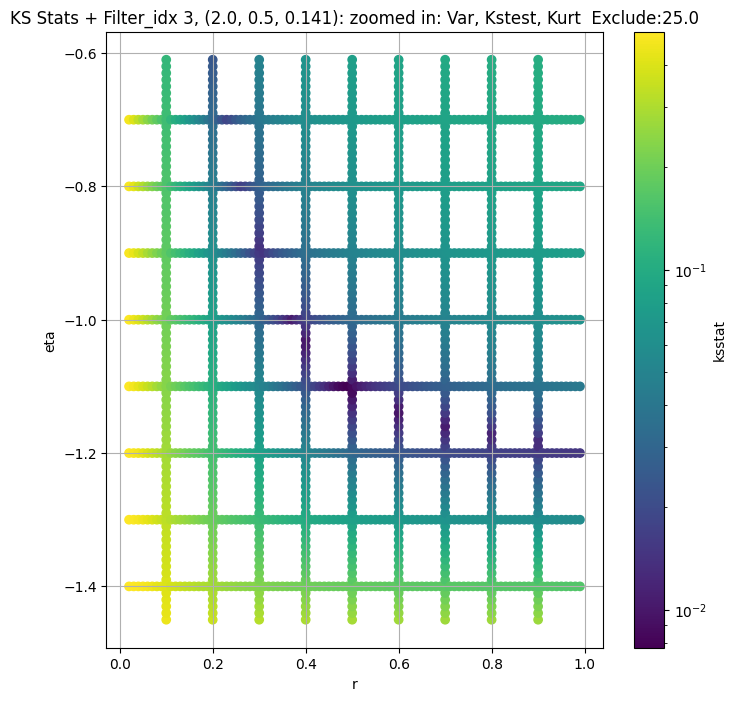

Filter_idx 4, (2.0, 0.5, 0.208):


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 4, 50.0 + 100 = 150, ksstat: 0.007772272245084033, var: 2.9152133464813232


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 4, 50.0 + 75 = 125, ksstat: 0.0071494950990841355, var: 2.9838919639587402


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 4, 50.0 + 50 = 100, ksstat: 0.007488456621210893, var: 3.061288833618164


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 4, 50.0 + 25 = 75, ksstat: 0.00681330591317042, var: 3.15079927444458


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 4, 50.0 + 0 = 50, ksstat: 0.006447660891544818, var: 3.258897542953491


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 4, 50.0 + -25 = 25, ksstat: 0.006955656617029238, var: 3.4014251232147217


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 4, 50.0 + -50 = 0, ksstat: 0.0060700393381099005, var: 3.735417604446411
Number of samples: 100000, Without approximation : 160000000.0


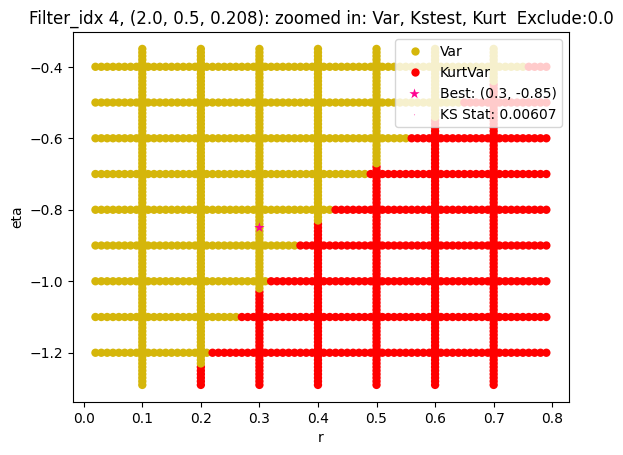

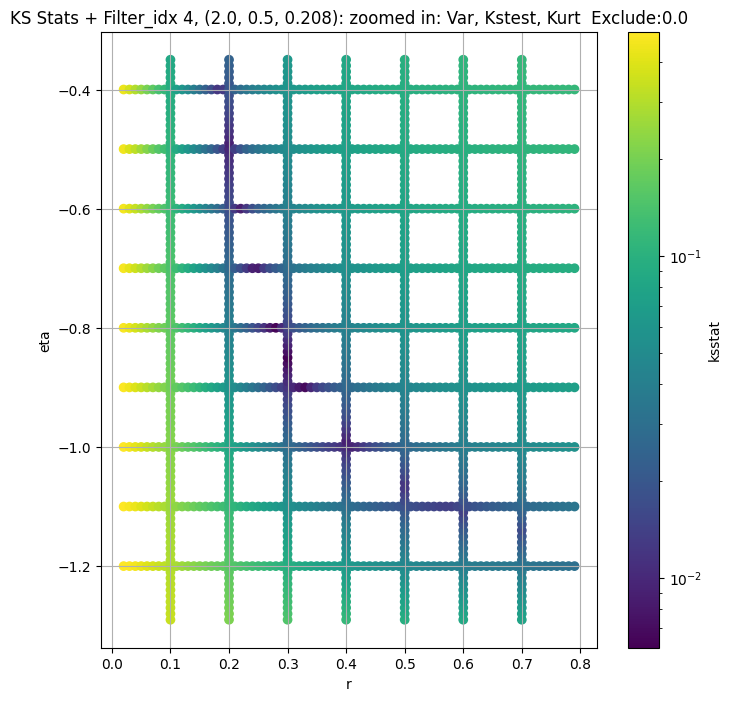

Filter_idx 5, (2.0, 0.5, 0.306):


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 5, 0.0 + 100 = 100, ksstat: 0.008874185666704781, var: 0.9030214548110962


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 5, 0.0 + 75 = 75, ksstat: 0.007545826894065424, var: 0.9296560287475586


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 5, 0.0 + 50 = 50, ksstat: 0.007644104586627565, var: 0.9619271755218506


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 5, 0.0 + 25 = 25, ksstat: 0.00635194878406431, var: 1.0046521425247192


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 5, 0.0 + 0 = 0, ksstat: 0.004791644479363588, var: 1.1133471727371216
Number of samples: 100000, Without approximation : 160000000.0


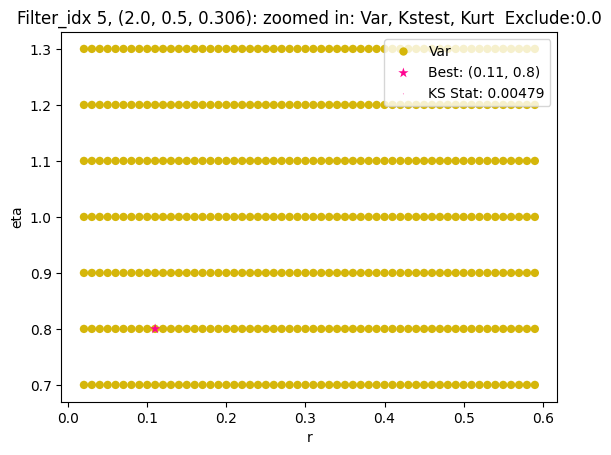

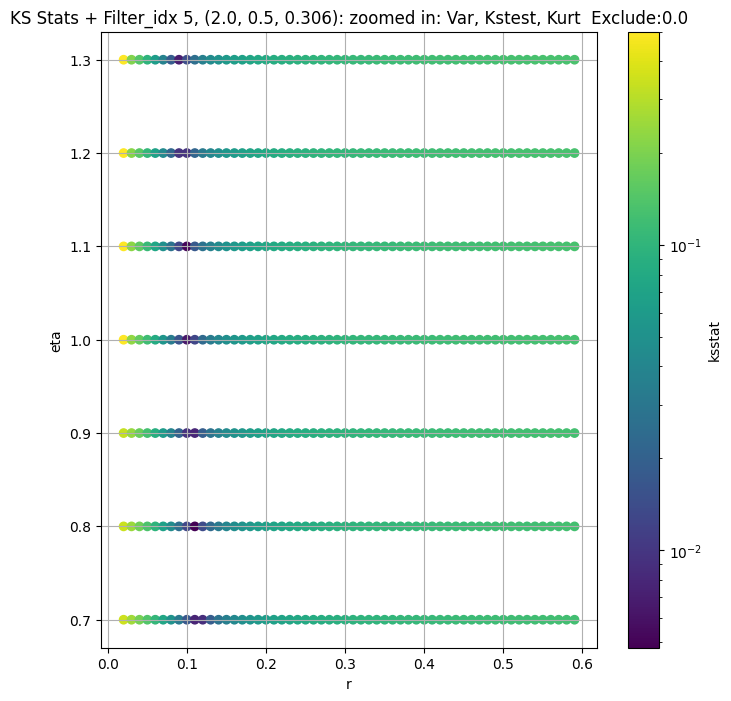

Filter_idx 6, (2.0, 0.5, 0.45):


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 6, 0.0 + 100 = 100, ksstat: 0.006527381024319601, var: 0.5804233551025391


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 6, 0.0 + 75 = 75, ksstat: 0.0063207613002717045, var: 0.5971362590789795


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 6, 0.0 + 50 = 50, ksstat: 0.005381778080395638, var: 0.617403507232666


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 6, 0.0 + 25 = 25, ksstat: 0.004239296806942544, var: 0.6444104313850403


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 6, 0.0 + 0 = 0, ksstat: 0.0026880884918598635, var: 0.7168957591056824
Number of samples: 100000, Without approximation : 160000000.0


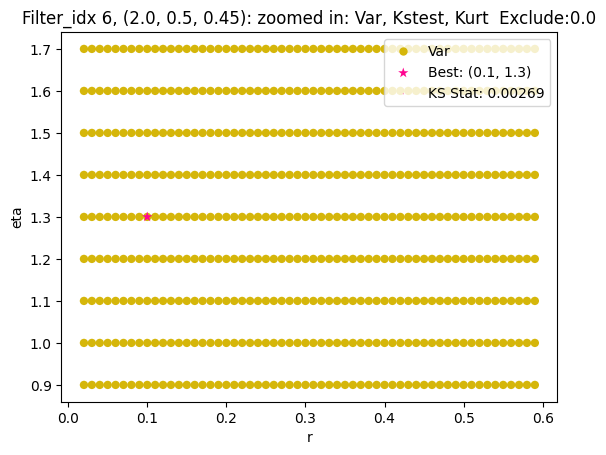

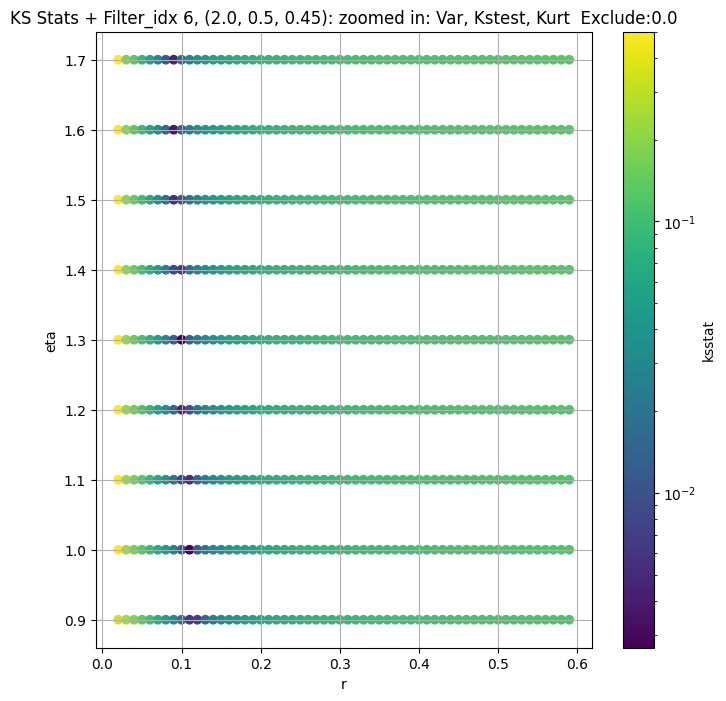

Filter_idx 7, (2.0, 1.0, 0.044):


  0%|          | 0/131 [00:00<?, ?it/s]

Finding Minimum after computing 131 CDFs
filter_idx 7, 50.0 + 100 = 150, ksstat: 0.009336637120681002, var: 159.54052734375


  0%|          | 0/131 [00:00<?, ?it/s]

Finding Minimum after computing 131 CDFs
filter_idx 7, 50.0 + 75 = 125, ksstat: 0.009551222096021661, var: 161.939453125


  0%|          | 0/131 [00:00<?, ?it/s]

Finding Minimum after computing 131 CDFs
filter_idx 7, 50.0 + 50 = 100, ksstat: 0.009267008227482276, var: 164.57139587402344


  0%|          | 0/131 [00:00<?, ?it/s]

Finding Minimum after computing 131 CDFs
filter_idx 7, 50.0 + 25 = 75, ksstat: 0.008519363800554403, var: 167.5172119140625


  0%|          | 0/131 [00:00<?, ?it/s]

Finding Minimum after computing 131 CDFs
filter_idx 7, 50.0 + 0 = 50, ksstat: 0.007813265248948875, var: 170.91741943359375


  0%|          | 0/131 [00:00<?, ?it/s]

Finding Minimum after computing 131 CDFs
filter_idx 7, 50.0 + -25 = 25, ksstat: 0.009191230747977633, var: 175.10166931152344


  0%|          | 0/131 [00:00<?, ?it/s]

Finding Minimum after computing 131 CDFs
filter_idx 7, 50.0 + -50 = 0, ksstat: 0.010792220984388007, var: 182.94015502929688
Number of samples: 100000, Without approximation : 160000000.0


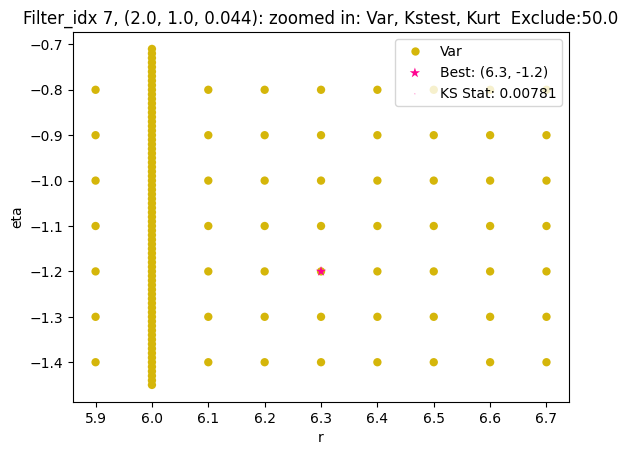

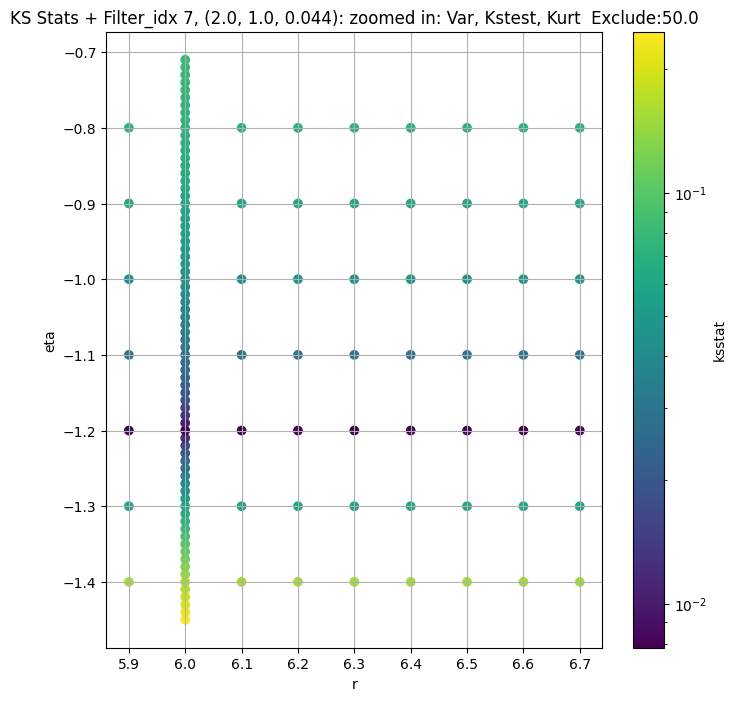

Filter_idx 8, (2.0, 1.0, 0.065):


  0%|          | 0/849 [00:00<?, ?it/s]

Finding Minimum after computing 849 CDFs
filter_idx 8, 50.0 + 100 = 150, ksstat: 0.007914495425514811, var: 63.92964553833008


  0%|          | 0/849 [00:00<?, ?it/s]

Finding Minimum after computing 849 CDFs
filter_idx 8, 50.0 + 75 = 125, ksstat: 0.007277423545906325, var: 64.9283218383789


  0%|          | 0/849 [00:00<?, ?it/s]

Finding Minimum after computing 849 CDFs
filter_idx 8, 50.0 + 50 = 100, ksstat: 0.007358918043911089, var: 66.02452850341797


  0%|          | 0/849 [00:00<?, ?it/s]

Finding Minimum after computing 849 CDFs
filter_idx 8, 50.0 + 25 = 75, ksstat: 0.007275723585211391, var: 67.25245666503906


  0%|          | 0/849 [00:00<?, ?it/s]

Finding Minimum after computing 849 CDFs
filter_idx 8, 50.0 + 0 = 50, ksstat: 0.007193565018962178, var: 68.67646026611328


  0%|          | 0/849 [00:00<?, ?it/s]

Finding Minimum after computing 849 CDFs
filter_idx 8, 50.0 + -25 = 25, ksstat: 0.007157118571928578, var: 70.44535827636719


  0%|          | 0/849 [00:00<?, ?it/s]

Finding Minimum after computing 849 CDFs
filter_idx 8, 50.0 + -50 = 0, ksstat: 0.007097807557757796, var: 73.88104248046875
Number of samples: 100000, Without approximation : 160000000.0


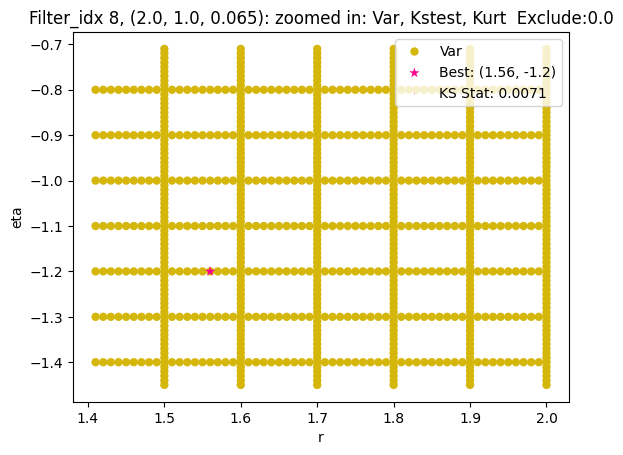

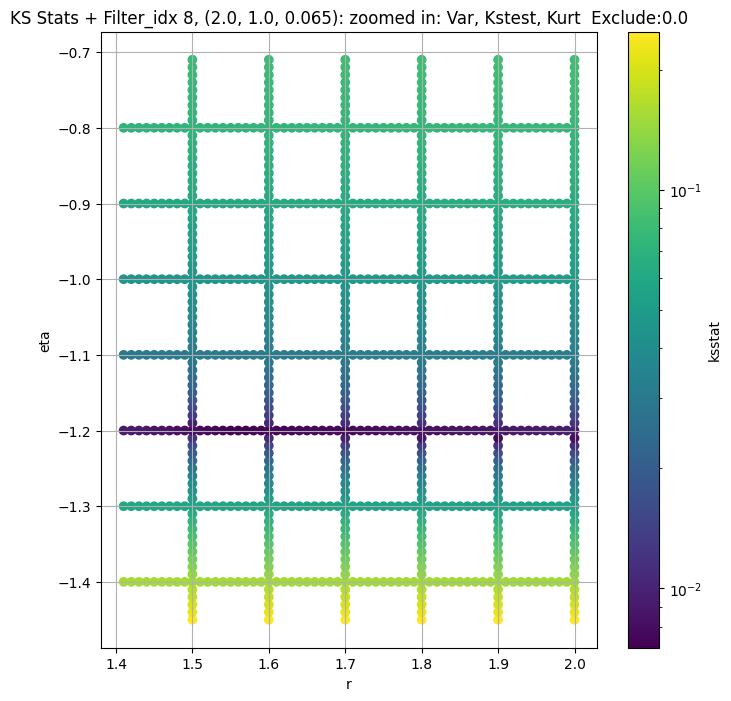

Filter_idx 9, (2.0, 1.0, 0.096):


  0%|          | 0/138 [00:00<?, ?it/s]

Finding Minimum after computing 138 CDFs
filter_idx 9, 200.0 + 100 = 300, ksstat: 0.008179130648249822, var: 25.12664031982422


  0%|          | 0/138 [00:00<?, ?it/s]

Finding Minimum after computing 138 CDFs
filter_idx 9, 200.0 + 75 = 275, ksstat: 0.008102809984626924, var: 25.453859329223633


  0%|          | 0/138 [00:00<?, ?it/s]

Finding Minimum after computing 138 CDFs
filter_idx 9, 200.0 + 50 = 250, ksstat: 0.008024173771265408, var: 25.798553466796875


  0%|          | 0/138 [00:00<?, ?it/s]

Finding Minimum after computing 138 CDFs
filter_idx 9, 200.0 + 25 = 225, ksstat: 0.007943129677133565, var: 26.163362503051758


  0%|          | 0/138 [00:00<?, ?it/s]

Finding Minimum after computing 138 CDFs
filter_idx 9, 200.0 + 0 = 200, ksstat: 0.007906583796826183, var: 26.551332473754883


  0%|          | 0/138 [00:00<?, ?it/s]

Finding Minimum after computing 138 CDFs
filter_idx 9, 200.0 + -25 = 175, ksstat: 0.008189289814169193, var: 26.966590881347656


  0%|          | 0/138 [00:00<?, ?it/s]

Finding Minimum after computing 138 CDFs
filter_idx 9, 200.0 + -50 = 150, ksstat: 0.00924162926449934, var: 27.414756774902344


  0%|          | 0/138 [00:00<?, ?it/s]

Finding Minimum after computing 138 CDFs
filter_idx 9, 200.0 + -75 = 125, ksstat: 0.009762343071850754, var: 27.9038143157959


  0%|          | 0/138 [00:00<?, ?it/s]

Finding Minimum after computing 138 CDFs
filter_idx 9, 200.0 + -100 = 100, ksstat: 0.010394343392280181, var: 28.44559097290039
Number of samples: 100000, Without approximation : 160000000.0


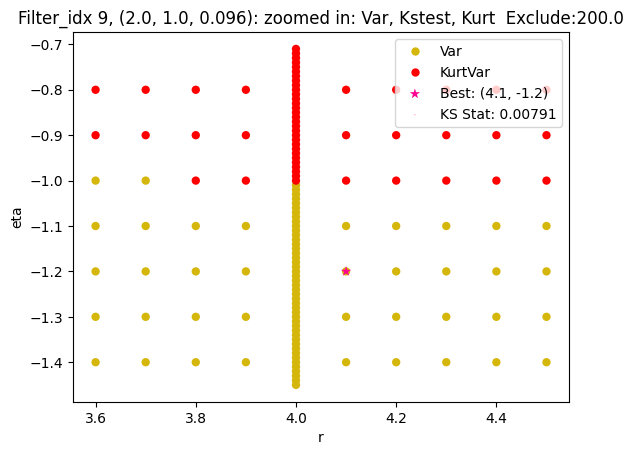

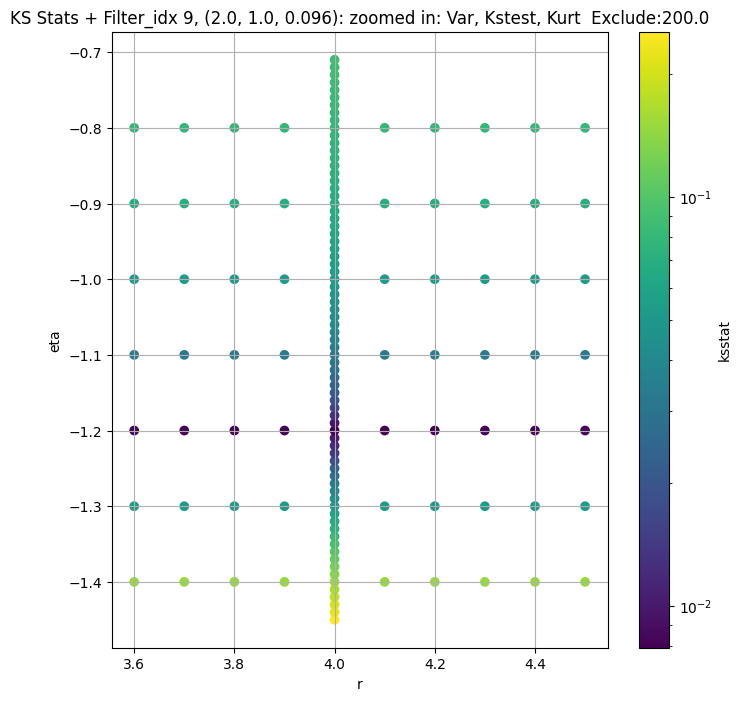

Filter_idx 10, (2.0, 1.0, 0.141):


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 10, 100.0 + 100 = 200, ksstat: 0.006880215614510354, var: 11.187623977661133


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 10, 100.0 + 75 = 175, ksstat: 0.006357326789985462, var: 11.38589859008789


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 10, 100.0 + 50 = 150, ksstat: 0.00678325409856928, var: 11.600677490234375


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 10, 100.0 + 25 = 125, ksstat: 0.007307091774570451, var: 11.83588981628418


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 10, 100.0 + 0 = 100, ksstat: 0.007152089840006787, var: 12.097318649291992


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 10, 100.0 + -25 = 75, ksstat: 0.0066964413622443986, var: 12.394734382629395


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 10, 100.0 + -50 = 50, ksstat: 0.006218049568811557, var: 12.746075630187988


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 10, 100.0 + -75 = 25, ksstat: 0.00636489099787918, var: 13.194293022155762


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 10, 100.0 + -100 = 0, ksstat: 0.005862905899893023, var: 14.108160972595215
Number of samples: 100000, Without approximation : 160000000.0


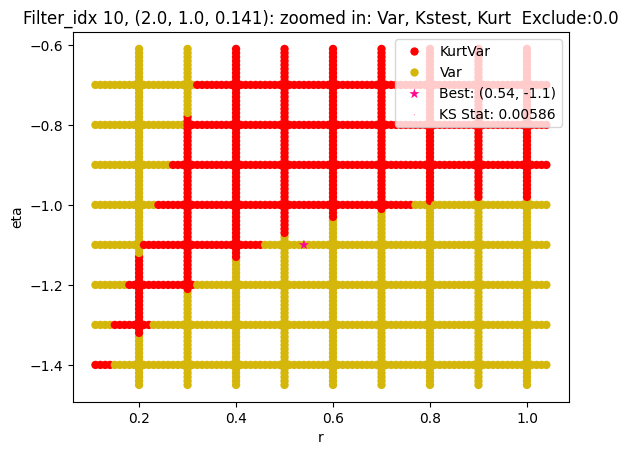

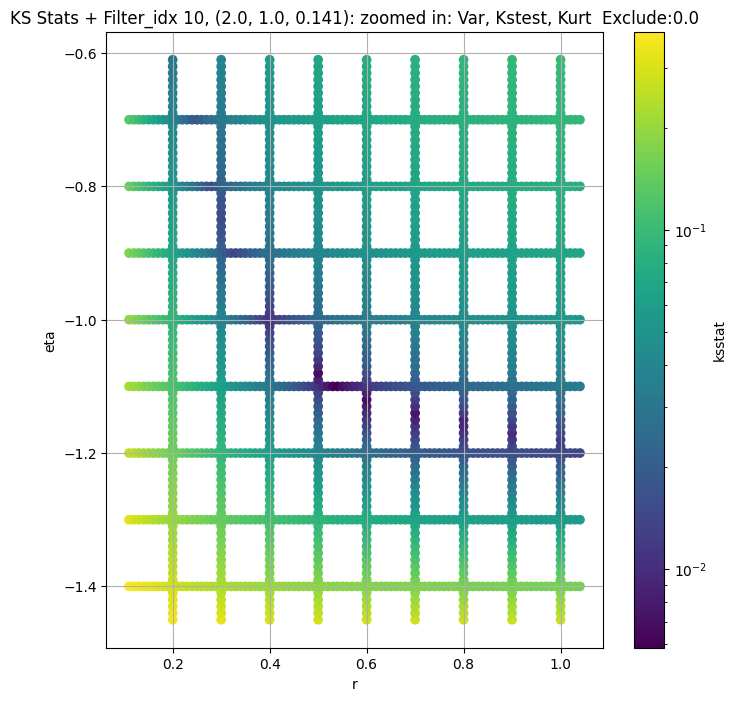

Filter_idx 11, (2.0, 1.0, 0.208):


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 11, 0.0 + 100 = 100, ksstat: 0.007325660732861949, var: 4.251547336578369


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 11, 0.0 + 75 = 75, ksstat: 0.007174254692109416, var: 4.37110710144043


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 11, 0.0 + 50 = 50, ksstat: 0.006713886938451263, var: 4.5140485763549805


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 11, 0.0 + 25 = 25, ksstat: 0.007146977192383275, var: 4.699549198150635


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 11, 0.0 + 0 = 0, ksstat: 0.007211866992224869, var: 5.122861385345459
Number of samples: 100000, Without approximation : 160000000.0


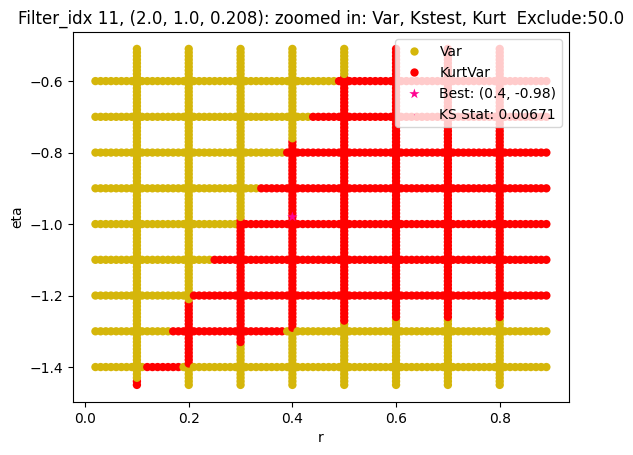

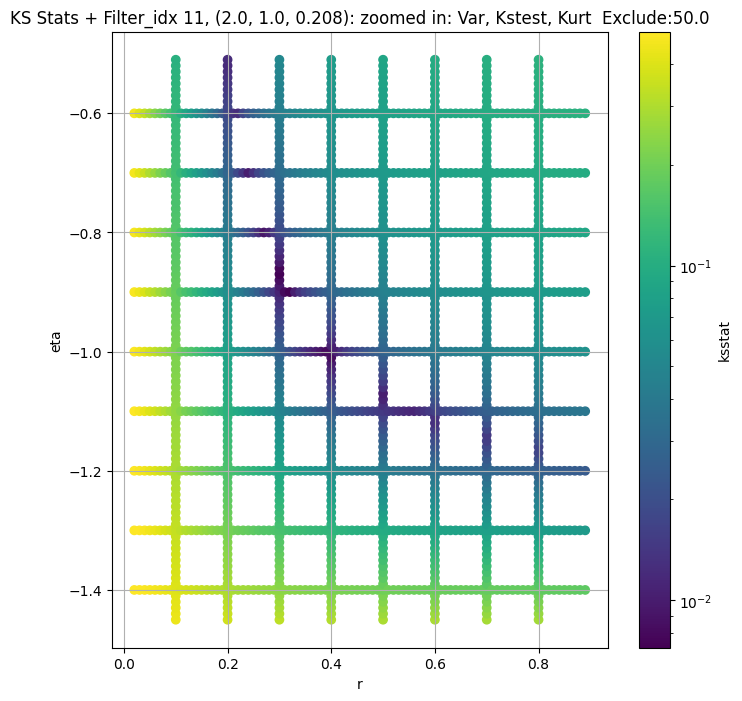

Filter_idx 12, (2.0, 1.0, 0.306):


  0%|          | 0/1188 [00:00<?, ?it/s]

Finding Minimum after computing 1188 CDFs
filter_idx 12, 0.0 + 100 = 100, ksstat: 0.005875655444186015, var: 1.3837767839431763


  0%|          | 0/1188 [00:00<?, ?it/s]

Finding Minimum after computing 1188 CDFs
filter_idx 12, 0.0 + 75 = 75, ksstat: 0.006049559676942207, var: 1.425551414489746


  0%|          | 0/1188 [00:00<?, ?it/s]

Finding Minimum after computing 1188 CDFs
filter_idx 12, 0.0 + 50 = 50, ksstat: 0.005894426166862365, var: 1.4761635065078735


  0%|          | 0/1188 [00:00<?, ?it/s]

Finding Minimum after computing 1188 CDFs
filter_idx 12, 0.0 + 25 = 25, ksstat: 0.004941202463904143, var: 1.5430705547332764


  0%|          | 0/1188 [00:00<?, ?it/s]

Finding Minimum after computing 1188 CDFs
filter_idx 12, 0.0 + 0 = 0, ksstat: 0.004068755839700455, var: 1.7179714441299438
Number of samples: 100000, Without approximation : 160000000.0


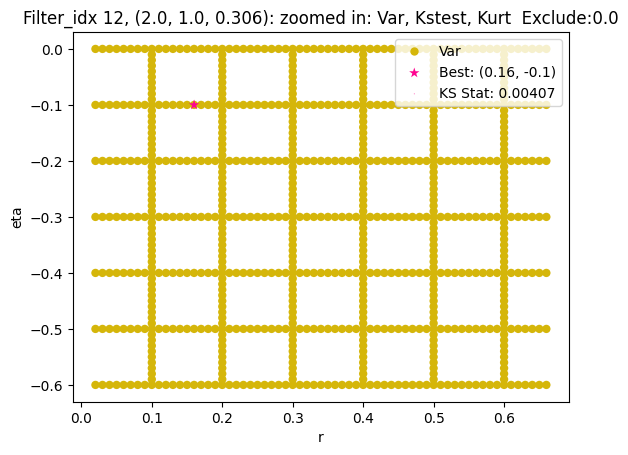

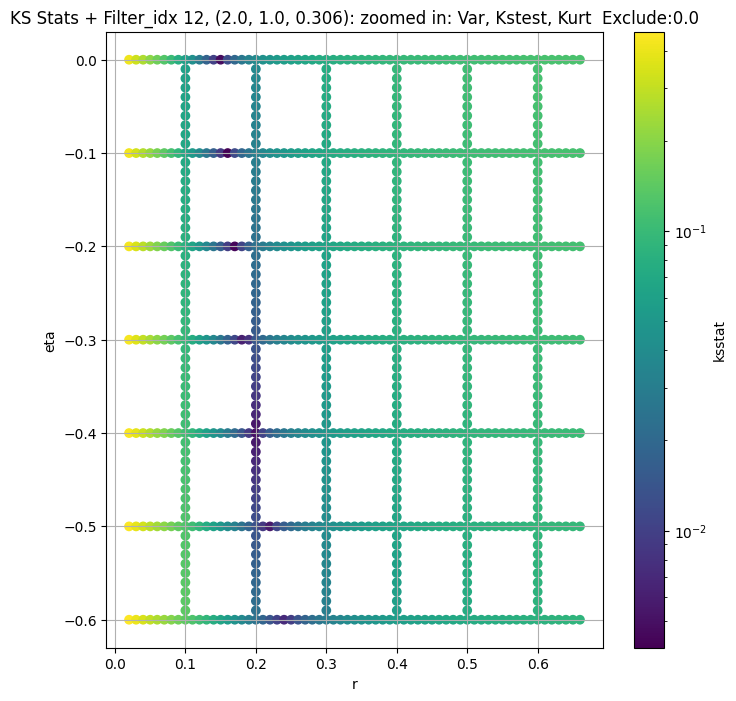

Filter_idx 13, (2.0, 1.0, 0.45):


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 13, 0.0 + 100 = 100, ksstat: 0.005781983365377941, var: 0.5976799130439758


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 13, 0.0 + 75 = 75, ksstat: 0.004851469108989162, var: 0.6148967742919922


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 13, 0.0 + 50 = 50, ksstat: 0.004325223488981081, var: 0.6357987523078918


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 13, 0.0 + 25 = 25, ksstat: 0.0036142922785669107, var: 0.6636086106300354


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 13, 0.0 + 0 = 0, ksstat: 0.002975810207924645, var: 0.7548269629478455
Number of samples: 100000, Without approximation : 160000000.0


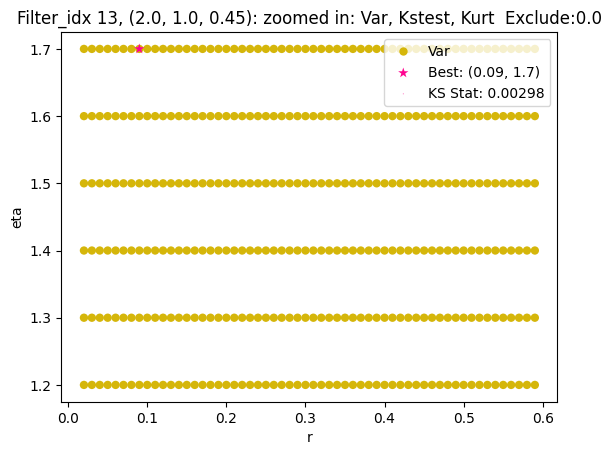

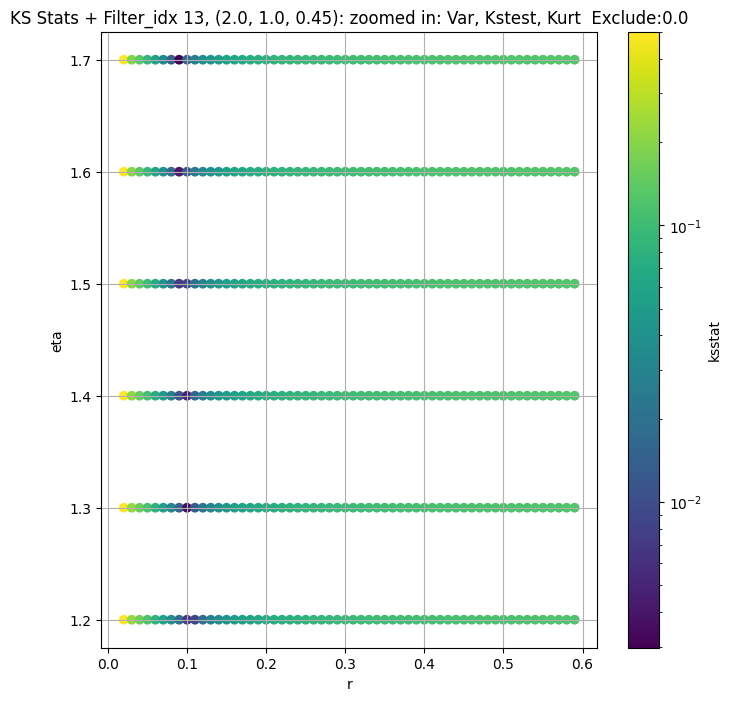

Filter_idx 14, (3.0, 0.5, 0.044):


  0%|          | 0/849 [00:00<?, ?it/s]

Finding Minimum after computing 849 CDFs
filter_idx 14, 0.0 + 100 = 100, ksstat: 0.00797225831381898, var: 125.57659149169922


  0%|          | 0/849 [00:00<?, ?it/s]

Finding Minimum after computing 849 CDFs
filter_idx 14, 0.0 + 75 = 75, ksstat: 0.007913029750983291, var: 127.81208038330078


  0%|          | 0/849 [00:00<?, ?it/s]

Finding Minimum after computing 849 CDFs
filter_idx 14, 0.0 + 50 = 50, ksstat: 0.006995860326731385, var: 130.39471435546875


  0%|          | 0/849 [00:00<?, ?it/s]

Finding Minimum after computing 849 CDFs
filter_idx 14, 0.0 + 25 = 25, ksstat: 0.006740629318080005, var: 133.5722198486328


  0%|          | 0/849 [00:00<?, ?it/s]

Finding Minimum after computing 849 CDFs
filter_idx 14, 0.0 + 0 = 0, ksstat: 0.006619062596213698, var: 139.32408142089844
Number of samples: 100000, Without approximation : 160000000.0


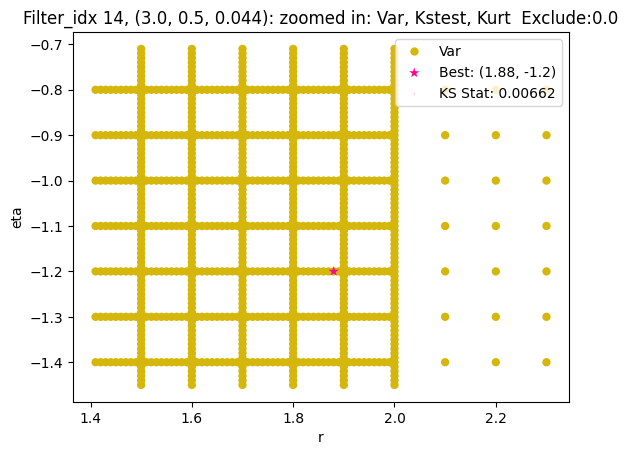

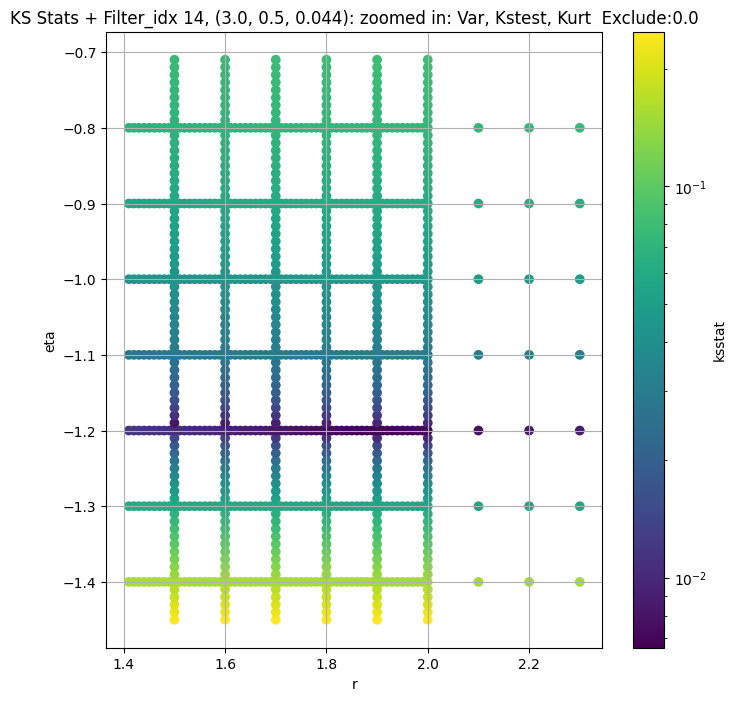

Filter_idx 15, (3.0, 0.5, 0.065):


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 15, 50.0 + 100 = 150, ksstat: 0.008761890159150187, var: 46.42071533203125


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 15, 50.0 + 75 = 125, ksstat: 0.008844600694834559, var: 47.20912170410156


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 15, 50.0 + 50 = 100, ksstat: 0.008740387691454798, var: 48.07709503173828


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 15, 50.0 + 25 = 75, ksstat: 0.008947446408514859, var: 49.052833557128906


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 15, 50.0 + 0 = 50, ksstat: 0.008816609189680746, var: 50.189693450927734


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 15, 50.0 + -25 = 25, ksstat: 0.008913519799800484, var: 51.61722946166992


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 15, 50.0 + -50 = 0, ksstat: 0.008741111419226955, var: 54.512916564941406
Number of samples: 100000, Without approximation : 160000000.0


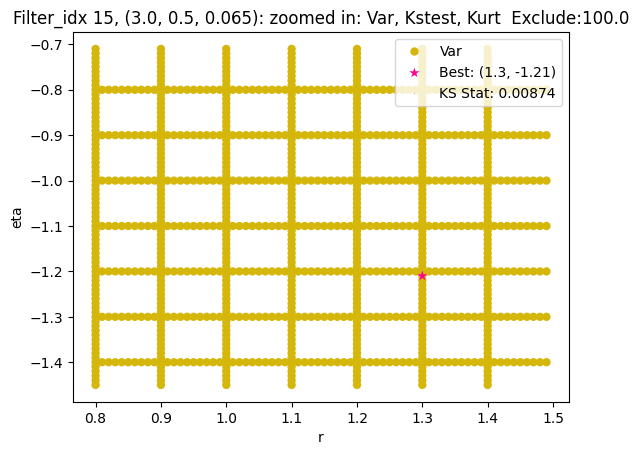

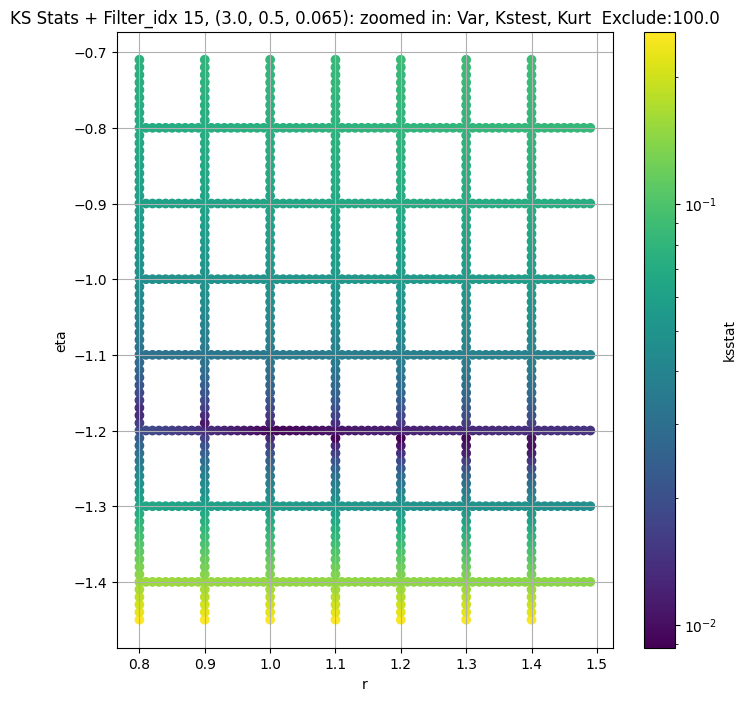

Filter_idx 16, (3.0, 0.5, 0.096):


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 16, 200.0 + 100 = 300, ksstat: 0.008954344918447932, var: 18.847856521606445


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 16, 200.0 + 75 = 275, ksstat: 0.008883757561815031, var: 19.11323356628418


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 16, 200.0 + 50 = 250, ksstat: 0.008810542974829194, var: 19.392791748046875


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 16, 200.0 + 25 = 225, ksstat: 0.009004474902945203, var: 19.688453674316406


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 16, 200.0 + 0 = 200, ksstat: 0.009014344296273513, var: 20.002647399902344


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 16, 200.0 + -25 = 175, ksstat: 0.008929938755009692, var: 20.3386173248291


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 16, 200.0 + -50 = 150, ksstat: 0.008840613188646373, var: 20.70081329345703


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 16, 200.0 + -75 = 125, ksstat: 0.00912821322811841, var: 21.095298767089844


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 16, 200.0 + -100 = 100, ksstat: 0.009381644499828035, var: 21.5311279296875
Number of samples: 100000, Without approximation : 160000000.0


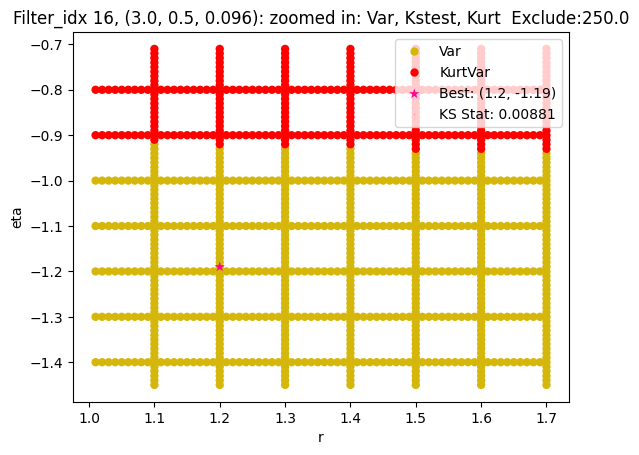

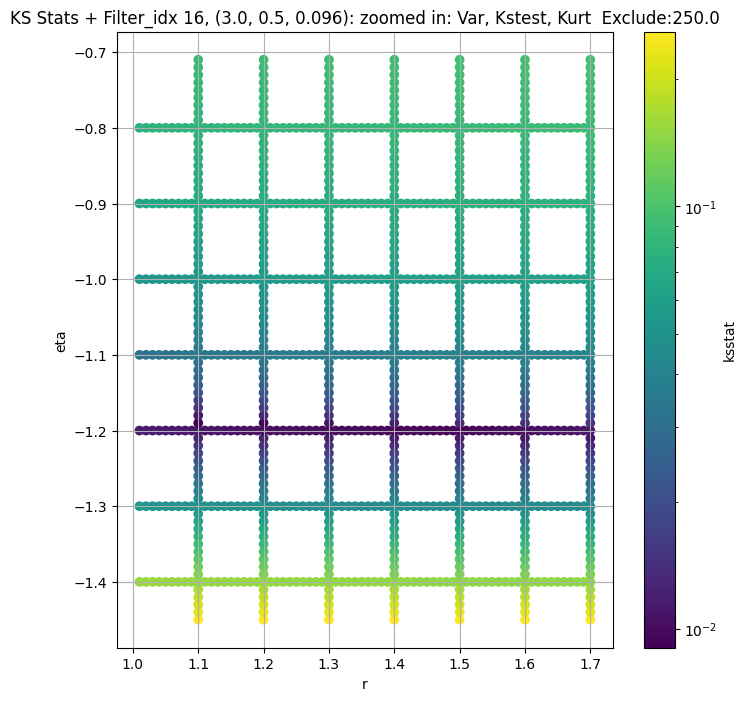

Filter_idx 17, (3.0, 0.5, 0.141):


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 17, 50.0 + 100 = 150, ksstat: 0.00837993143964777, var: 8.270288467407227


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 17, 50.0 + 75 = 125, ksstat: 0.00808790292389873, var: 8.454451560974121


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 17, 50.0 + 50 = 100, ksstat: 0.007998849525758689, var: 8.660181045532227


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 17, 50.0 + 25 = 75, ksstat: 0.007817040156539778, var: 8.895268440246582


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 17, 50.0 + 0 = 50, ksstat: 0.007855086440284764, var: 9.174260139465332


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 17, 50.0 + -25 = 25, ksstat: 0.007922360016111463, var: 9.532785415649414


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 17, 50.0 + -50 = 0, ksstat: 0.00813503732608234, var: 10.273448944091797
Number of samples: 100000, Without approximation : 160000000.0


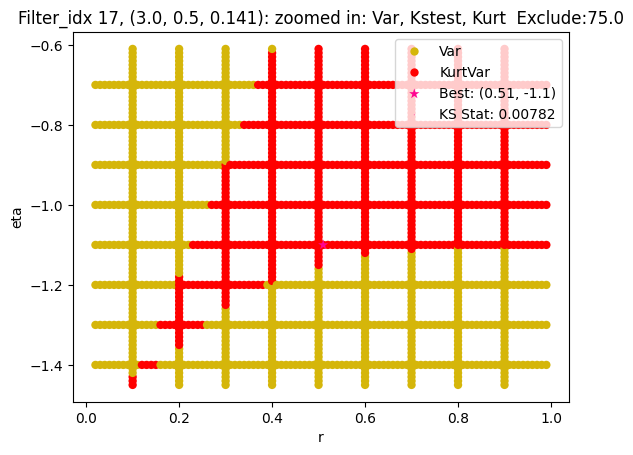

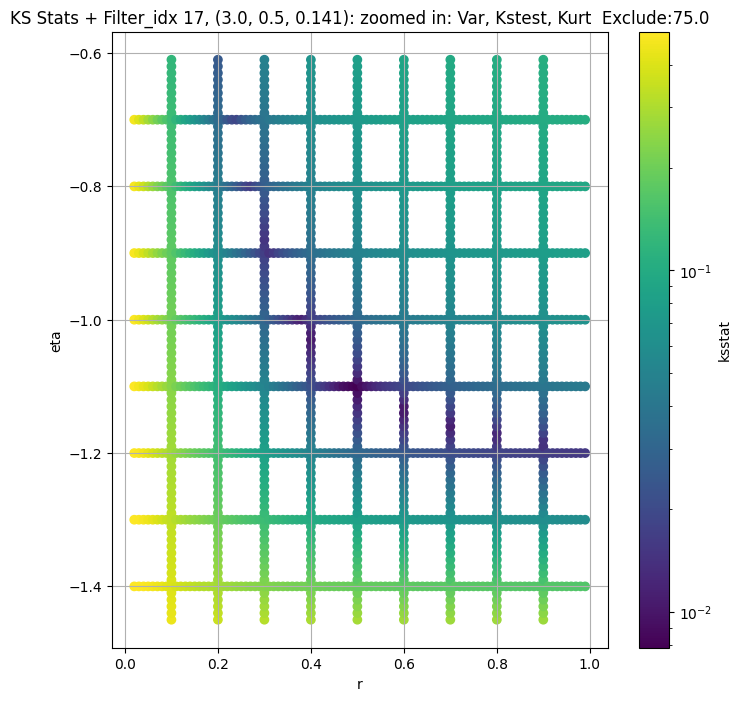

Filter_idx 18, (3.0, 0.5, 0.208):


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 18, 0.0 + 100 = 100, ksstat: 0.008813055987478946, var: 3.0601837635040283


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 18, 0.0 + 75 = 75, ksstat: 0.008206624089908354, var: 3.152876853942871


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 18, 0.0 + 50 = 50, ksstat: 0.007728126371861599, var: 3.263901472091675


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 18, 0.0 + 25 = 25, ksstat: 0.007932554293721417, var: 3.4081320762634277


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 18, 0.0 + 0 = 0, ksstat: 0.006804303419529256, var: 3.7414309978485107
Number of samples: 100000, Without approximation : 160000000.0


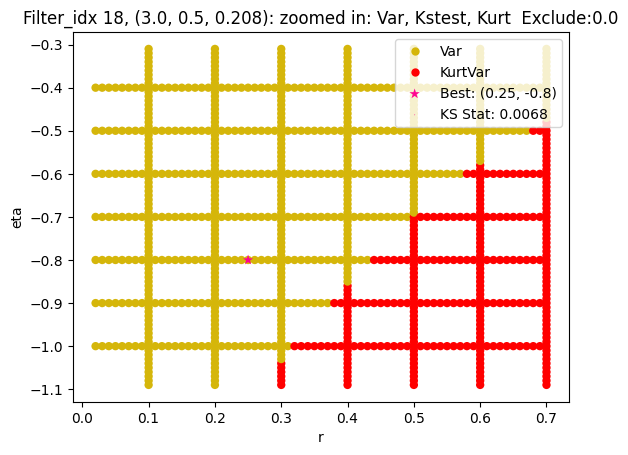

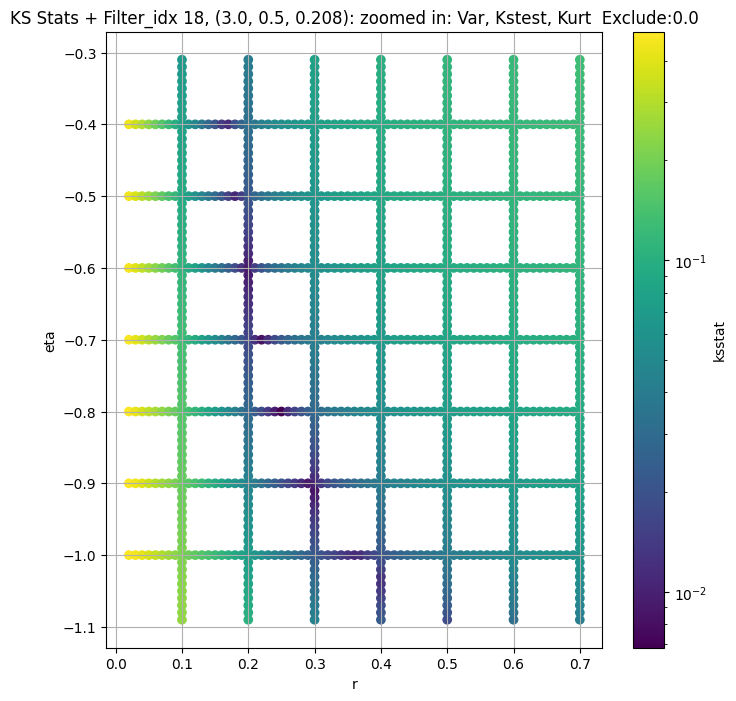

Filter_idx 19, (3.0, 0.5, 0.306):


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 19, 0.0 + 100 = 100, ksstat: 0.006521541034584133, var: 0.9495435357093811


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 19, 0.0 + 75 = 75, ksstat: 0.006089542656625868, var: 0.9797053933143616


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 19, 0.0 + 50 = 50, ksstat: 0.005297723542306794, var: 1.0165290832519531


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 19, 0.0 + 25 = 25, ksstat: 0.00443906837647326, var: 1.0658708810806274


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 19, 0.0 + 0 = 0, ksstat: 0.004267997356001196, var: 1.1976593732833862
Number of samples: 100000, Without approximation : 160000000.0


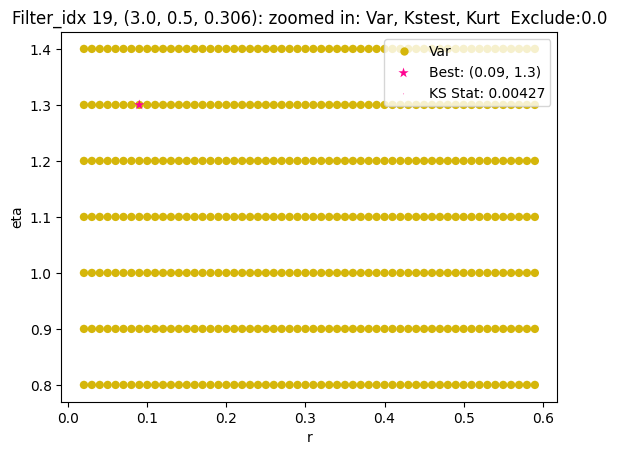

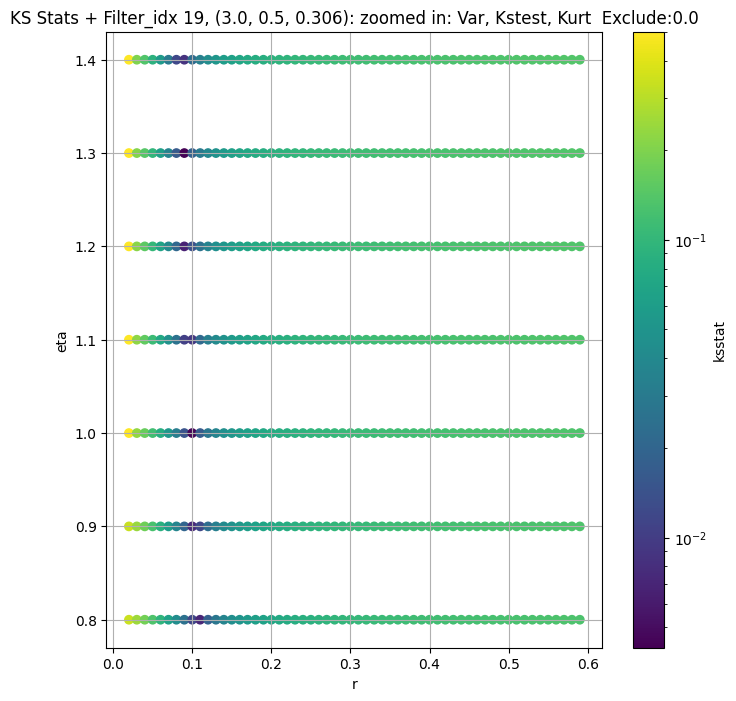

Filter_idx 20, (3.0, 0.5, 0.45):


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 20, 50.0 + 100 = 150, ksstat: 0.005598962428671646, var: 0.3208724558353424


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 20, 50.0 + 75 = 125, ksstat: 0.005121647195320933, var: 0.32830119132995605


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 20, 50.0 + 50 = 100, ksstat: 0.00467577684958187, var: 0.33674731850624084


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 20, 50.0 + 25 = 75, ksstat: 0.003999350941781228, var: 0.34662458300590515


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 20, 50.0 + 0 = 50, ksstat: 0.0030763427574831553, var: 0.3587544560432434


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 20, 50.0 + -25 = 25, ksstat: 0.00290079347951977, var: 0.3752955496311188


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 20, 50.0 + -50 = 0, ksstat: 0.004245307389854569, var: 0.43484458327293396
Number of samples: 100000, Without approximation : 160000000.0


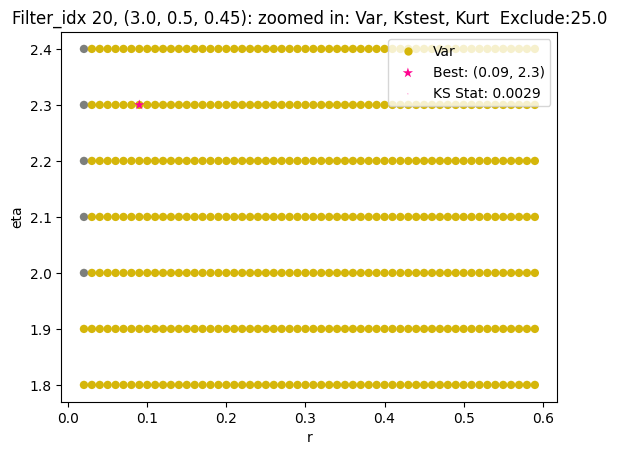

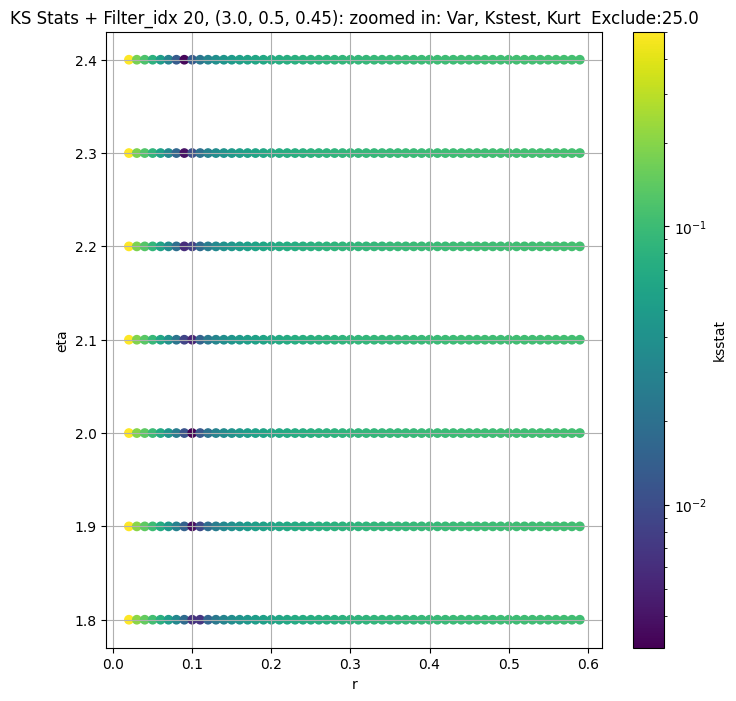

Filter_idx 21, (3.0, 1.0, 0.044):


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 21, 0.0 + 100 = 100, ksstat: 0.007031737329228571, var: 142.5428466796875


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 21, 0.0 + 75 = 75, ksstat: 0.006819042131180342, var: 145.2147979736328


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 21, 0.0 + 50 = 50, ksstat: 0.00677851912908356, var: 148.3101348876953


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 21, 0.0 + 25 = 25, ksstat: 0.006764067850508759, var: 152.1396026611328


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 21, 0.0 + 0 = 0, ksstat: 0.006679227743681904, var: 159.65025329589844
Number of samples: 100000, Without approximation : 160000000.0


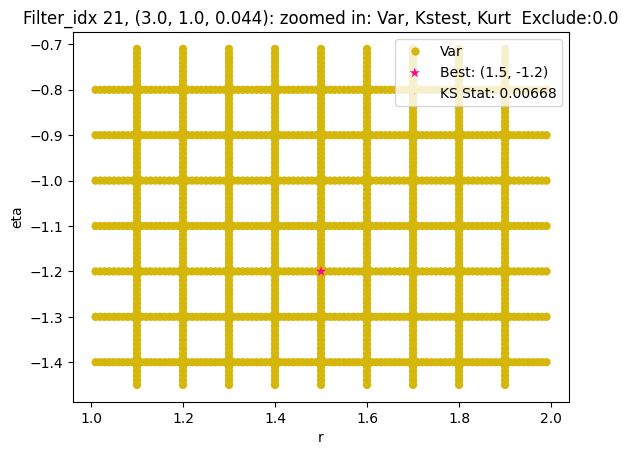

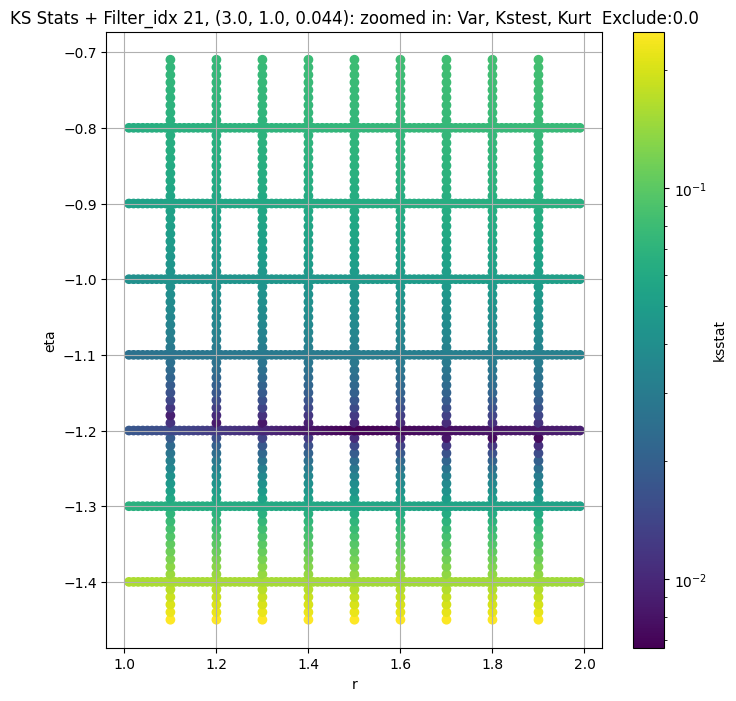

Filter_idx 22, (3.0, 1.0, 0.065):


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 22, 0.0 + 100 = 100, ksstat: 0.008355159160821413, var: 54.60955810546875


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 22, 0.0 + 75 = 75, ksstat: 0.008320224304993351, var: 55.6899299621582


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 22, 0.0 + 50 = 50, ksstat: 0.008198462324619848, var: 56.9386100769043


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 22, 0.0 + 25 = 25, ksstat: 0.008183087854471416, var: 58.480106353759766


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 22, 0.0 + 0 = 0, ksstat: 0.007933452461073964, var: 61.572879791259766
Number of samples: 100000, Without approximation : 160000000.0


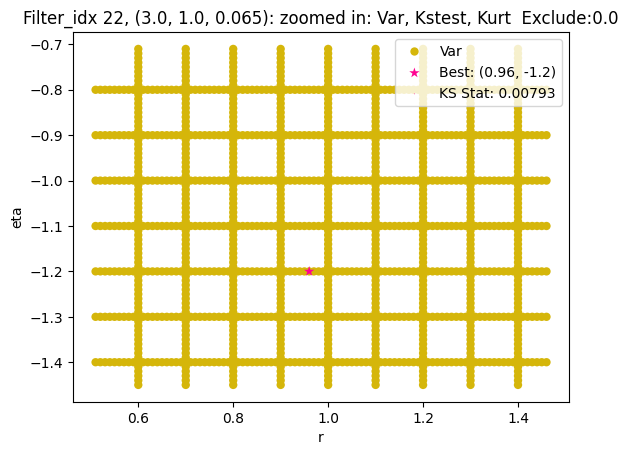

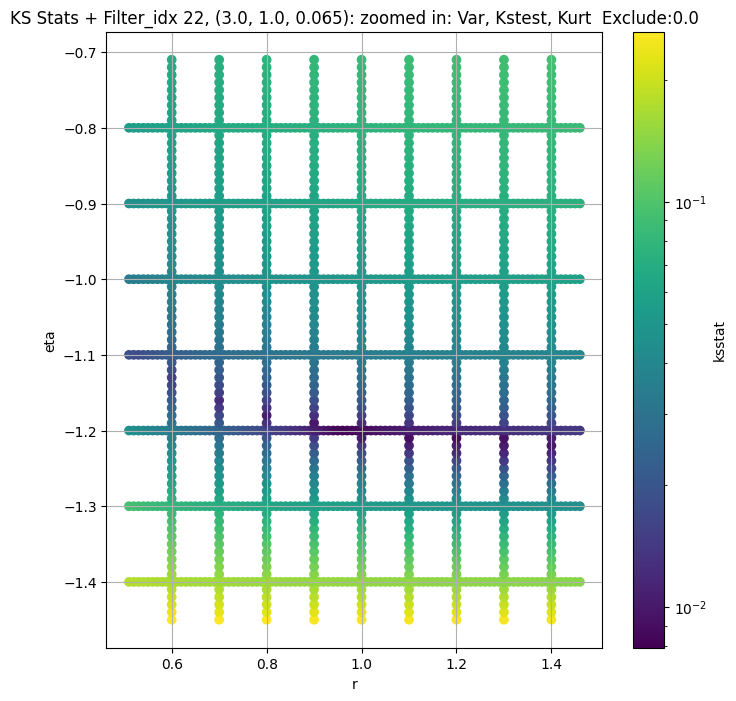

Filter_idx 23, (3.0, 1.0, 0.096):


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 23, 200.0 + 100 = 300, ksstat: 0.009374185426892945, var: 19.162355422973633


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 23, 200.0 + 75 = 275, ksstat: 0.009298991055590067, var: 19.44489097595215


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 23, 200.0 + 50 = 250, ksstat: 0.009245014334684665, var: 19.742952346801758


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 23, 200.0 + 25 = 225, ksstat: 0.009119152649749551, var: 20.058761596679688


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 23, 200.0 + 0 = 200, ksstat: 0.00898921391470886, var: 20.395191192626953


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 23, 200.0 + -25 = 175, ksstat: 0.008852814490000027, var: 20.756013870239258


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 23, 200.0 + -50 = 150, ksstat: 0.008476749332803957, var: 21.145931243896484


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 23, 200.0 + -75 = 125, ksstat: 0.008324208449107084, var: 21.571767807006836


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 23, 200.0 + -100 = 100, ksstat: 0.008557320072925478, var: 22.04348373413086
Number of samples: 100000, Without approximation : 160000000.0


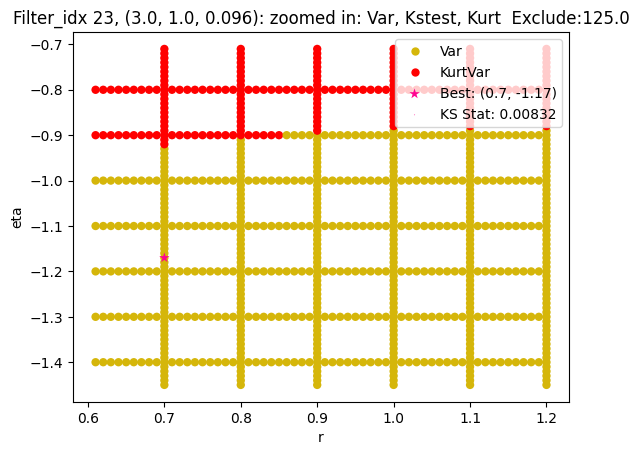

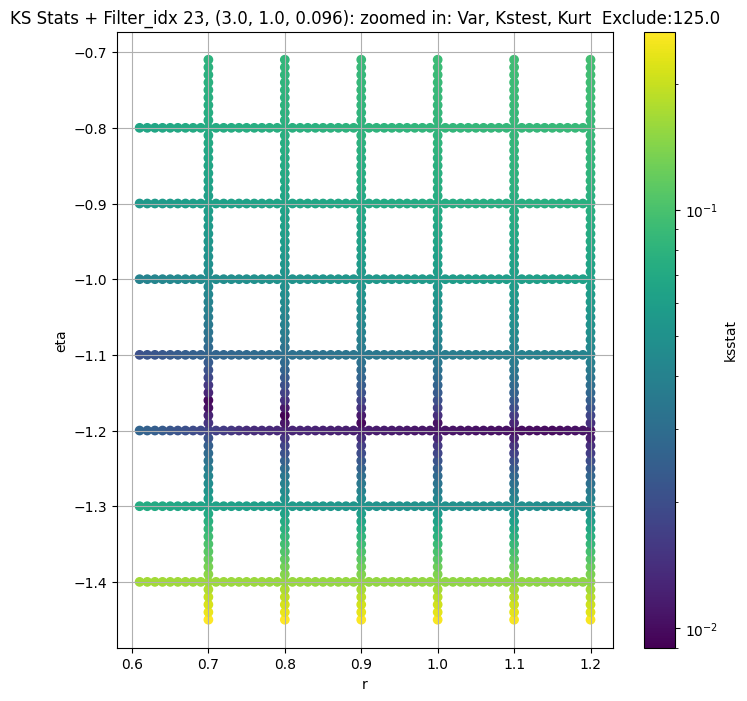

Filter_idx 24, (3.0, 1.0, 0.141):


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 24, 100.0 + 100 = 200, ksstat: 0.009006807365664948, var: 9.533294677734375


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 24, 100.0 + 75 = 175, ksstat: 0.008845823564588115, var: 9.719770431518555


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 24, 100.0 + 50 = 150, ksstat: 0.008661960539578906, var: 9.922306060791016


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 24, 100.0 + 25 = 125, ksstat: 0.008459398304808796, var: 10.144914627075195


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 24, 100.0 + 0 = 100, ksstat: 0.008092684438631204, var: 10.393628120422363


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 24, 100.0 + -25 = 75, ksstat: 0.007933998151105293, var: 10.67796802520752


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 24, 100.0 + -50 = 50, ksstat: 0.008115272571972976, var: 11.015664100646973


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 24, 100.0 + -75 = 25, ksstat: 0.008245128748819164, var: 11.449811935424805


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 24, 100.0 + -100 = 0, ksstat: 0.00770656742238407, var: 12.506858825683594
Number of samples: 100000, Without approximation : 160000000.0


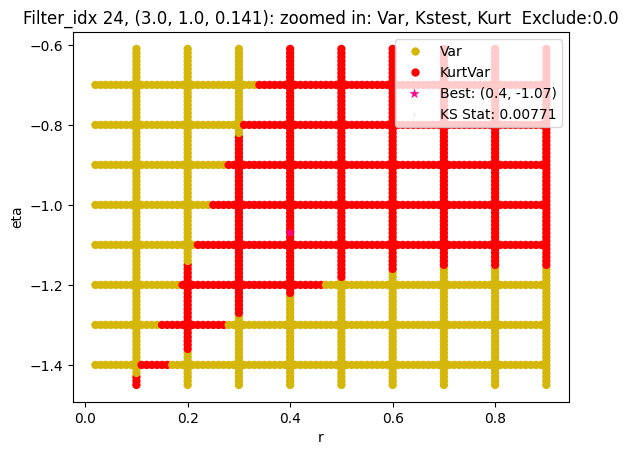

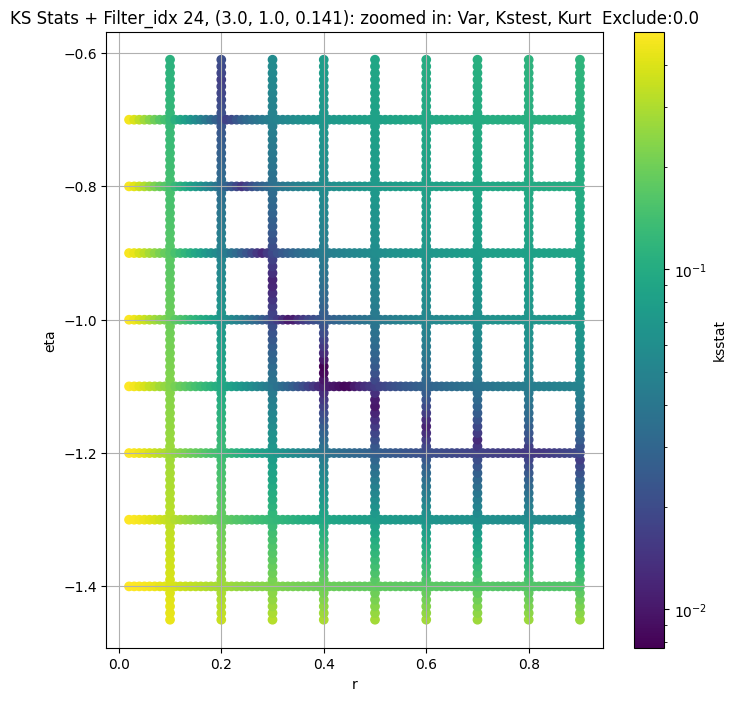

Filter_idx 25, (3.0, 1.0, 0.208):


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 25, 0.0 + 100 = 100, ksstat: 0.00827005380708623, var: 3.4824166297912598


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 25, 0.0 + 75 = 75, ksstat: 0.00737675597747256, var: 3.5891780853271484


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 25, 0.0 + 50 = 50, ksstat: 0.007116702571114644, var: 3.7173476219177246


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 25, 0.0 + 25 = 25, ksstat: 0.007142355159024394, var: 3.8846287727355957


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 25, 0.0 + 0 = 0, ksstat: 0.006432253347286476, var: 4.274352073669434
Number of samples: 100000, Without approximation : 160000000.0


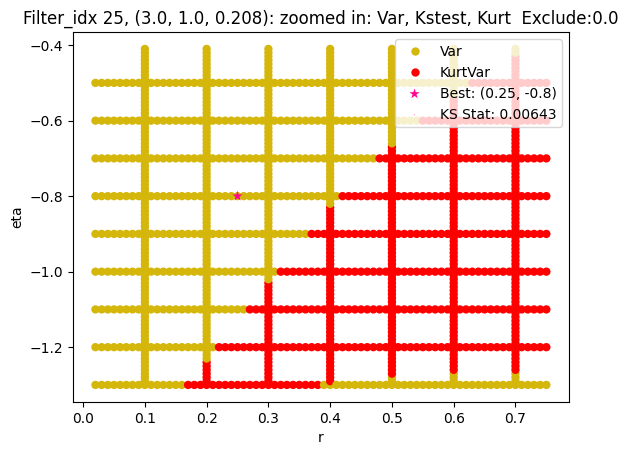

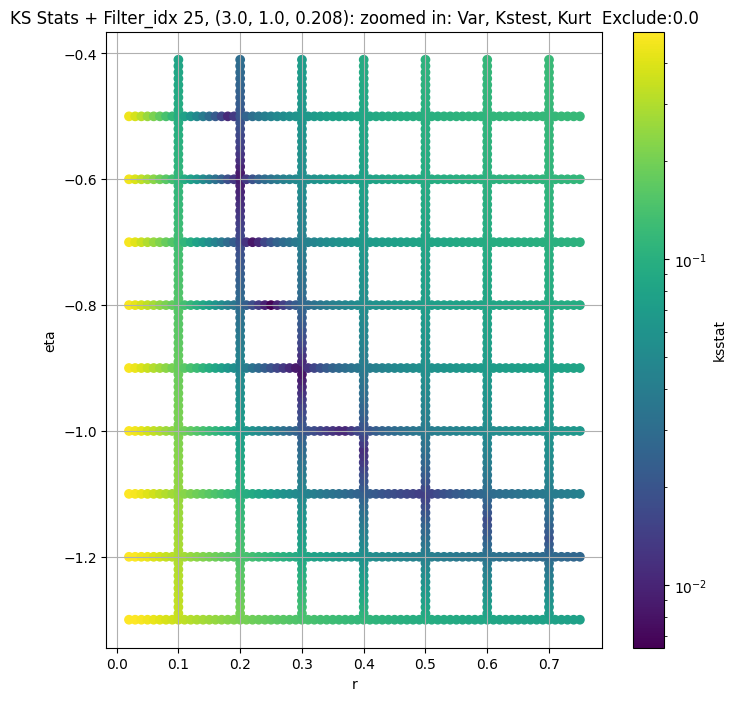

Filter_idx 26, (3.0, 1.0, 0.306):


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 26, 0.0 + 100 = 100, ksstat: 0.006731077489704362, var: 1.1426135301589966


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 26, 0.0 + 75 = 75, ksstat: 0.006838028533195262, var: 1.1816763877868652


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 26, 0.0 + 50 = 50, ksstat: 0.005045503208933558, var: 1.2296453714370728


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 26, 0.0 + 25 = 25, ksstat: 0.004356728211330485, var: 1.2946829795837402


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 26, 0.0 + 0 = 0, ksstat: 0.004916250763915553, var: 1.4885468482971191
Number of samples: 100000, Without approximation : 160000000.0


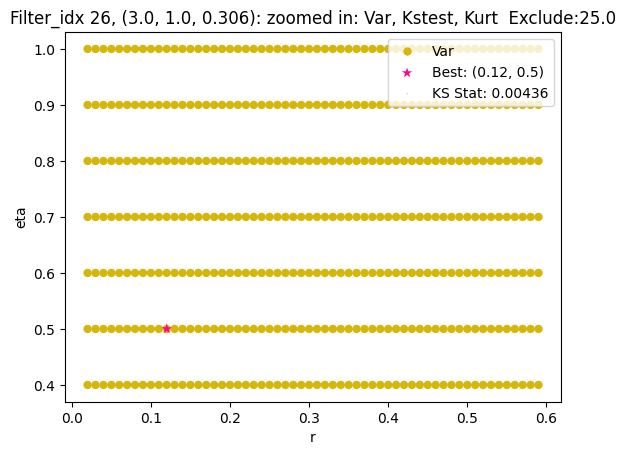

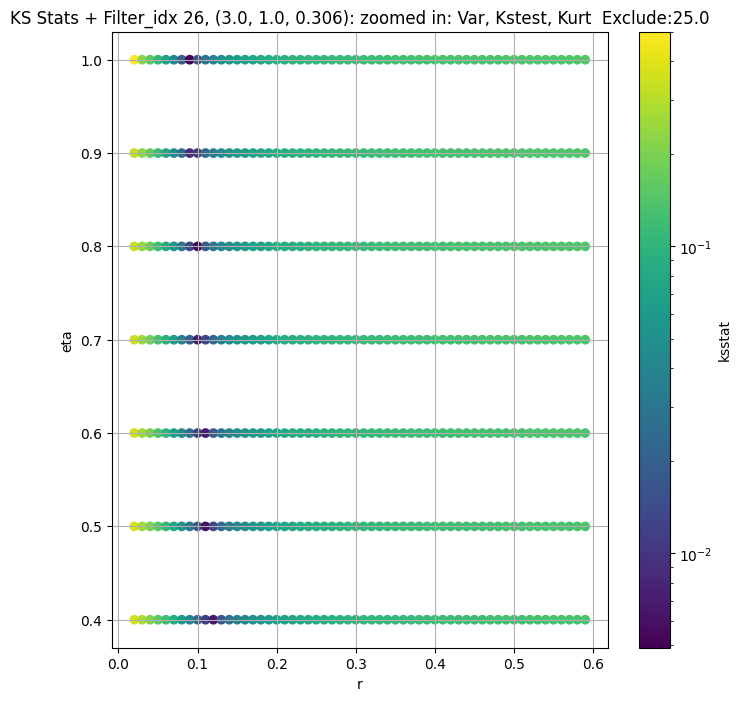

Filter_idx 27, (3.0, 1.0, 0.45):


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 27, 50.0 + 100 = 150, ksstat: 0.005675935613756233, var: 0.3314931094646454


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 27, 50.0 + 75 = 125, ksstat: 0.004764486678802582, var: 0.33964815735816956


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 27, 50.0 + 50 = 100, ksstat: 0.004155965373132342, var: 0.34895673394203186


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 27, 50.0 + 25 = 75, ksstat: 0.003556806473198594, var: 0.3599075675010681


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 27, 50.0 + 0 = 50, ksstat: 0.0028234563712694616, var: 0.373475581407547


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 27, 50.0 + -25 = 25, ksstat: 0.002892974090811906, var: 0.39218640327453613


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 27, 50.0 + -50 = 0, ksstat: 0.004972968696463381, var: 0.4579738974571228
Number of samples: 100000, Without approximation : 160000000.0


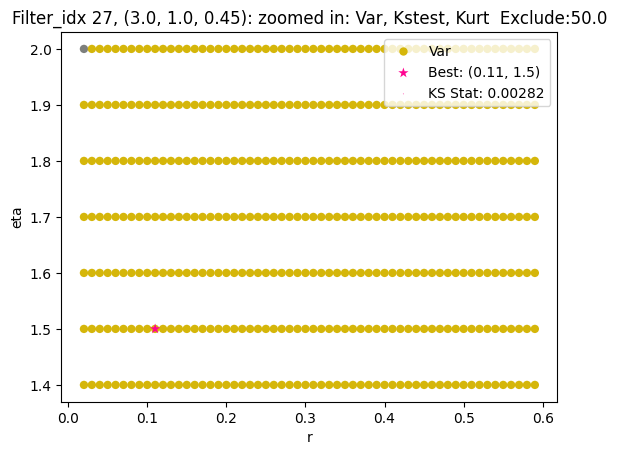

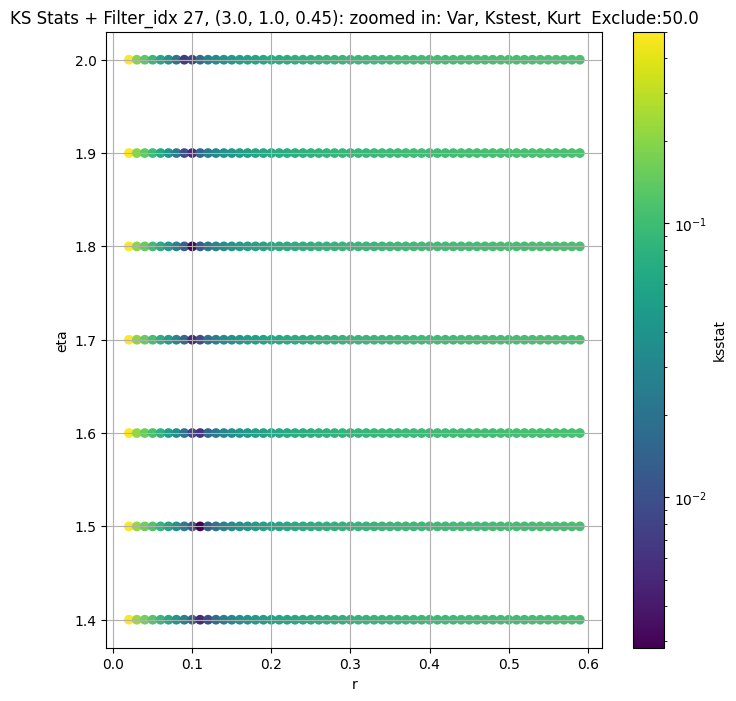

Filter_idx 28, (4.0, 0.5, 0.044):


  0%|          | 0/131 [00:00<?, ?it/s]

Finding Minimum after computing 131 CDFs
filter_idx 28, 100.0 + 100 = 200, ksstat: 0.007968342523042793, var: 114.52752685546875


  0%|          | 0/131 [00:00<?, ?it/s]

Finding Minimum after computing 131 CDFs
filter_idx 28, 100.0 + 75 = 175, ksstat: 0.007670577923640565, var: 116.13910675048828


  0%|          | 0/131 [00:00<?, ?it/s]

Finding Minimum after computing 131 CDFs
filter_idx 28, 100.0 + 50 = 150, ksstat: 0.007030404971560267, var: 117.8672103881836


  0%|          | 0/131 [00:00<?, ?it/s]

Finding Minimum after computing 131 CDFs
filter_idx 28, 100.0 + 25 = 125, ksstat: 0.0063551606078129375, var: 119.73844909667969


  0%|          | 0/131 [00:00<?, ?it/s]

Finding Minimum after computing 131 CDFs
filter_idx 28, 100.0 + 0 = 100, ksstat: 0.0062404333372506615, var: 121.7903823852539


  0%|          | 0/131 [00:00<?, ?it/s]

Finding Minimum after computing 131 CDFs
filter_idx 28, 100.0 + -25 = 75, ksstat: 0.006541062429694308, var: 124.08590698242188


  0%|          | 0/131 [00:00<?, ?it/s]

Finding Minimum after computing 131 CDFs
filter_idx 28, 100.0 + -50 = 50, ksstat: 0.007840036330876224, var: 126.73688507080078


  0%|          | 0/131 [00:00<?, ?it/s]

Finding Minimum after computing 131 CDFs
filter_idx 28, 100.0 + -75 = 25, ksstat: 0.008439853690173305, var: 130.00425720214844


  0%|          | 0/131 [00:00<?, ?it/s]

Finding Minimum after computing 131 CDFs
filter_idx 28, 100.0 + -100 = 0, ksstat: 0.010532090524230209, var: 136.1292266845703
Number of samples: 100000, Without approximation : 160000000.0


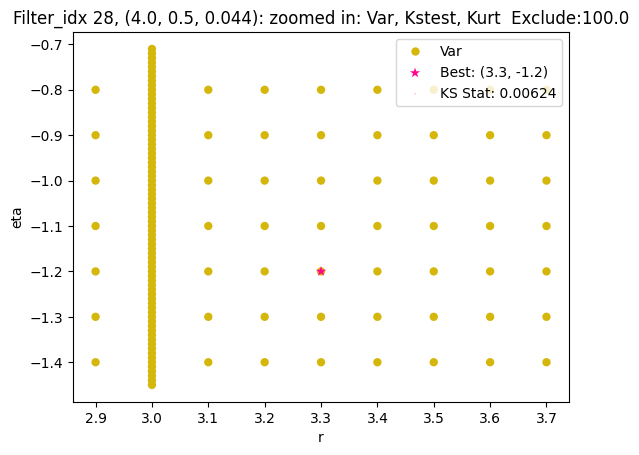

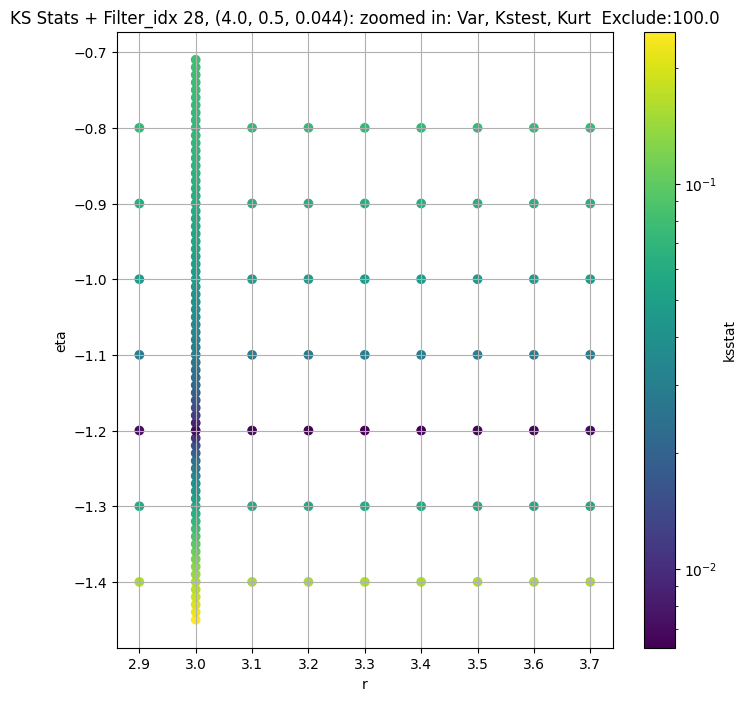

Filter_idx 29, (4.0, 0.5, 0.065):


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 29, 50.0 + 100 = 150, ksstat: 0.007094014373211777, var: 45.209449768066406


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 29, 50.0 + 75 = 125, ksstat: 0.007093791903907465, var: 45.98545837402344


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 29, 50.0 + 50 = 100, ksstat: 0.0070945426368667075, var: 46.836326599121094


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 29, 50.0 + 25 = 75, ksstat: 0.007115777068567142, var: 47.787357330322266


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 29, 50.0 + 0 = 50, ksstat: 0.007115156816236312, var: 48.882057189941406


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 29, 50.0 + -25 = 25, ksstat: 0.007104369419976275, var: 50.21792984008789


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 29, 50.0 + -50 = 0, ksstat: 0.007155500655697533, var: 52.638275146484375
Number of samples: 100000, Without approximation : 160000000.0


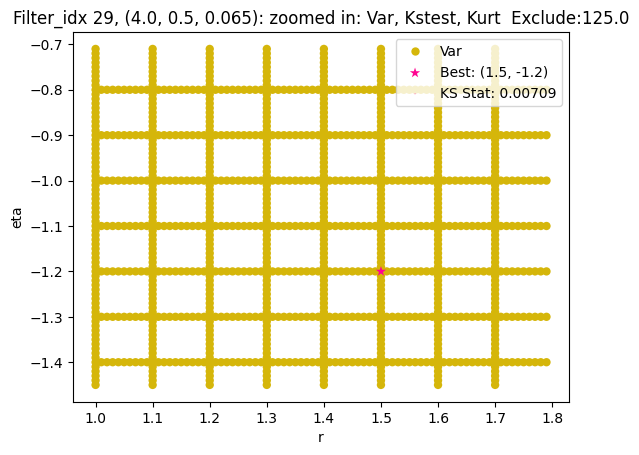

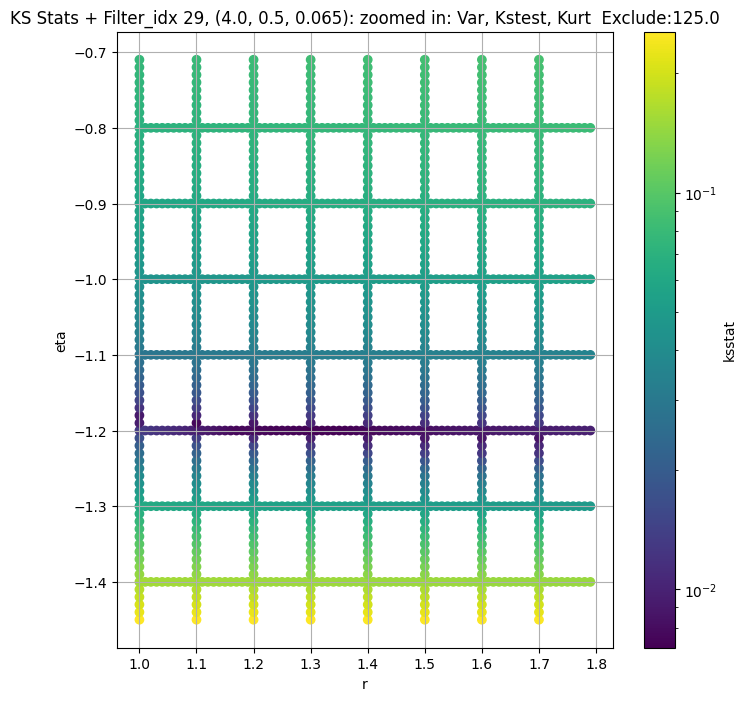

Filter_idx 30, (4.0, 0.5, 0.096):


  0%|          | 0/1380 [00:00<?, ?it/s]

Finding Minimum after computing 1380 CDFs
filter_idx 30, 100.0 + 100 = 200, ksstat: 0.008379505509701735, var: 18.797237396240234


  0%|          | 0/1380 [00:00<?, ?it/s]

Finding Minimum after computing 1380 CDFs
filter_idx 30, 100.0 + 75 = 175, ksstat: 0.008783720835325526, var: 19.129863739013672


  0%|          | 0/1380 [00:00<?, ?it/s]

Finding Minimum after computing 1380 CDFs
filter_idx 30, 100.0 + 50 = 150, ksstat: 0.008641217832313253, var: 19.48947525024414


  0%|          | 0/1380 [00:00<?, ?it/s]

Finding Minimum after computing 1380 CDFs
filter_idx 30, 100.0 + 25 = 125, ksstat: 0.00848939632341239, var: 19.882356643676758


  0%|          | 0/1380 [00:00<?, ?it/s]

Finding Minimum after computing 1380 CDFs
filter_idx 30, 100.0 + 0 = 100, ksstat: 0.008367252264403602, var: 20.318042755126953


  0%|          | 0/1380 [00:00<?, ?it/s]

Finding Minimum after computing 1380 CDFs
filter_idx 30, 100.0 + -25 = 75, ksstat: 0.008381040042976906, var: 20.812101364135742


  0%|          | 0/1380 [00:00<?, ?it/s]

Finding Minimum after computing 1380 CDFs
filter_idx 30, 100.0 + -50 = 50, ksstat: 0.009071958175649986, var: 21.393220901489258


  0%|          | 0/1380 [00:00<?, ?it/s]

Finding Minimum after computing 1380 CDFs
filter_idx 30, 100.0 + -75 = 25, ksstat: 0.009136748744264511, var: 22.12908935546875


  0%|          | 0/1380 [00:00<?, ?it/s]

Finding Minimum after computing 1380 CDFs
filter_idx 30, 100.0 + -100 = 0, ksstat: 0.009136058025085214, var: 23.663501739501953
Number of samples: 100000, Without approximation : 160000000.0


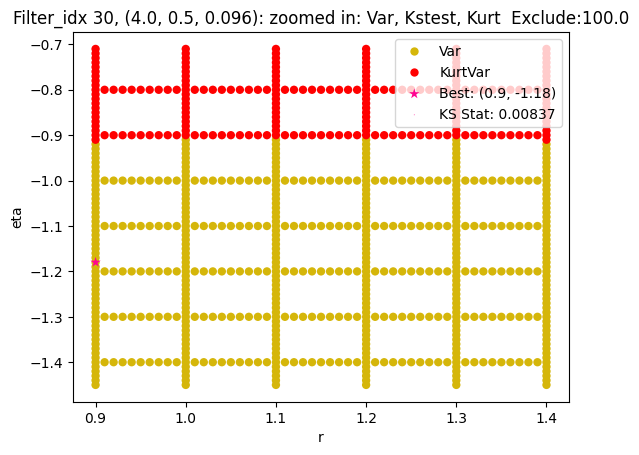

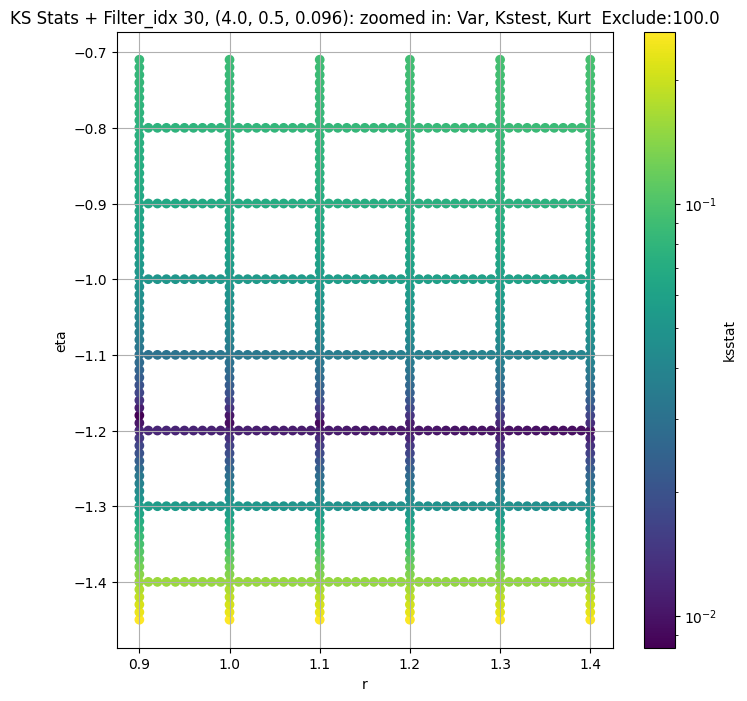

Filter_idx 31, (4.0, 0.5, 0.141):


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 31, 50.0 + 100 = 150, ksstat: 0.00854859727855184, var: 8.243247032165527


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 31, 50.0 + 75 = 125, ksstat: 0.008209889478968446, var: 8.42365837097168


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 31, 50.0 + 50 = 100, ksstat: 0.008094746849713896, var: 8.625121116638184


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 31, 50.0 + 25 = 75, ksstat: 0.008025742854247259, var: 8.85512924194336


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 31, 50.0 + 0 = 50, ksstat: 0.008342548676168793, var: 9.127923965454102


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 31, 50.0 + -25 = 25, ksstat: 0.008398628372762673, var: 9.478285789489746


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 31, 50.0 + -50 = 0, ksstat: 0.008512600715834373, var: 10.277639389038086
Number of samples: 100000, Without approximation : 160000000.0


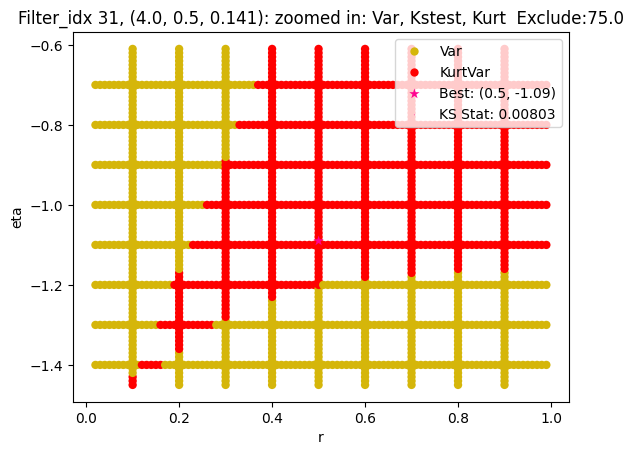

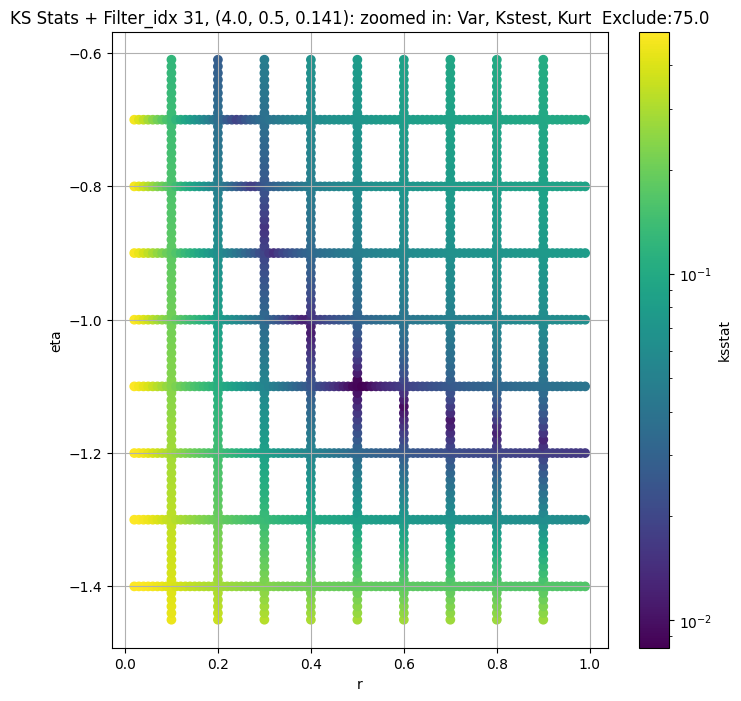

Filter_idx 32, (4.0, 0.5, 0.208):


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 32, 100.0 + 100 = 200, ksstat: 0.0083210618607414, var: 2.4498462677001953


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 32, 100.0 + 75 = 175, ksstat: 0.007819594082523751, var: 2.5034422874450684


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 32, 100.0 + 50 = 150, ksstat: 0.007670024707790546, var: 2.5622620582580566


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 32, 100.0 + 25 = 125, ksstat: 0.00782101801643409, var: 2.6276915073394775


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 32, 100.0 + 0 = 100, ksstat: 0.006956612954174157, var: 2.7017502784729004


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 32, 100.0 + -25 = 75, ksstat: 0.007510184014808408, var: 2.787813901901245


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 32, 100.0 + -50 = 50, ksstat: 0.007079232797725987, var: 2.89219069480896


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 32, 100.0 + -75 = 25, ksstat: 0.006803870921189836, var: 3.0299153327941895


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 32, 100.0 + -100 = 0, ksstat: 0.006984551637854719, var: 3.3609097003936768
Number of samples: 100000, Without approximation : 160000000.0


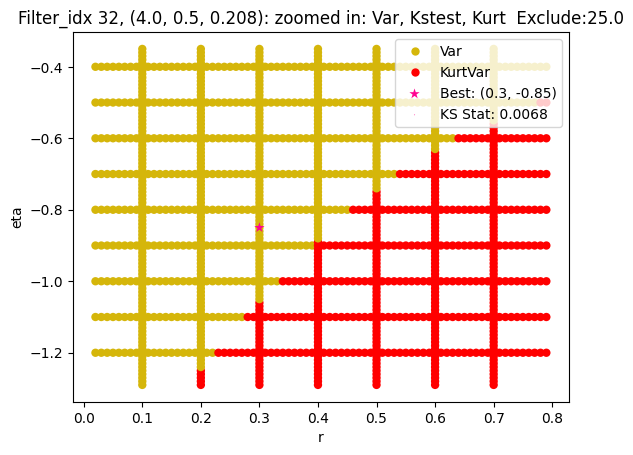

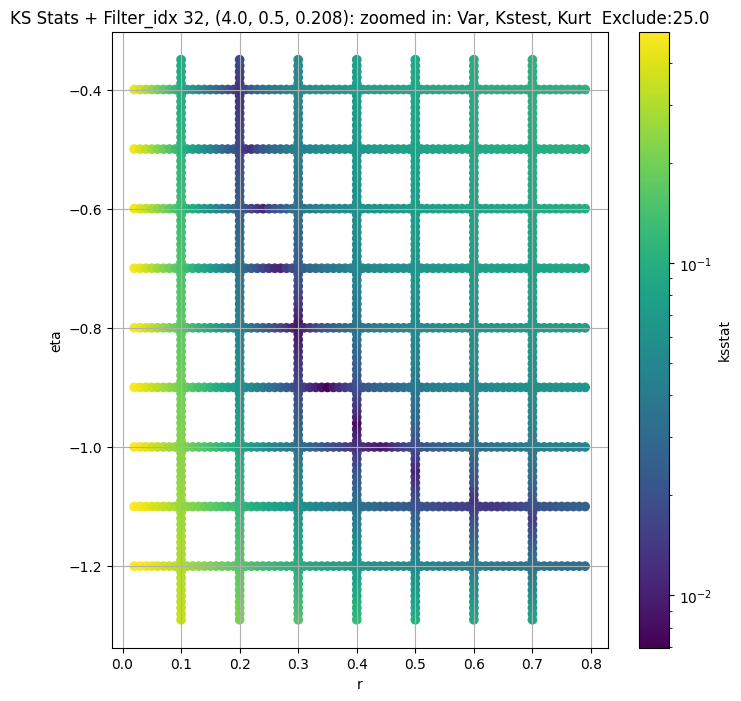

Filter_idx 33, (4.0, 0.5, 0.306):


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 33, 0.0 + 100 = 100, ksstat: 0.0070064325956415985, var: 0.822045624256134


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 33, 0.0 + 75 = 75, ksstat: 0.006411130770741513, var: 0.8491766452789307


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 33, 0.0 + 50 = 50, ksstat: 0.0052528896453000185, var: 0.8824726939201355


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 33, 0.0 + 25 = 25, ksstat: 0.004858325116915571, var: 0.9276066422462463


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 33, 0.0 + 0 = 0, ksstat: 0.005265828296690034, var: 1.0732712745666504
Number of samples: 100000, Without approximation : 160000000.0


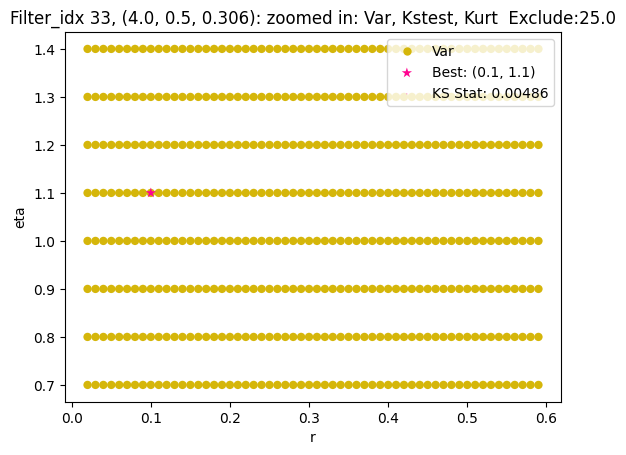

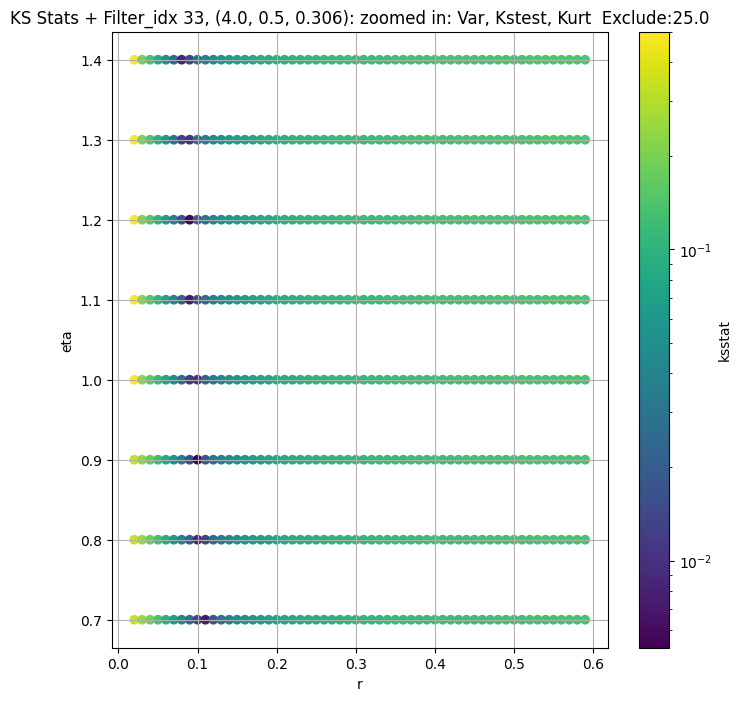

Filter_idx 34, (4.0, 0.5, 0.45):


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 34, 50.0 + 100 = 150, ksstat: 0.005116465715898744, var: 0.23449577391147614


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 34, 50.0 + 75 = 125, ksstat: 0.004567712076888171, var: 0.23973140120506287


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 34, 50.0 + 50 = 100, ksstat: 0.003949687517325495, var: 0.2456965446472168


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 34, 50.0 + 25 = 75, ksstat: 0.0034334969768605728, var: 0.2527063488960266


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 34, 50.0 + 0 = 50, ksstat: 0.002496093411085254, var: 0.26139333844184875


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 34, 50.0 + -25 = 25, ksstat: 0.00231096527649588, var: 0.27345436811447144


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 34, 50.0 + -50 = 0, ksstat: 0.004217084042709041, var: 0.3225316107273102
Number of samples: 100000, Without approximation : 160000000.0


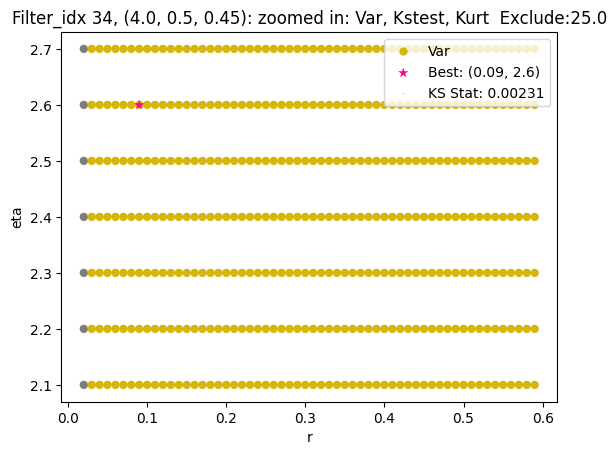

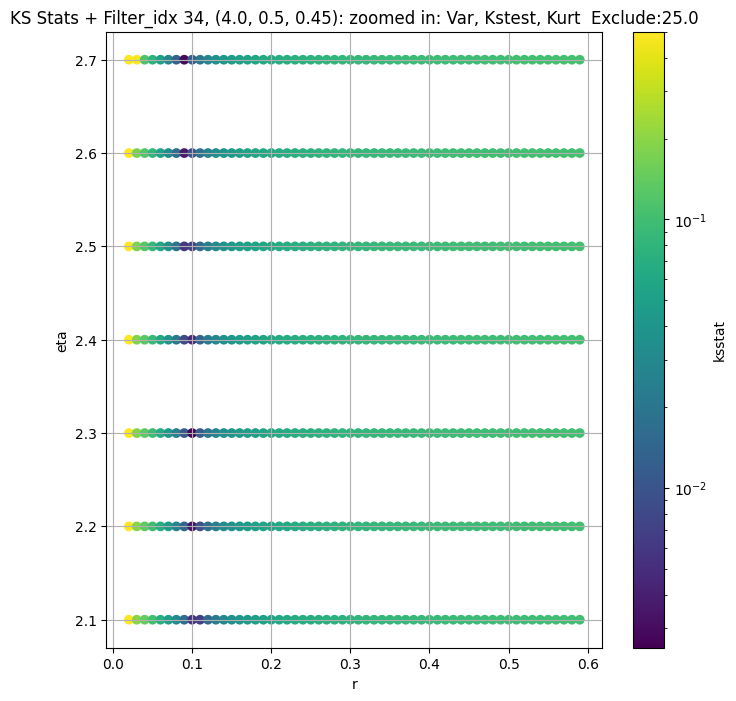

Filter_idx 35, (4.0, 1.0, 0.044):


  0%|          | 0/131 [00:00<?, ?it/s]

Finding Minimum after computing 131 CDFs
filter_idx 35, 200.0 + 100 = 300, ksstat: 0.007021434801880444, var: 113.6778793334961


  0%|          | 0/131 [00:00<?, ?it/s]

Finding Minimum after computing 131 CDFs
filter_idx 35, 200.0 + 75 = 275, ksstat: 0.00649213086800926, var: 115.05770111083984


  0%|          | 0/131 [00:00<?, ?it/s]

Finding Minimum after computing 131 CDFs
filter_idx 35, 200.0 + 50 = 250, ksstat: 0.005948440115624343, var: 116.5070571899414


  0%|          | 0/131 [00:00<?, ?it/s]

Finding Minimum after computing 131 CDFs
filter_idx 35, 200.0 + 25 = 225, ksstat: 0.0058761636644134585, var: 118.0364761352539


  0%|          | 0/131 [00:00<?, ?it/s]

Finding Minimum after computing 131 CDFs
filter_idx 35, 200.0 + 0 = 200, ksstat: 0.005857326503732274, var: 119.65863800048828


  0%|          | 0/131 [00:00<?, ?it/s]

Finding Minimum after computing 131 CDFs
filter_idx 35, 200.0 + -25 = 175, ksstat: 0.005861334853136335, var: 121.3900146484375


  0%|          | 0/131 [00:00<?, ?it/s]

Finding Minimum after computing 131 CDFs
filter_idx 35, 200.0 + -50 = 150, ksstat: 0.006103576642227937, var: 123.2532730102539


  0%|          | 0/131 [00:00<?, ?it/s]

Finding Minimum after computing 131 CDFs
filter_idx 35, 200.0 + -75 = 125, ksstat: 0.006904954464790336, var: 125.28044128417969


  0%|          | 0/131 [00:00<?, ?it/s]

Finding Minimum after computing 131 CDFs
filter_idx 35, 200.0 + -100 = 100, ksstat: 0.007387414571084272, var: 127.51908111572266
Number of samples: 100000, Without approximation : 160000000.0


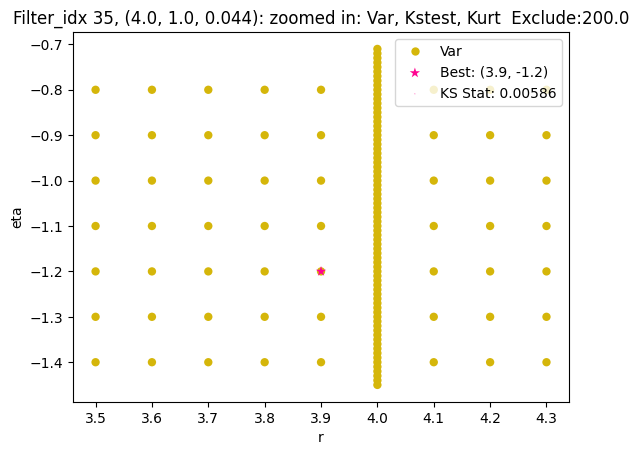

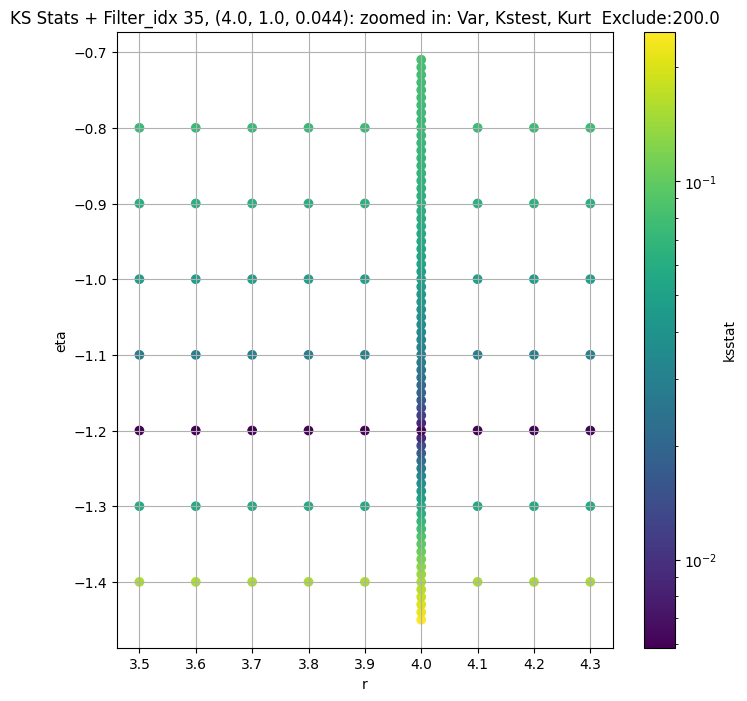

Filter_idx 36, (4.0, 1.0, 0.065):


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 36, 100.0 + 100 = 200, ksstat: 0.006989468643531116, var: 49.504859924316406


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 36, 100.0 + 75 = 175, ksstat: 0.0070001186662939086, var: 50.2662467956543


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 36, 100.0 + 50 = 150, ksstat: 0.006993187175222071, var: 51.08439254760742


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 36, 100.0 + 25 = 125, ksstat: 0.006985585163455821, var: 51.97159957885742


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 36, 100.0 + 0 = 100, ksstat: 0.006992294861518533, var: 52.947349548339844


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 36, 100.0 + -25 = 75, ksstat: 0.006997754779492771, var: 54.04313659667969


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 36, 100.0 + -50 = 50, ksstat: 0.006998125536539557, var: 55.319549560546875


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 36, 100.0 + -75 = 25, ksstat: 0.0070160494549337815, var: 56.91634750366211


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 36, 100.0 + -100 = 0, ksstat: 0.007024751209654623, var: 60.04805374145508
Number of samples: 100000, Without approximation : 160000000.0


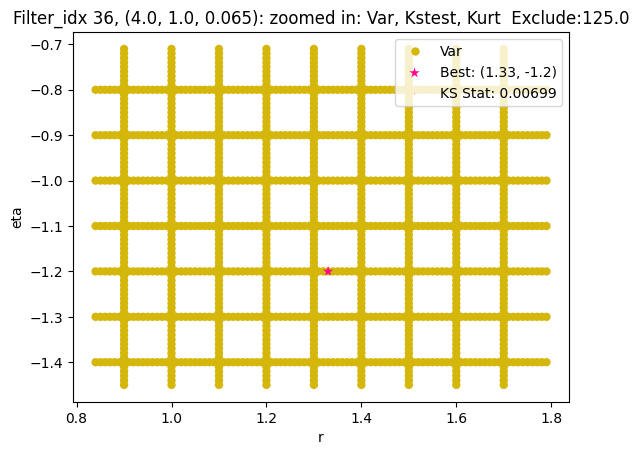

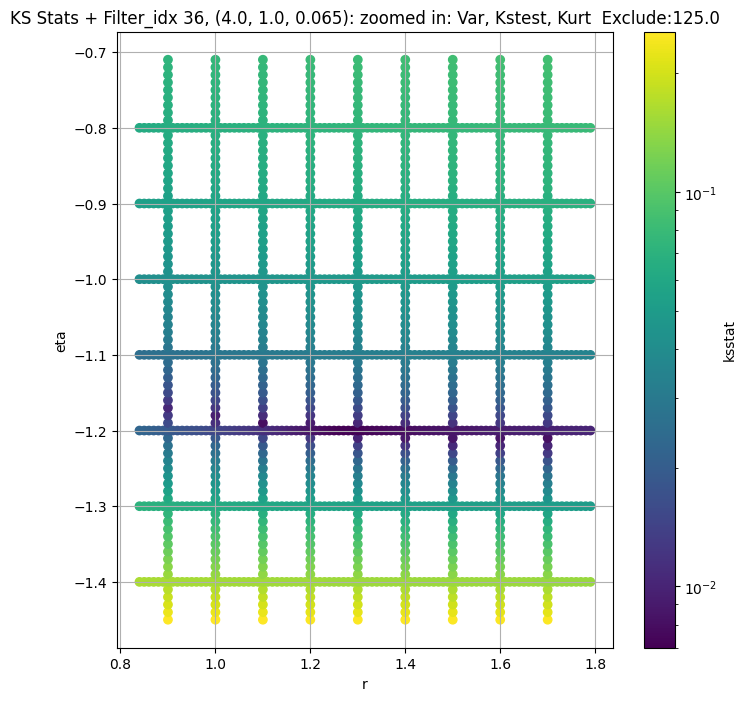

Filter_idx 37, (4.0, 1.0, 0.096):


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 37, 50.0 + 100 = 150, ksstat: 0.007939109511844789, var: 20.352933883666992


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 37, 50.0 + 75 = 125, ksstat: 0.00844752590546538, var: 20.777786254882812


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 37, 50.0 + 50 = 100, ksstat: 0.008277194098638696, var: 21.249126434326172


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 37, 50.0 + 25 = 75, ksstat: 0.008090202444333228, var: 21.783187866210938


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 37, 50.0 + 0 = 50, ksstat: 0.007879004318480876, var: 22.41133689880371


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 37, 50.0 + -25 = 25, ksstat: 0.008057359767446648, var: 23.207578659057617


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 37, 50.0 + -50 = 0, ksstat: 0.008747159106861968, var: 24.948524475097656
Number of samples: 100000, Without approximation : 160000000.0


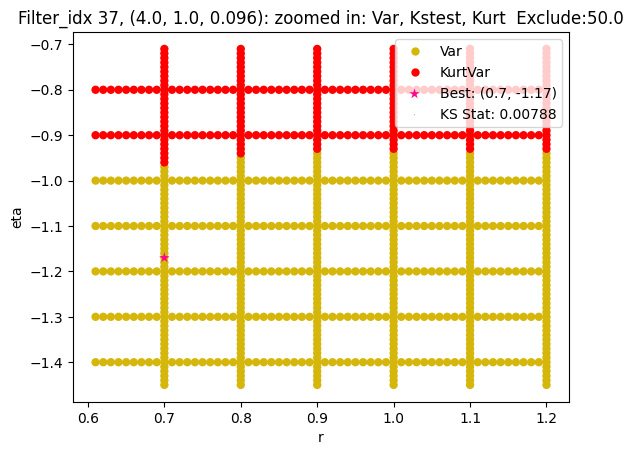

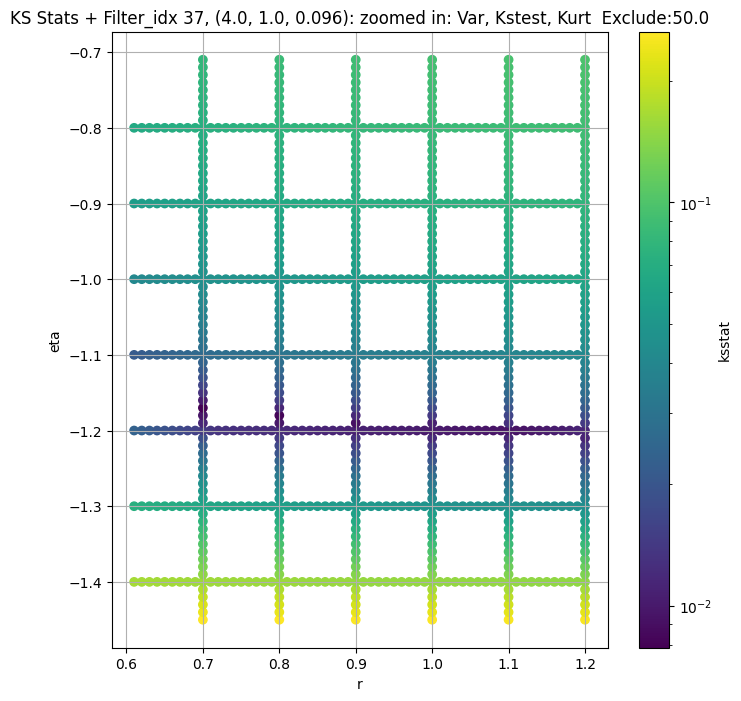

Filter_idx 38, (4.0, 1.0, 0.141):


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 38, 0.0 + 100 = 100, ksstat: 0.007268648393523647, var: 8.534440994262695


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 38, 0.0 + 75 = 75, ksstat: 0.0072852858844303925, var: 8.77890682220459


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 38, 0.0 + 50 = 50, ksstat: 0.007399212316385628, var: 9.073264122009277


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 38, 0.0 + 25 = 25, ksstat: 0.007329870606005262, var: 9.460187911987305


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 38, 0.0 + 0 = 0, ksstat: 0.007069273884817817, var: 10.362214088439941
Number of samples: 100000, Without approximation : 160000000.0


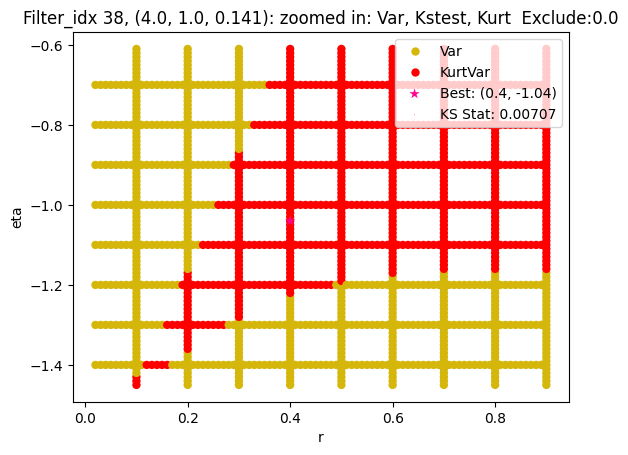

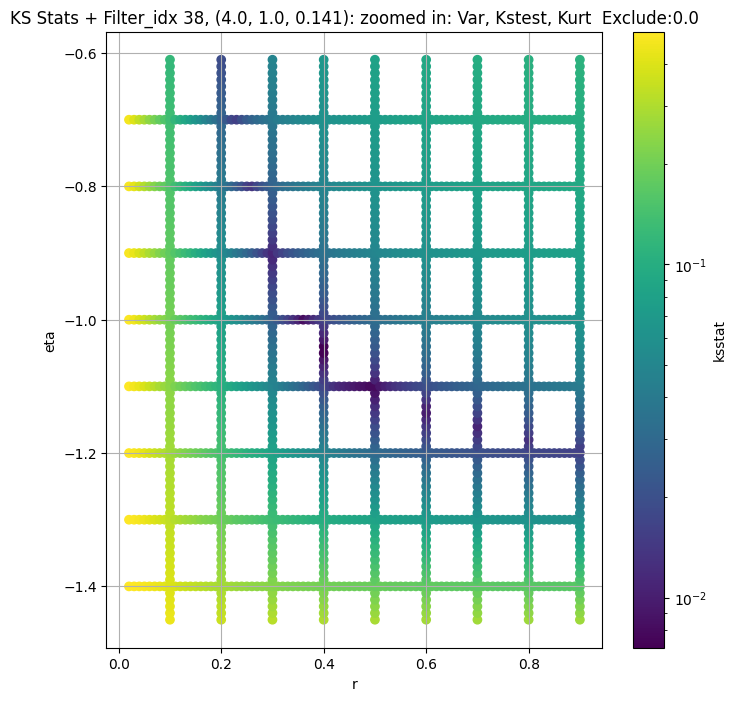

Filter_idx 39, (4.0, 1.0, 0.208):


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 39, 100.0 + 100 = 200, ksstat: 0.00884844416917463, var: 2.924422025680542


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 39, 100.0 + 75 = 175, ksstat: 0.008372164704933405, var: 2.9890334606170654


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 39, 100.0 + 50 = 150, ksstat: 0.009250745144748107, var: 3.0599422454833984


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 39, 100.0 + 25 = 125, ksstat: 0.008841830769711567, var: 3.1387882232666016


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 39, 100.0 + 0 = 100, ksstat: 0.00923796498002638, var: 3.228116750717163


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 39, 100.0 + -25 = 75, ksstat: 0.007865557784915517, var: 3.3321409225463867


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 39, 100.0 + -50 = 50, ksstat: 0.007814040256585608, var: 3.458770751953125


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 39, 100.0 + -75 = 25, ksstat: 0.007399903622259396, var: 3.627706289291382


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 39, 100.0 + -100 = 0, ksstat: 0.0075411683943645835, var: 4.0852532386779785
Number of samples: 100000, Without approximation : 160000000.0


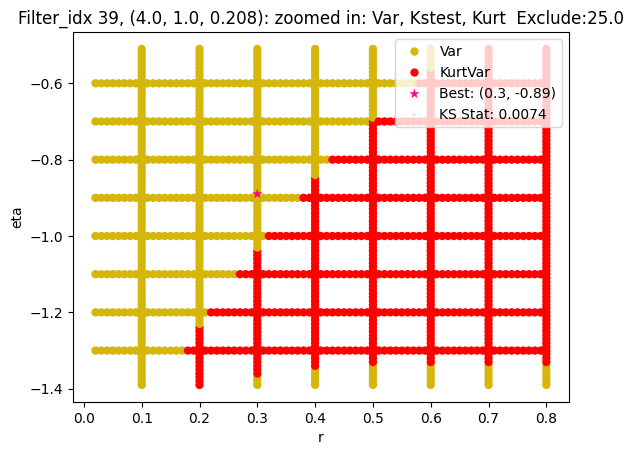

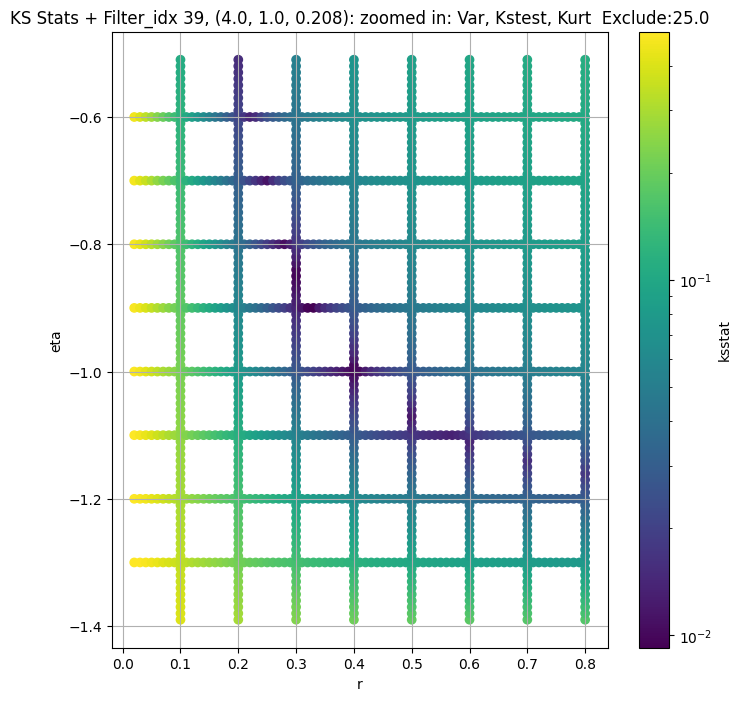

Filter_idx 40, (4.0, 1.0, 0.306):


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 40, 0.0 + 100 = 100, ksstat: 0.006266184228522986, var: 1.0240422487258911


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 40, 0.0 + 75 = 75, ksstat: 0.005981660621932172, var: 1.0590438842773438


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 40, 0.0 + 50 = 50, ksstat: 0.005846941494004443, var: 1.102095365524292


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 40, 0.0 + 25 = 25, ksstat: 0.004142297778032766, var: 1.160443902015686


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 40, 0.0 + 0 = 0, ksstat: 0.004255925070790312, var: 1.3246606588363647
Number of samples: 100000, Without approximation : 160000000.0


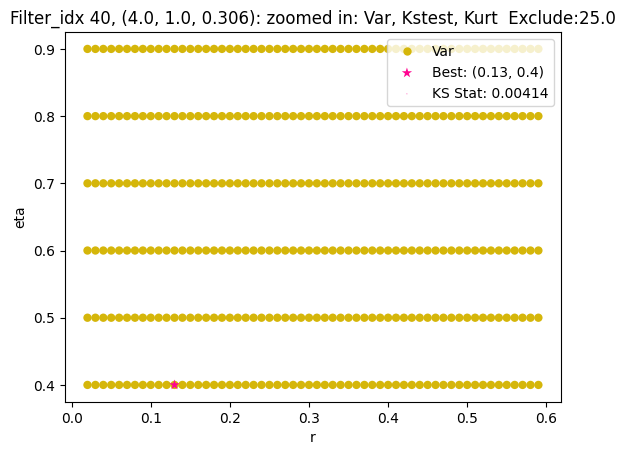

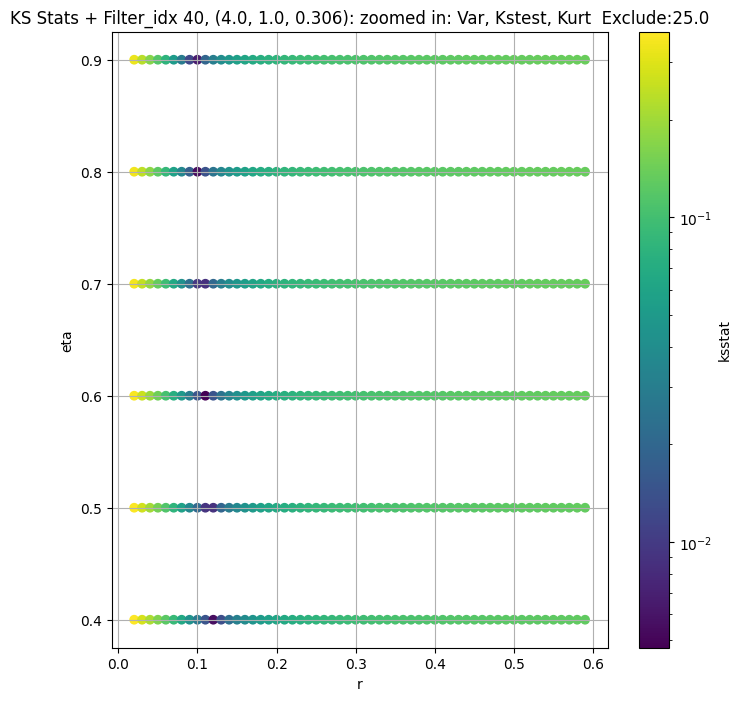

Filter_idx 41, (4.0, 1.0, 0.45):


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 41, 50.0 + 100 = 150, ksstat: 0.005198304847563784, var: 0.28164634108543396


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 41, 50.0 + 75 = 125, ksstat: 0.004507752053579339, var: 0.28840672969818115


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 41, 50.0 + 50 = 100, ksstat: 0.003729820544947776, var: 0.29614749550819397


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 41, 50.0 + 25 = 75, ksstat: 0.0031347249885440576, var: 0.30529770255088806


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 41, 50.0 + 0 = 50, ksstat: 0.002491199991633032, var: 0.3166896104812622


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 41, 50.0 + -25 = 25, ksstat: 0.002607251485280404, var: 0.3325444459915161


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 41, 50.0 + -50 = 0, ksstat: 0.004447019713992473, var: 0.3925109803676605
Number of samples: 100000, Without approximation : 160000000.0


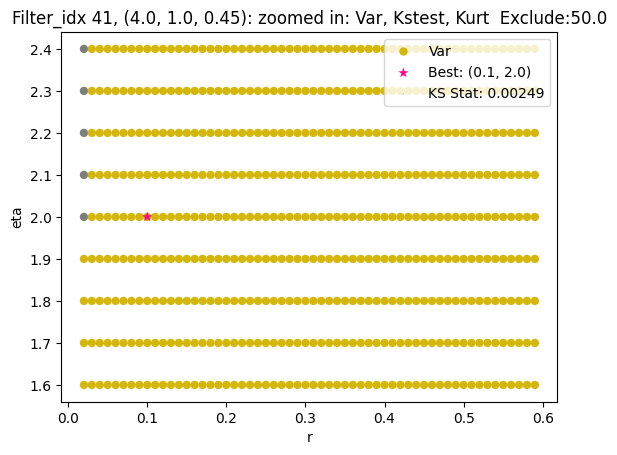

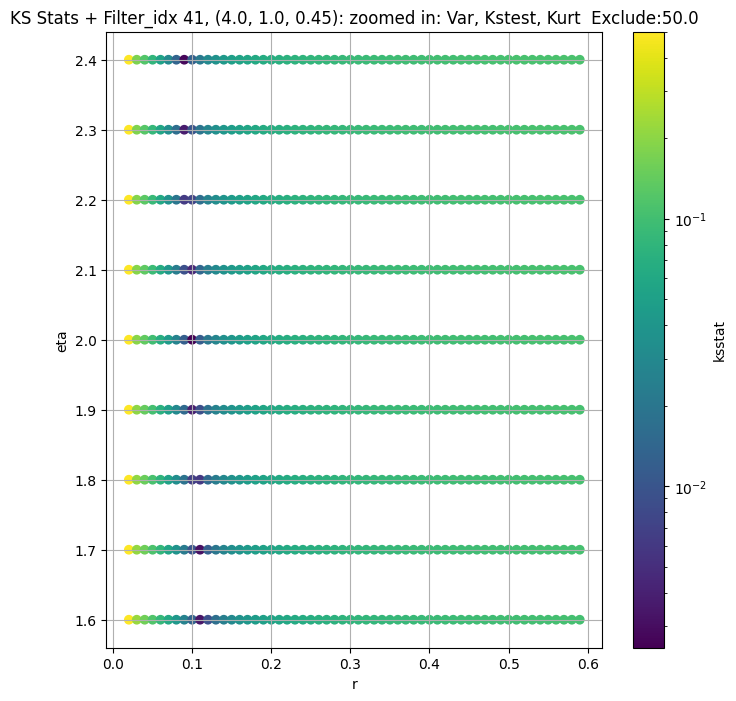

,params,obs_var,var_lower,var_upper,obs_kurt,kurt_lower,kurt_upper,total_samples,filter_group,kstest_stat_initial,...,initial_scale,initial_exclude_cutoff,best_augmented_var,kstest_stat_cutoff_0.05,kstest_stat_best,best_r,best_eta,best_scale,best_exclude_cutoff,n_pval_0.05
filter_idx,,,,,,,,,,,,,,,,,,,,,
0,"(2.0, 0.5, 0.044)",137.924240,103.933060,192.941470,10.131069,3.520477,63.653420,160000000.0,"(2.0, 0.5, 0.044)",0.011901,...,6.132156e+02,0.0,137.924240,0.000107,0.011901,20.00,-1.20,6.132156e+02,0.0,12357
1,"(2.0, 0.5, 0.065)",53.987360,40.135403,79.578384,16.350359,4.161812,131.825700,160000000.0,"(2.0, 0.5, 0.065)",0.008258,...,2.158856e+02,50.0,53.987358,0.000107,0.008040,1.42,-1.20,2.213887e+02,0.0,29296
2,"(2.0, 0.5, 0.096)",25.048847,18.085354,38.104233,21.830307,5.088109,153.020650,160000000.0,"(2.0, 0.5, 0.096)",0.008892,...,9.099460e+01,200.0,19.512074,0.000107,0.008849,2.40,-1.20,8.964052e+01,250.0,24718
3,"(2.0, 0.5, 0.141)",9.881065,6.770121,17.732750,29.032230,6.329034,168.213910,160000000.0,"(2.0, 0.5, 0.141)",0.008408,...,6.861851e+00,0.0,9.151770,0.000107,0.007623,0.51,-1.10,6.754604e+00,25.0,32958
4,"(2.0, 0.5, 0.208)",3.735418,2.428868,7.642767,42.469220,7.384008,291.323900,160000000.0,"(2.0, 0.5, 0.208)",0.008497,...,5.651842e-02,50.0,3.735418,0.000107,0.006070,0.30,-0.85,7.724063e-02,0.0,49437
5,"(2.0, 0.5, 0.306)",1.113347,0.712703,2.480918,55.986454,6.268856,333.466580,160000000.0,"(2.0, 0.5, 0.306)",0.005150,...,1.671259e-15,0.0,1.113347,0.000107,0.004792,0.11,0.80,2.328358e-13,0.0,78125
6,"(2.0, 0.5, 0.45)",0.716896,0.469471,1.796280,62.759920,6.502224,366.028630,160000000.0,"(2.0, 0.5, 0.45)",0.002688,...,5.671552e-16,0.0,0.716896,0.000107,0.002688,0.10,1.30,5.671552e-16,0.0,263671
7,"(2.0, 1.0, 0.044)",182.940160,139.642330,257.175230,11.653064,3.985817,86.649550,160000000.0,"(2.0, 1.0, 0.044)",0.007813,...,7.876375e+02,50.0,170.917420,0.000107,0.007813,6.30,-1.20,7.876375e+02,50.0,29296
8,"(2.0, 1.0, 0.065)",73.881040,54.992100,108.218670,12.884755,4.084681,82.376310,160000000.0,"(2.0, 1.0, 0.065)",0.007246,...,3.057241e+02,50.0,73.881042,0.000107,0.007098,1.56,-1.20,3.132051e+02,0.0,37077


In [14]:
master_df_optimized_path = Path(os.path.join(CWD, "CSVs", 'master_df_optimized.csv'))

NUM_ITERS = dict(zip(GROUPS, [1]*len(GROUPS))) # By default, does one iteration per group
NUM_SAMPLES_OPTIMIZE = 2000
EXCLUDE_CUTOFFS_OPTIMIZE = np.arange(100, -101, -25)

if RERUN or not master_df_optimized_path.exists():

    if SKIP_OPTIMIZE_STEP:

        master_df['kstest_stat_best'] = master_df['kstest_stat_initial']
        master_df[f'best_r'] = master_df['initial_r']
        master_df[f'best_eta'] = master_df['initial_eta']
        master_df[f'best_scale'] = master_df['initial_scale']
        master_df[f'best_exclude_cutoff'] = master_df['initial_exclude_cutoff']

    else:
        for group in GROUPS: # TODO For quick testing purposes
            print(f"{GROUP.capitalize()} {group}, {str(filter_group_map[group])}:")
            master_df.loc[group, 'kstest_stat_best'] = master_df.loc[group, 'kstest_stat_initial']
            master_df.loc[group, 'best_r'] = master_df.loc[group, 'initial_r']
            master_df.loc[group, 'best_eta'] = master_df.loc[group, 'initial_eta']
            master_df.loc[group, 'best_scale'] = master_df.loc[group, 'initial_scale']

            sample = group_data_map[group]
            if len(sample) == 0:
                continue
            initial_r, initial_eta = master_df.loc[group, 'initial_r'], master_df.loc[group, f'initial_eta']
            eps = 0.5
            group_cdfs_df = fine_cdfs_df[(np.abs(master_df.loc[group, 'initial_r'] - fine_cdfs_df['r']) < eps) & 
                                        (np.abs(master_df.loc[group, 'initial_eta'] - fine_cdfs_df['eta']) < eps)].reset_index(drop=True)
            group_cdfs = {x[0]:x[1] for x in group_cdfs_df['(r,eta),cdf']}

            for adjust_exclude_cutoff in EXCLUDE_CUTOFFS_OPTIMIZE: # -50, -25, 0, 25, 50
                
                exclude_cutoff = int(max(0, adjust_exclude_cutoff + master_df.loc[group, 'initial_exclude_cutoff']))
                
                if exclude_cutoff == 0:
                    augmented_var = np.var(group_data_map[group])
                else:
                    augmented_var = np.var(group_data_map[group][exclude_cutoff:-exclude_cutoff])                       

                group_cdfs_df['scale'] = np.clip((augmented_var / group_cdfs_df['variance']), 0,  SCALE_CAP)
                ksstats, initial_param, min_stat = gridsearch(sample, group_cdfs, debug=True, scales=group_cdfs_df['scale'])
                
                cutoff_label = generate_cutoff_label(adjust_exclude_cutoff)

                augmented_var_df.loc[group, f"kstest_stat_{cutoff_label}"] = min_stat
                group_cdfs_df[f'ksstat_exclude_{cutoff_label}'] = ksstats
                
                print(f"{GROUP} {group}, {master_df.loc[group, 'initial_exclude_cutoff']} + {adjust_exclude_cutoff} = {exclude_cutoff}, ksstat: {min_stat}, var: {augmented_var}")
                best_adjust = 0

                if min_stat < master_df.loc[group, 'kstest_stat_best']:

                    inital_min_stat = min_stat
                    inital_best_param = initial_param
                    master_df.loc[group, 'kstest_stat_best'] = min_stat
                    initial_scale = group_cdfs_df.loc[(group_cdfs_df["r"] ==  initial_param[0]) & (group_cdfs_df["eta"] ==  initial_param[1])]["scale"].iloc[0]
                    master_df.loc[group, 'best_r'], master_df.loc[group, 'best_eta'] = initial_param
                    master_df.loc[group, 'best_scale'] = initial_scale
                    master_df.loc[group, 'best_exclude_cutoff'] = exclude_cutoff
                    master_df.loc[group, 'best_augmented_var'] = augmented_var
                    augmented_var_df.loc[group, 'best_augmented_var'] = augmented_var
                    best_adjust = adjust_exclude_cutoff

                if exclude_cutoff == 0:
                    break

            cutoff_label = generate_cutoff_label(best_adjust)
            ksstats = group_cdfs_df[f"ksstat_exclude_{cutoff_label}"]
            
            print(f"Number of samples: {sample.size}, Without approximation : {master_df.loc[group, 'total_samples']}")
            
            cutoff = stats.kstwo(n=master_df.loc[group, 'total_samples']).isf(0.05)
            master_df.loc[group, 'kstest_stat_cutoff_0.05'] = cutoff

            best_scales = np.clip((master_df.loc[group, 'best_augmented_var'] / group_cdfs_df['variance']), 0,  SCALE_CAP)

            group_cdfs_df['variance'] = group_cdfs_df['variance'] * best_scales
            group_cdfs_df['kurtosis'] = group_cdfs_df['kurtosis'] * best_scales

            group_cdfs_df = add_tests_to_df(cdfs_df = group_cdfs_df, group = group, var_kurt_df = master_df, ksstats = ksstats).sort_values(['r', 'eta'])

            group_dict = rEtaKsstats_dict[group]
            group_dict.update({'r_optimize' : group_cdfs_df['r'], 'eta_optimize' : group_cdfs_df['eta'], f'ksstat_exclude_{cutoff_label}' : ksstats})
            rEtaKsstats_dict[group] = group_dict

            cols = ['pass_var', 'pass_kstest', 'pass_kurt']
            fig = combo_test_plot(group_cdfs_df, cols, 
                                plot_name=f"{GROUP.capitalize()} {group}, {str(filter_group_map[group])}: zoomed in: {', '.join([col[5:].capitalize() for col in cols])}  Exclude:{master_df.loc[group, 'best_exclude_cutoff']}",
                                best_param=(master_df.loc[group, 'best_r'], master_df.loc[group, f'best_eta']),
                                best_ksstat=master_df.loc[group, 'kstest_stat_best'])
            fig.figure.savefig(os.path.join(CWD, "plots", f"optimized_full_grid_search_combo_plot_layer{group}.jpg"), bbox_inches = 'tight', dpi=100)
            
    master_df['n_pval_0.05'] = master_df.apply(lambda row : find_n_fixed_pval_stat(row.loc['kstest_stat_best'], row.loc['total_samples']), axis = 1)    
    master_df[['total_samples', 'initial_r', 'initial_eta', 'kstest_stat_initial', 'initial_exclude_cutoff', 'best_r', 'best_eta', 'best_scale', 'kstest_stat_best', 'best_exclude_cutoff', 'n_pval_0.05']].to_csv(os.path.join(CWD, "CSVs", 'optimized_params.csv'))
    master_df.to_csv(os.path.join(CWD, "CSVs", 'master_df_optimized.csv'))
    augmented_var_df.to_csv(augmented_var_df_path)
    pd.to_pickle(rEtaKsstats_dict, rEtaKsstats_dict_path)

rEtaKsstats_dict = pd.read_pickle(rEtaKsstats_dict_path)
master_df = pd.read_csv(master_df_optimized_path, index_col = GROUP)
augmented_var_df = pd.read_csv(augmented_var_df_path, index_col = GROUP)
master_df

## Comparing Empirical and Computed CDF/PDF

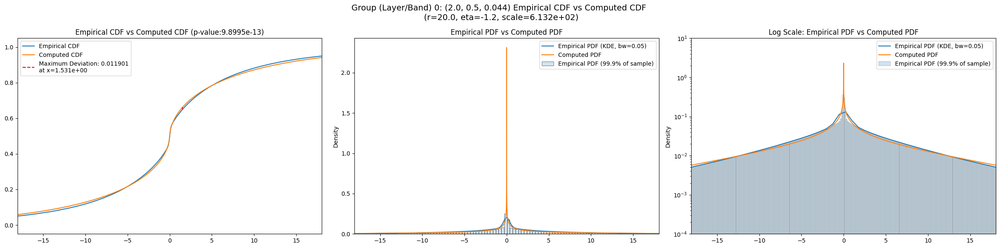

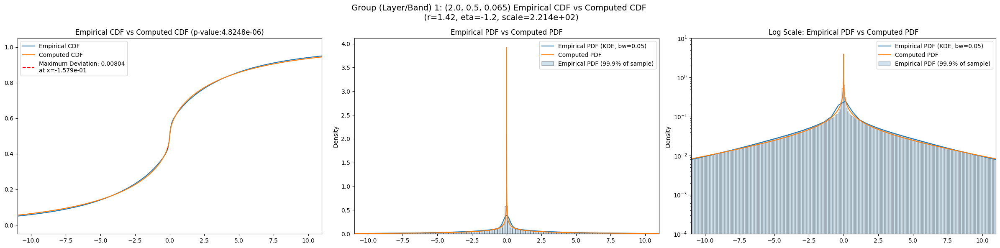

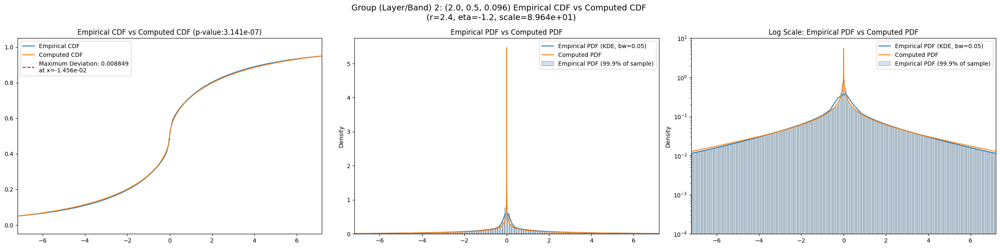

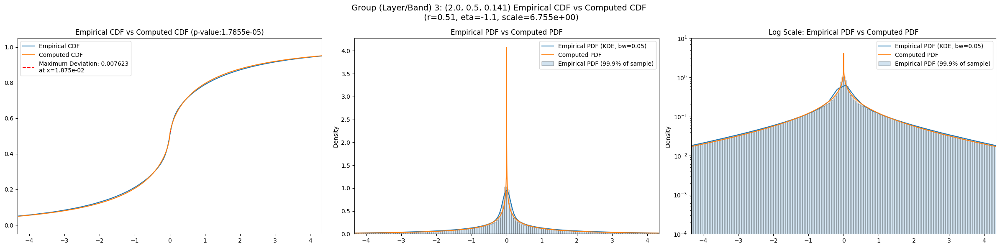

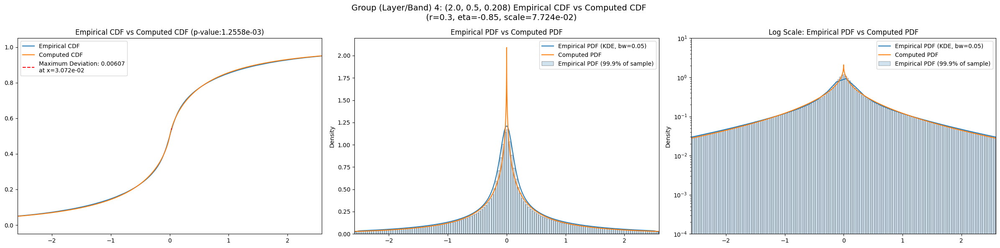

...

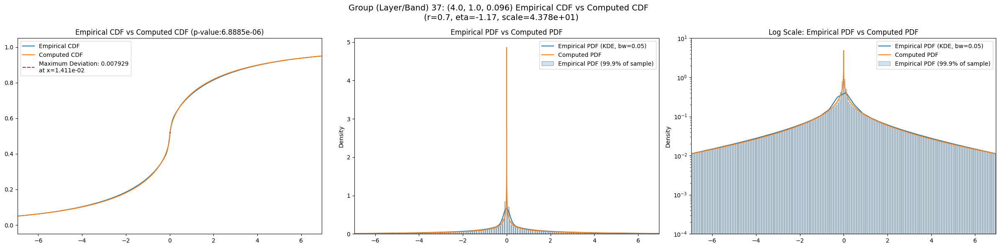

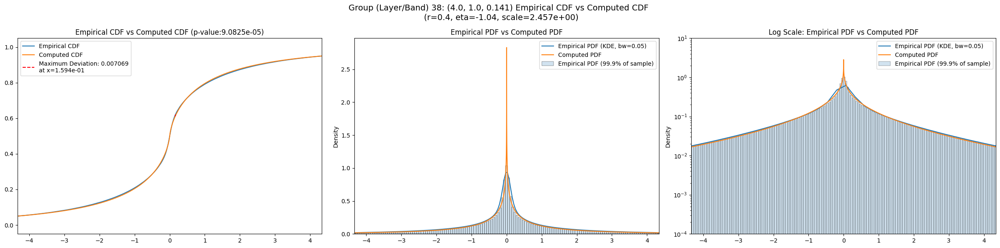

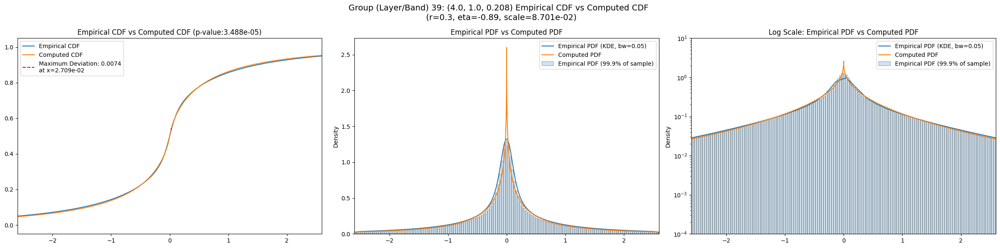

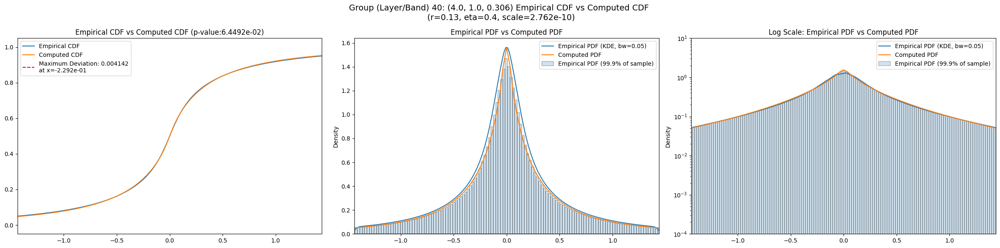

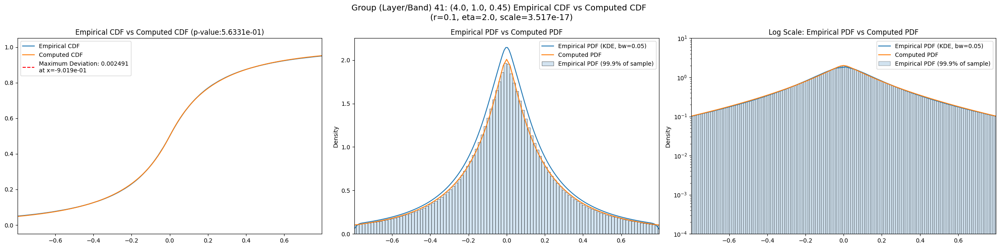

In [15]:
for group in GROUPS:
    group_info = master_df.loc[group]
    best_r = group_info['best_r']
    best_eta = group_info['best_eta']
    best_scale = group_info['best_scale']
    fig = visualize_cdf_pdf(sample = group_data_map[group], 
                    params = (best_r, best_eta, best_scale), 
                    log_scale = True,
                    group = f"{group}: {filter_group_map[group]}")
    fig.savefig(os.path.join(CWD, "plots", f'compare_cdf_pdf_layer_{group}.jpg'), bbox_inches = 'tight', dpi = 100)

## Comparing with Gaussian and Laplace Priors

In [16]:
def generate_func(sample, distro, *args, n_samples=200):
    if distro == 'gaussian' or distro == 'normal':
        def var_func(var):
            cdf = scipy.stats.norm(scale=var).cdf
            return compute_ksstat(sample, cdf)
        return var_func
    elif distro == 'laplace':
        def var_func(var):
            cdf = scipy.stats.laplace(scale=var).cdf
            return compute_ksstat(sample, cdf)
        return var_func
    elif distro == 't':
        def var_func(var):
            cdf = scipy.stats.t(df=2, scale=var).cdf
            return compute_ksstat(sample, cdf)
        return var_func
    elif distro == 'prior_r':
        eta = args[0]
        def r_func(r):
            cdf = compute_prior_cdf(r, eta, n_samples=n_samples)
            return compute_ksstat(sample, cdf)
        return r_func
    elif distro == 'prior_eta':
        r = args[0]
        def eta_func(eta):
            cdf = compute_prior_cdf(r, eta, n_samples=n_samples)
            return compute_ksstat(sample, cdf)
        return eta_func
    elif distro == 'prior':
        def r_eta_func(params):
            r = params[0]
            eta = params[1]
            cdf = compute_prior_cdf(r, eta, n_samples=n_samples, debug=False)
            return compute_ksstat(sample, cdf)
        return r_eta_func
    elif distro == 'prior_with_scale':
        def r_eta_scale_func(params):
            r = params[0]
            eta = params[1]
            scale = params[2]
            print(r, eta, scale)
            cdf = compute_prior_cdf(r = r, eta = eta, n_samples=n_samples, debug=False)
            return compute_ksstat(sample/ np.sqrt(scale), cdf)
        return r_eta_scale_func

    print("Please enter a valid argument for `distro`: 'gaussian', 'laplace', 'prior_r', 'prior_eta', 'prior','prior_with_scale', 't'")

In [17]:
master_df_path = Path(os.path.join(CWD, "CSVs", 'master_df.csv'))

if RERUN or not master_df_path.exists():
    upper_bound = int(1e6)
    for group in GROUPS:
        if len(group_data_map[group]) == 0:
            continue
        norm_result = scipy.optimize.minimize_scalar(generate_func(group_data_map[group], 'gaussian'), method = 'bounded', bounds = (0, upper_bound))
        laplace_result = scipy.optimize.minimize_scalar(generate_func(group_data_map[group], 'laplace'), method = 'bounded', bounds = (0, upper_bound))
        t_result = scipy.optimize.minimize_scalar(generate_func(group_data_map[group], 't'), method = 'bounded', bounds = (0, upper_bound))
        
        master_df.loc[group, 'param_gaussian'] = round_to_sigfigs(norm_result['x'], 6)
        master_df.loc[group, 'kstest_stat_gaussian'] = round_to_sigfigs(norm_result['fun'], 6)
        master_df.loc[group, 'kstest_pval_gaussian'] = round_to_sigfigs(stats.kstwo(n=master_df.loc[group, 'total_samples']).sf(master_df.loc[group, 'kstest_stat_gaussian']), 6)

        master_df.loc[group, 'param_laplace'] = round_to_sigfigs(laplace_result['x'], 6)
        master_df.loc[group, 'kstest_stat_laplace'] = round_to_sigfigs(laplace_result['fun'], 6)
        master_df.loc[group, 'kstest_pval_laplace'] = round_to_sigfigs(stats.kstwo(n=master_df.loc[group, 'total_samples']).sf(master_df.loc[group, 'kstest_stat_laplace']), 6)

        master_df.loc[group, 'param_laplace'] = round_to_sigfigs(laplace_result['x'], 6)
        master_df.loc[group, 'kstest_stat_laplace'] = round_to_sigfigs(laplace_result['fun'], 6)
        master_df.loc[group, 'kstest_pval_laplace'] = round_to_sigfigs(stats.kstwo(n=master_df.loc[group, 'total_samples']).sf(master_df.loc[group, 'kstest_stat_laplace']), 6) 

        master_df.loc[group, 'param_t'] = round_to_sigfigs(t_result['x'], 6)
        master_df.loc[group, 'kstest_stat_t'] = round_to_sigfigs(t_result['fun'], 6)
        master_df.loc[group, 'kstest_pval_t'] = round_to_sigfigs(stats.kstwo(n=master_df.loc[group, 'total_samples']).sf(master_df.loc[group, 'kstest_stat_t']), 6) 

        master_df.loc[group, 'kstest_pval_gengamma'] = round_to_sigfigs(stats.kstwo(n=master_df.loc[group, 'total_samples']).sf(master_df.loc[group, 'kstest_stat_best']))

    master_df.to_csv(os.path.join(CWD, "CSVs", 'master_df.csv'))
    
master_df = pd.read_csv(os.path.join(CWD, "CSVs", 'master_df.csv'), index_col = GROUP)
master_df

,params,obs_var,var_lower,var_upper,obs_kurt,kurt_lower,kurt_upper,total_samples,filter_group,kstest_stat_initial,...,param_gaussian,kstest_stat_gaussian,kstest_pval_gaussian,param_laplace,kstest_stat_laplace,kstest_pval_laplace,param_t,kstest_stat_t,kstest_pval_t,kstest_pval_gengamma
filter_idx,,,,,,,,,,,,,,,,,,,,,
0,"(2.0, 0.5, 0.044)",137.924240,103.933060,192.941470,10.131069,3.520477,63.653420,160000000.0,"(2.0, 0.5, 0.044)",0.011901,...,6.645730,0.059959,0.0,5.370360,0.041537,0.0,4.380200,0.045145,0.0,0.0
1,"(2.0, 0.5, 0.065)",53.987360,40.135403,79.578384,16.350359,4.161812,131.825700,160000000.0,"(2.0, 0.5, 0.065)",0.008258,...,3.661760,0.069600,0.0,2.941110,0.051832,0.0,2.379930,0.055556,0.0,0.0
2,"(2.0, 0.5, 0.096)",25.048847,18.085354,38.104233,21.830307,5.088109,153.020650,160000000.0,"(2.0, 0.5, 0.096)",0.008892,...,2.257880,0.073786,0.0,1.845510,0.053493,0.0,1.473310,0.057119,0.0,0.0
3,"(2.0, 0.5, 0.141)",9.881065,6.770121,17.732750,29.032230,6.329034,168.213910,160000000.0,"(2.0, 0.5, 0.141)",0.008408,...,1.290390,0.076982,0.0,1.085270,0.053367,0.0,0.856953,0.056337,0.0,0.0
4,"(2.0, 0.5, 0.208)",3.735418,2.428868,7.642767,42.469220,7.384008,291.323900,160000000.0,"(2.0, 0.5, 0.208)",0.008497,...,0.807416,0.070877,0.0,0.699918,0.044325,0.0,0.552785,0.045781,0.0,0.0
5,"(2.0, 0.5, 0.306)",1.113347,0.712703,2.480918,55.986454,6.268856,333.466580,160000000.0,"(2.0, 0.5, 0.306)",0.005150,...,0.496702,0.058296,0.0,0.436516,0.030968,0.0,0.346994,0.030599,0.0,0.0
6,"(2.0, 0.5, 0.45)",0.716896,0.469471,1.796280,62.759920,6.502224,366.028630,160000000.0,"(2.0, 0.5, 0.45)",0.002688,...,0.422977,0.053804,0.0,0.372178,0.026508,0.0,0.296247,0.025901,0.0,0.0
7,"(2.0, 1.0, 0.044)",182.940160,139.642330,257.175230,11.653064,3.985817,86.649550,160000000.0,"(2.0, 1.0, 0.044)",0.007813,...,7.278490,0.063854,0.0,5.861570,0.045680,0.0,4.757460,0.049118,0.0,0.0
8,"(2.0, 1.0, 0.065)",73.881040,54.992100,108.218670,12.884755,4.084681,82.376310,160000000.0,"(2.0, 1.0, 0.065)",0.007246,...,4.356960,0.067936,0.0,3.510710,0.049402,0.0,2.825710,0.052872,0.0,0.0


## Results

In [18]:
import pandas as pd
import os
master_df = pd.read_csv(os.path.join(os.getcwd(), "CSVs", 'master_df.csv'), index_col = 0)

In [19]:
master_df.filter(regex="kstest_stat.*")

,kstest_stat_initial,kstest_stat_cutoff_0.05,kstest_stat_best,kstest_stat_gaussian,kstest_stat_laplace,kstest_stat_t
filter_idx,,,,,,
0,0.011901,0.000107,0.011901,0.059959,0.041537,0.045145
1,0.008258,0.000107,0.008040,0.069600,0.051832,0.055556
2,0.008892,0.000107,0.008849,0.073786,0.053493,0.057119
3,0.008408,0.000107,0.007623,0.076982,0.053367,0.056337
4,0.008497,0.000107,0.006070,0.070877,0.044325,0.045781
5,0.005150,0.000107,0.004792,0.058296,0.030968,0.030599
6,0.002688,0.000107,0.002688,0.053804,0.026508,0.025901
7,0.007813,0.000107,0.007813,0.063854,0.045680,0.049118
8,0.007246,0.000107,0.007098,0.067936,0.049402,0.052872


In [20]:
master_df.filter(regex="best.*")

,best_augmented_var,kstest_stat_best,best_r,best_eta,best_scale,best_exclude_cutoff
filter_idx,,,,,,
0,137.924240,0.011901,20.00,-1.20,6.132156e+02,0.0
1,53.987358,0.008040,1.42,-1.20,2.213887e+02,0.0
2,19.512074,0.008849,2.40,-1.20,8.964052e+01,250.0
3,9.151770,0.007623,0.51,-1.10,6.754604e+00,25.0
4,3.735418,0.006070,0.30,-0.85,7.724063e-02,0.0
5,1.113347,0.004792,0.11,0.80,2.328358e-13,0.0
6,0.716896,0.002688,0.10,1.30,5.671552e-16,0.0
7,170.917420,0.007813,6.30,-1.20,7.876375e+02,50.0
8,73.881042,0.007098,1.56,-1.20,3.132051e+02,0.0
